<a href="https://colab.research.google.com/github/grizzler88/Springboard/blob/master/Capstone%20-%20Fantasy%20Draft%20Strategy/FantasyNFL_Capstone_EDA_(Updated_v3).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Capstone 1: Fantasy NFL (EDA)

The aim of this project is to understand what factors impact on the amount of fantasy points an NFL player will score in week.

In a previous notebook, we wrangled the original dataset into a clean version that we will import now. Following this, we will investigate and analyse the data to see if we can uncover any trends or corrleations that might indicate what factors we think can help answer our question of what indicates a good fantasy performance.  

## Getting Started

### Import packages & load dataset

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
import scipy.stats

In [2]:
file = 'NFL_FantasyData_2015_2019.csv'
nfl = pd.read_csv(file, index_col=0)

### Review Dataset

Review and refamiliarise with the shape, columns and statistics included in the data.

In [3]:
nfl.head()

,POS,TEAM,HC,OC,DC,H/A,OPP,OPP HC,OPP OC,OPP DC,DATE,SEASON,WEEK,MONTH,DAY,TIME,ROOF,SURFACE,W/L,PASSCOMP,PASSATT,PASSCOMP%,PASSYDS,PASSTD,INT,QBRAT,SACK,SACKYDS,RUSHATT,RUSHYDS,RUSHTD,TGTS,REC,RECYDS,RECTD,FUM,FUMLST,POS_AGG,PLAYER_NAME,PTS_FOR,PTS_AGT,FAN_PASSYDS,FAN_PASSTD,FAN_PASSYDS_300,FAN_PASSYDS_400,FAN_INT,FAN_SACK,FAN_PASS_TOT,FAN_RUSHYDS,FAN_RUSHTD,FAN_RUSHYDS_100,FAN_RUSHYDS_200,FAN_FUMLST,FAN_RUSH_TOT,FAN_RECYDS,FAN_RECTD,FAN_RECYDS_100,FAN_RECYDS_200,FAN_REC_TOT,FAN_TOT
0,QB,Packers,Joe Philbin,Joe Philbin,Mike Pettine,Home,Lions,Matt Patricia,Jim Bob Cooter,Paul Pasqualoni,2018-12-30,2018,Week17,December,Sunday,Noon,Open,Grass,L,3,5,0.6,26,0,0,73.7,1,12,0,0,0,0,0,0,0,0,0,QB,Aaron Rodgers,0,31,1.04,0,0,0,0,-0.5,0.54,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0.54
1,WR,Buccaneers,Dirk Koetter,Todd Monken,Mark Duffner,Home,Falcons,Dan Quinn,Steve Sarkisian,Marquand Manuel,2018-12-30,2018,Week17,December,Sunday,Noon,Open,Grass,L,0,0,0.0,0,0,0,0.0,0,0,0,0,0,6,5,66,0,0,0,WR,Adam Humphries,32,34,0.00,0,0,0,0,-0.0,0.00,0.0,0,0,0,0,0.0,6.6,0,0,0,6.6,6.60
2,WR,Vikings,Mike Zimmer,Kevin Stefanski,George Edwards,Home,Bears,Matt Nagy,Mark Helfrich,Vic Fangio,2018-12-30,2018,Week17,December,Sunday,Afternoon,Dome,Turf,L,0,0,0.0,0,0,0,0.0,0,0,1,-1,0,4,3,38,0,0,0,WR,Adam Thielen,10,24,0.00,0,0,0,0,-0.0,0.00,-0.1,0,0,0,0,-0.1,3.8,0,0,0,3.8,3.70
3,RB,Redskins,Jay Gruden,Matt Cavanaugh,Greg Manusky,Home,Eagles,Doug Pederson,Mike Groh,Jim Schwartz,2018-12-30,2018,Week17,December,Sunday,Afternoon,Open,Grass,L,0,0,0.0,0,0,0,0.0,0,0,4,0,0,0,0,0,0,0,0,RB,Adrian Peterson,0,24,0.00,0,0,0,0,-0.0,0.00,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0.00
4,FB,Panthers,Ron Rivera,Norv Turner,Eric Washington,Away,Saints,Sean Payton,Pete Carmichael Jr.,Dennis Allen,2018-12-30,2018,Week17,December,Sunday,Noon,Dome,Turf,W,0,0,0.0,0,0,0,0.0,0,0,1,1,0,1,1,5,0,0,0,RB,Alex Armah,33,14,0.00,0,0,0,0,-0.0,0.00,0.1,0,0,0,0,0.1,0.5,0,0,0,0.5,0.60


In [4]:
nfl.shape

(23715, 60)

In [5]:
nfl.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23715 entries, 0 to 4710
Data columns (total 60 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   POS              23715 non-null  object 
 1   TEAM             23715 non-null  object 
 2   HC               23715 non-null  object 
 3   OC               23715 non-null  object 
 4   DC               23715 non-null  object 
 5   H/A              23715 non-null  object 
 6   OPP              23715 non-null  object 
 7   OPP HC           23715 non-null  object 
 8   OPP OC           23715 non-null  object 
 9   OPP DC           23715 non-null  object 
 10  DATE             23715 non-null  object 
 11  SEASON           23715 non-null  int64  
 12  WEEK             23715 non-null  object 
 13  MONTH            23715 non-null  object 
 14  DAY              23715 non-null  object 
 15  TIME             23715 non-null  object 
 16  ROOF             23715 non-null  object 
 17  SURFACE      

In [6]:
nfl.describe()

,SEASON,PASSCOMP,PASSATT,PASSCOMP%,PASSYDS,PASSTD,INT,QBRAT,SACK,SACKYDS,RUSHATT,RUSHYDS,RUSHTD,TGTS,REC,RECYDS,RECTD,FUM,FUMLST,PTS_FOR,PTS_AGT,FAN_PASSYDS,FAN_PASSTD,FAN_PASSYDS_300,FAN_PASSYDS_400,FAN_INT,FAN_SACK,FAN_PASS_TOT,FAN_RUSHYDS,FAN_RUSHTD,FAN_RUSHYDS_100,FAN_RUSHYDS_200,FAN_FUMLST,FAN_RUSH_TOT,FAN_RECYDS,FAN_RECTD,FAN_RECYDS_100,FAN_RECYDS_200,FAN_REC_TOT,FAN_TOT
count,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.00000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.00000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000,23715.000000
mean,2016.992621,2.391061,3.778705,0.079401,27.215475,0.169218,0.088973,11.286629,0.25486,1.685009,2.834662,11.977820,0.087455,3.561923,2.390217,27.211933,0.169218,0.115370,0.055113,22.869787,22.761164,1.088619,1.015307,0.051529,0.003078,-0.177946,-0.12743,1.853156,1.197782,0.524731,0.041746,0.000506,-0.110226,1.654539,2.721193,1.015307,0.080877,0.000759,3.818136,7.325832
std,1.414627,7.033341,10.999139,0.217173,80.797312,0.615230,0.397251,31.379713,0.91102,6.313321,5.317517,25.532093,0.333443,3.411787,2.327447,32.063177,0.425822,0.376323,0.242538,10.124072,10.092315,3.231892,3.691378,0.316869,0.055397,0.794502,0.45551,6.201220,2.553209,2.000656,0.285923,0.022489,0.485076,4.167823,3.206318,2.554933,0.393979,0.027540,5.153334,7.938434
min,2015.000000,0.000000,0.000000,0.000000,-4.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,-23.000000,0.000000,0.000000,0.000000,-16.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.160000,0.000000,0.000000,0.000000,-12.000000,-5.50000,-7.600000,-2.300000,0.000000,0.000000,0.000000,-6.000000,-6.000000,-1.600000,0.000000,0.000000,0.000000,-1.600000,-7.600000
25%,2016.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,2.000000,0.000000,0.000000,0.000000,16.000000,16.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.200000,0.000000,0.000000,0.000000,0.200000,1.500000
50%,2017.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,3.000000,2.000000,16.000000,0.000000,0.000000,0.000000,23.000000,23.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.600000,0.000000,0.000000,0.000000,1.800000,4.400000
75%,2018.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,3.000000,11.000000,0.000000,6.000000,4.000000,41.000000,0.000000,0.000000,0.000000,30.000000,30.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.00000,0.000000,1.100000,0.000000,0.000000,0.000000,0.000000,1.100000,4.100000,0.000000,0.000000,0.000000,5.400000,10.600000
max,2019.000000,45.000000,68.000000,1.000000,517.000000,7.000000,6.000000,158.300000,11.00000,72.000000,38.000000,238.000000,4.000000,23.000000,17.000000,300.000000,4.000000,4.000000,3.000000,59.000000,59.000000,20.680000,42.000000,2.000000,1.000000,0.000000,-0.00000,61.200000,23.800000,24.000000,2.000000,1.000000,0.000000,50.800000,30.000000,24.000000,2.000000,1.000000,42.700000,61.300000


In [7]:
#for x in nfl.columns: print(x)

## Investigate Fantasy Points

The column we are interested in as part of this analysis is the 'FAN_TOT' which indicates how many fantasy points an NFL player scored in a given week of the NFL season. 

Over the coming sub-sections, we will look deeper into this column to attempt to understand how it behaves and potentially what influences it.

### Distribution

#### Histogram

We will start by plotting a histogram of the 'FAN_TOT' column to gain an understanding of the distribution of this field.

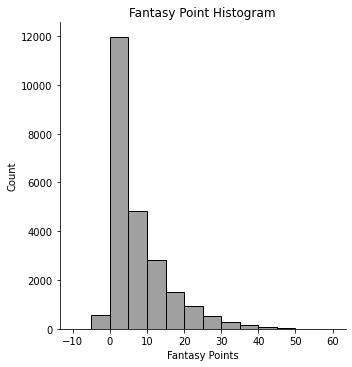

In [8]:
fan_pt_bins = [-10, -5, 0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60]

_ = sns.displot(nfl["FAN_TOT"], kde=False, bins=fan_pt_bins, color='grey')
_ = plt.xlabel('Fantasy Points')
_ = plt.ylabel('Count')
_ = plt.title('Fantasy Point Histogram')

plt.show()

The data indicates that there are a lot of relatively low values, with majority of data in the 0 to 5 fantasy points range. The data is skewed and has a long right tail. There is no clear indication of the distribution type and will need to test this further.


#### ECDF

Next, I will plot felt an Empirical Cumulative Distribution Function (ECDF) as this may show the distribution of of the data more clearly. 

First, I will define a function to create the ECDF, followed by a plot showing the total fantasy point data distribution.

In [9]:
def ecdf(data):
    """Compute ECDF for a one-dimensional array of measurements."""
    # Number of data points: n
    n = len(data)

    # x-data for the ECDF: x
    x = np.sort(data)

    # y-data for the ECDF: y
    y = np.arange(1, n+1) / n

    return x, y

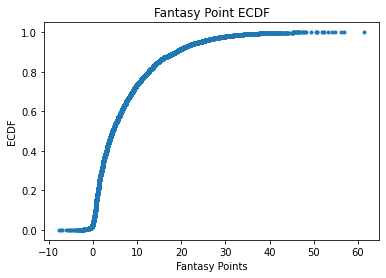

In [10]:
# Compute ECDF
x_fan, y_fan = ecdf(nfl.FAN_TOT)

# Generate plot
_ = plt.plot(x_fan, y_fan, marker='.', linestyle='none')

# Label the axes
_ = plt.xlabel('Fantasy Points')
_ = plt.ylabel('ECDF')
_ = plt.title('Fantasy Point ECDF')

# Display the plot
plt.show()

The above ECDF (as well as the Historgram before it) give us an excellent visual of the distribution of the 'FAN_TOT' field and they seem to indicate that this data does not represent a Normal Distribution. However, to more clearly show this we can generate and plot a Normal Distribution on the ECDF to further analysis this.

Do this, we must first find out the Mean and Standard Distribution of the 'FAN_TOT' data.

In [11]:
fan_pt_mean = np.mean(nfl['FAN_TOT'])
fan_pt_std = np.std(nfl['FAN_TOT'])

print('Mean: ', round(fan_pt_mean, 2))
print('STD: ', round(fan_pt_std, 2))

Mean:  7.33
STD:  7.94


We can then use the Mean and Standard Deviation to create a Normal Distribution.

In [12]:
fan_pt_normdist = np.random.normal(fan_pt_mean, fan_pt_std, size=100000)

And finally, we can plot both this Normal Distribution and the actual 'FAN_TOT' data side by side to see how they compare.

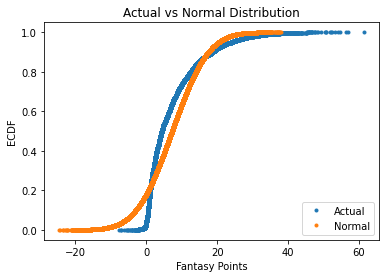

In [13]:
# Generate Normal Distribution ECDF
x_norm, y_norm = ecdf(fan_pt_normdist)

# Generate plot
_ = plt.plot(x_fan, y_fan, marker='.', linestyle='none')
_ = plt.plot(x_norm, y_norm, marker='.', linestyle='none')

# Label the axes
_ = plt.xlabel('Fantasy Points')
_ = plt.ylabel('ECDF')
_ = plt.title('Actual vs Normal Distribution')

# Add Legend
_ = plt.legend(('Actual', 'Normal'), loc='lower right')

# Display the plot
plt.show()

#### Is it a Normal Distribution?

The above ECDF seems to clearly show that this is not a Normal Distribution.

For final confirmation, will test use **normaltest()** fucntion from scipy.stats to test the null hypthesis that 'FAN_TOT' data is normally distributed.

In [14]:
print(scipy.stats.normaltest(nfl['FAN_TOT']))

NormaltestResult(statistic=7607.99497912963, pvalue=0.0)


With the null hypothesis being that the data are normally distributed, the lower the p-value in the result of this test, the more likely the data are to be non-normal.

Since the p-values is 0, regardless of what we pick for the significance level, our conclusion is that the data is **not normally distributed**.

#### Outliers

Following this, I wanted to see in more detail where the outliers in the data were and how this might be creating a right tail on the data.

The summary statistics and boxplots (along with distribution charts earlier) show that there are a large amount of outliers at the upper end of the dataset. 

However, I'm not of the view that we do not want to remove these outlier as they are likely to be the most interesting (i.e. how do we know when a player is going to have I high scoring fantasy week). There is a larger number of low values that will need to be accounted for and will interesting to see if players who consistently score low, continue to do so - and the same with high scoring players.

In [15]:
nfl['FAN_TOT'].describe()

count    23715.000000
mean         7.325832
std          7.938434
min         -7.600000
25%          1.500000
50%          4.400000
75%         10.600000
max         61.300000
Name: FAN_TOT, dtype: float64

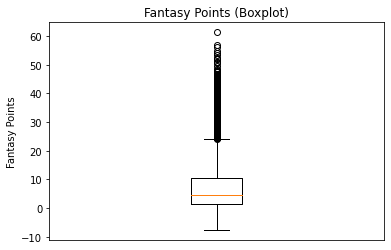

In [16]:
_ = plt.boxplot(nfl.FAN_TOT)
#_ = plt.xlabel('Total')
_ = plt.ylabel('Fantasy Points')
_ = plt.title('Fantasy Points (Boxplot)')
_ = plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False)

plt.show()

#### Bootstrapping

Without testing for other distribution types, we cannot assume a distribution for the Fantasy Point data. However, through boostrapping, we can estimate the distribution within certain confidence intervals.

To start, I will define functions that will allow me to generate bootstrap replicates.

In [17]:
def bootstrap_replicate_1d(data, func):
    """Generate bootstrap replicate of 1D data."""
    bs_sample = np.random.choice(data, len(data))
    return func(bs_sample)

In [18]:
def draw_bs_reps(data, func, size=1):
    """Draw bootstrap replicates."""

    # Initialize array of replicates: bs_replicates
    bs_replicates = np.empty(size)

    # Generate replicates
    for i in range(size):
        bs_replicates[i] = bootstrap_replicate_1d(data, func)

    return bs_replicates

Next, I will use this function to randomly sample (with replacement) the 'FAN_TOT' column and calculate the mean 10,000 times.

In [19]:
bootstrap_dist = draw_bs_reps(nfl['FAN_TOT'], np.mean, size=10000)

We can display this sampling distribution in a histogram.

The shape follows what would be expected according to the Central Limit Theorm in that the distribution of the sample mean tends toward a normal distribution with increased sample size, regardless of the orginal distribution.

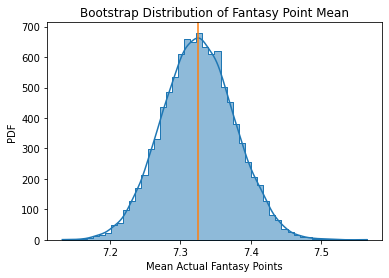

In [20]:
_ = sns.histplot(bootstrap_dist, bins=50, kde=True, element="step")
_ = plt.xlabel('Mean Actual Fantasy Points')
_ = plt.ylabel('PDF')
_ = plt.title('Bootstrap Distribution of Fantasy Point Mean')
_ = plt.axvline(nfl['FAN_TOT'].mean(), color='C1')

plt.show()

Next, we want calculate the Confidence Interval of the sample distribution to allow us to quantify the uncertainty around our estimates. 

This can be done using the **np.percentile()** function.

In [21]:
conf_int = np.percentile(bootstrap_dist, [2.5, 97.5])
print('95% confidence interval =', round(conf_int[0], 2), 'to', round(conf_int[1], 2), 'points')

95% confidence interval = 7.23 to 7.43 points


The 95% confidence interval is 7.23 to 7.43. This states that the 95% of the time in which its assumptions are correct, this interval will contain the true value. This is displayed in histogram chart below.

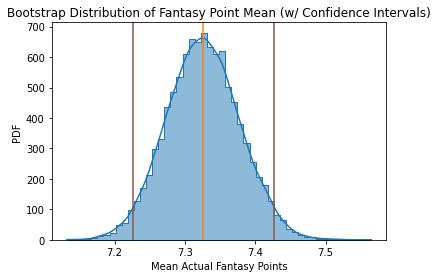

In [22]:
_ = sns.histplot(bootstrap_dist, bins=50, kde=True, element="step")
_ = plt.xlabel('Mean Actual Fantasy Points')
_ = plt.ylabel('PDF')
_ = plt.title('Bootstrap Distribution of Fantasy Point Mean (w/ Confidence Intervals)')
_ = plt.axvline(nfl['FAN_TOT'].mean(), color='C1')
_ = plt.axvline(conf_int[0], color='C5')
_ = plt.axvline(conf_int[1], color='C5')

plt.show()

Another way to calculate this would be using the Margin of Error calculation. This is calculated below and shows that an estimate for the 'FAN_TOT' could be written as:

**Estimate = 7.33 +/- 0.1**

In [23]:
moe_bootstrap_dist = 1.96 * np.std(bootstrap_dist)
print('Margin of Error: ', round(moe_bootstrap_dist, 2))

mean_bootstrap_dist = np.mean(bootstrap_dist)
print('Sample Mean: ', round(mean_bootstrap_dist, 2))

high_bootstrap_dist = mean_bootstrap_dist + moe_bootstrap_dist
low_bootstrap_dist = mean_bootstrap_dist - moe_bootstrap_dist
#print(low_bootstrap_dist, high_bootstrap_dist)

Margin of Error:  0.1
Sample Mean:  7.33


## Categorical Variables

In this section, I will look at how Fantasy Points performance differs across the various different categorical variables in the dataset.

I will start first by listing the columns that are object fields. I will start by defining a for loop to allow me to call columns by dtype. I'm doing this as I will likely be using this piece of code again and defining it will allow me to repeat without having to copy over lines of code each time. I will then use this function to call all columns in dataset with 'object' dtype.

In [24]:
def dtype_col(df, dtype):

    '''
    This fucntion prints all columns that are object data types
    '''

    for col in df:
        if df[col].dtypes == dtype:
            print(col)
        else:
            continue

In [25]:
dtype_col(nfl, 'object')

POS
TEAM
HC
OC
DC
H/A
OPP
OPP HC
OPP OC
OPP DC
DATE
WEEK
MONTH
DAY
TIME
ROOF
SURFACE
W/L
POS_AGG
PLAYER_NAME


This provides me a list of the categorical variables in the dataset.

### Position

The first of these Categorical variables is 'POS' which relates to the position each player has on a team. Also in the list is the 'POS_AGG' column which is an aggregate Position Group that was developed in the Data Wrangling stage to reduce the number of position types.

#### Counts


We can start by simply looking at the different unique members of both Position columns.

In [26]:
print(nfl.POS.unique())
print(nfl.POS_AGG.unique())

['QB' 'WR' 'RB' 'FB' 'TE' 'DT' 'K' 'P' 'S' 'OL' 'T' 'LT' 'CB' 'C' 'DE'
 'FS' 'LB' 'G' 'DB' 'OT' 'LS' 'DL']
['QB' 'WR' 'RB' 'TE' 'OTH']


We see that the 'POS' column has a lot more unique types than 'POS_AGG'. 

Next we will plot a bar chart of the two columns to see the number of rows associated with each group.

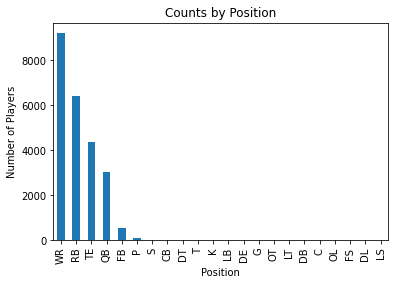

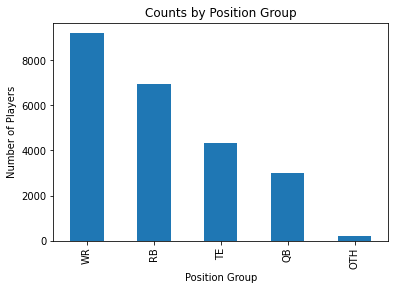

In [27]:
_ = nfl['POS'].value_counts().plot(kind='bar')
_ = plt.xlabel('Position')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Position')

plt.show()

_ = nfl['POS_AGG'].value_counts().plot(kind='bar')
_ = plt.xlabel('Position Group')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Position Group')

plt.show()

In [28]:
nfl['POS_AGG'].value_counts()

WR     9197
RB     6953
TE     4352
QB     3015
OTH     198
Name: POS_AGG, dtype: int64

The first chart shows that we were right at Data Wrangling stage to group a lot of the smaller unique values into aggregate groups. While the second chart shows that 'OTH' still has relatively few rows.

#### Fantasty Points

As mentioned earlier, understanding what predicts 'FAN_TOT' is the objective of this analysis so with this is mind we will want to see how each categorical variable might help explain this.

To do this, we again plot a bar chart to see how the average fantasy performance varies across each position group.

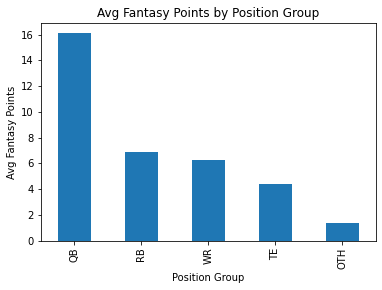

POS_AGG
QB     16.09
RB      6.88
WR      6.29
TE      4.43
OTH     1.39
Name: FAN_TOT, dtype: float64


In [29]:
_ = nfl.groupby('POS_AGG')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Position Group')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Position Group')

plt.show()

print(nfl.groupby('POS_AGG')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

The chart clearly shows that the QB position is the highest scoring while the 'OTH' column is clearly the lowest scoring.

#### Distribution

Due the variation in average Fantasy points by position group, it would be interesting to see if the distribution of data changes much between each group.

To do this, we will start by creating a KDE plot. The KDE plot is a useful to visualize just the “shape” of some data, as a kind of continuous replacement for the discrete histogram. This is particularly useful in this instance as we want to display multiple distributions across the different position groups.

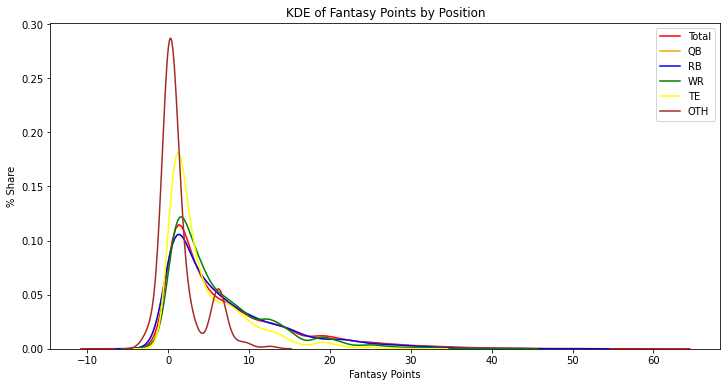

In [30]:
_ = plt.figure(figsize=(12,6))
_ = sns.kdeplot(nfl["FAN_TOT"], color='red', label='Total')
_ = sns.kdeplot(nfl[nfl['POS_AGG'] =='RB']["FAN_TOT"], color='orange', label='QB')
_ = sns.kdeplot(nfl[nfl['POS_AGG'] =='RB']["FAN_TOT"], color='blue', label='RB')
_ = sns.kdeplot(nfl[nfl['POS_AGG'] =='WR']["FAN_TOT"], color='green', label='WR')
_ = sns.kdeplot(nfl[nfl['POS_AGG'] =='TE']["FAN_TOT"], color='yellow', label='TE')
_ = sns.kdeplot(nfl[nfl['POS_AGG'] =='OTH']["FAN_TOT"], color='brown', label='OTH')

_ = plt.xlabel('Fantasy Points')
_ = plt.ylabel('% Share')
_ = plt.legend()
_ = plt.title('KDE of Fantasy Points by Position')

plt.show()

The KDE plot continues to show that the data is skewed with a right-hand tail. However, this does seem to be more pronounced for the 'OTH' and to lesser extent 'TE' position groups.

Another way to display this distribution would to again apply an ECDF across the different position groups. This is displayed in the graph below.

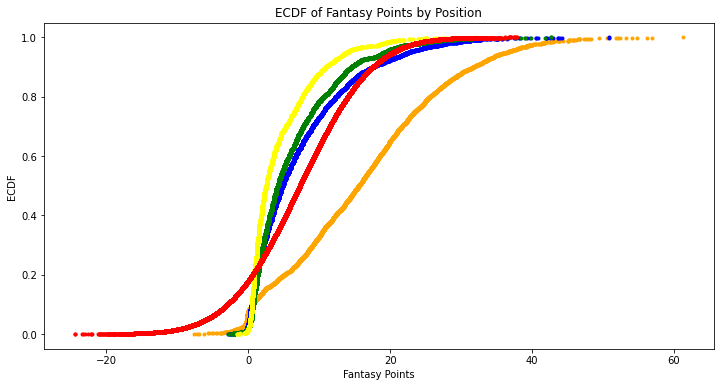

In [31]:
x_fan_QB, y_fan_QB = ecdf(nfl[nfl['POS'] =='QB']["FAN_TOT"])
x_fan_RB, y_fan_RB = ecdf(nfl[nfl['POS'] =='RB']["FAN_TOT"])
x_fan_WR, y_fan_WR = ecdf(nfl[nfl['POS'] =='WR']["FAN_TOT"])
x_fan_TE, y_fan_TE = ecdf(nfl[nfl['POS'] =='TE']["FAN_TOT"])
x_fan_OTH, y_fan_OTH = ecdf(nfl[nfl['POS'] =='OTH']["FAN_TOT"])

_ = plt.figure(figsize=(12,6))
_ = plt.plot(x_fan_QB, y_fan_QB, marker='.', linestyle='none', color='orange')
_ = plt.plot(x_fan_RB, y_fan_RB, marker='.', linestyle='none', color='blue')
_ = plt.plot(x_fan_WR, y_fan_WR, marker='.', linestyle='none', color='green')
_ = plt.plot(x_fan_TE, y_fan_TE, marker='.', linestyle='none', color='yellow')
_ = plt.plot(x_fan_OTH, y_fan_OTH, marker='.', linestyle='none', color='brown')
_ = plt.plot(x_norm, y_norm, marker='.', linestyle='none', color='red')

_ = plt.xlabel('Fantasy Points')
_ = plt.ylabel('ECDF')
_ = plt.title('ECDF of Fantasy Points by Position')

# Display the plot
plt.show()

This ECDF shows more clearly that the QB distribution seems to be very different to the other Position Groups. However, it still doesn't seem to match a Normal Distribution.

To confirm this, we will once again use the normaltest() from scipy.stats.

In [32]:
k2, p = scipy.stats.normaltest(nfl[nfl['POS'] =='QB']["FAN_TOT"])

print('Stasitic = ', k2)
print('P-value = ', p)

norm_test_value = 0.05

if p < norm_test_value:
  print('Null Hypothesis can be rejected. Not normally distributed.')
else:
  print('Null Hypothes cannot be rejected')

Stasitic =  93.55737380579315
P-value =  4.833641174366158e-21
Null Hypothesis can be rejected. Not normally distributed.


The test shows, that while the QB distribution may be different to the other position groups, it is still not normally distributed.

#### Outliers

Lastly, we look to see how the outliers are impacting the distribution across the data using Boxplots.

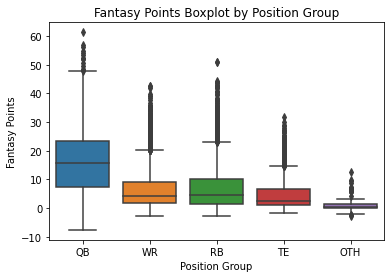

In [33]:
_ = sns.boxplot(data=nfl, x='POS_AGG', y='FAN_TOT')
_ = plt.xlabel('Position Group')
_ = plt.ylabel('Fantasy Points')
_ = plt.title('Fantasy Points Boxplot by Position Group')

plt.show()

Similar to the overall data, there are a significant number of outliers across each Position Group. Also, as indicated on the ECDF charts above, the 'QB' group seems to have less of a right-tail and therefore less outliers than the other groups. 'OTH' is the only group to have an outlier at the bottom of the chart.

#### Conclusion

From the review of position categorical columns, there are couple of important takeaways:


1.   **Drop 'POS' column:** After reviewing both the 'POS' and 'POS_AGG', it does not seem that the additional unique values in 'POS' column add signficant value in terms of understanding fantasy performance. With this in mind, along with the fact that their inclusion would generate significant additional dimensions to dataset through creation of several dummy columns, it is thought that it would be best to remove the 'POS' column and proceed with the 'POS_AGG' column only.

In [34]:
nfl = nfl.drop(columns=['POS'])
nfl.head()

,TEAM,HC,OC,DC,H/A,OPP,OPP HC,OPP OC,OPP DC,DATE,SEASON,WEEK,MONTH,DAY,TIME,ROOF,SURFACE,W/L,PASSCOMP,PASSATT,PASSCOMP%,PASSYDS,PASSTD,INT,QBRAT,SACK,SACKYDS,RUSHATT,RUSHYDS,RUSHTD,TGTS,REC,RECYDS,RECTD,FUM,FUMLST,POS_AGG,PLAYER_NAME,PTS_FOR,PTS_AGT,FAN_PASSYDS,FAN_PASSTD,FAN_PASSYDS_300,FAN_PASSYDS_400,FAN_INT,FAN_SACK,FAN_PASS_TOT,FAN_RUSHYDS,FAN_RUSHTD,FAN_RUSHYDS_100,FAN_RUSHYDS_200,FAN_FUMLST,FAN_RUSH_TOT,FAN_RECYDS,FAN_RECTD,FAN_RECYDS_100,FAN_RECYDS_200,FAN_REC_TOT,FAN_TOT
0,Packers,Joe Philbin,Joe Philbin,Mike Pettine,Home,Lions,Matt Patricia,Jim Bob Cooter,Paul Pasqualoni,2018-12-30,2018,Week17,December,Sunday,Noon,Open,Grass,L,3,5,0.6,26,0,0,73.7,1,12,0,0,0,0,0,0,0,0,0,QB,Aaron Rodgers,0,31,1.04,0,0,0,0,-0.5,0.54,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0.54
1,Buccaneers,Dirk Koetter,Todd Monken,Mark Duffner,Home,Falcons,Dan Quinn,Steve Sarkisian,Marquand Manuel,2018-12-30,2018,Week17,December,Sunday,Noon,Open,Grass,L,0,0,0.0,0,0,0,0.0,0,0,0,0,0,6,5,66,0,0,0,WR,Adam Humphries,32,34,0.00,0,0,0,0,-0.0,0.00,0.0,0,0,0,0,0.0,6.6,0,0,0,6.6,6.60
2,Vikings,Mike Zimmer,Kevin Stefanski,George Edwards,Home,Bears,Matt Nagy,Mark Helfrich,Vic Fangio,2018-12-30,2018,Week17,December,Sunday,Afternoon,Dome,Turf,L,0,0,0.0,0,0,0,0.0,0,0,1,-1,0,4,3,38,0,0,0,WR,Adam Thielen,10,24,0.00,0,0,0,0,-0.0,0.00,-0.1,0,0,0,0,-0.1,3.8,0,0,0,3.8,3.70
3,Redskins,Jay Gruden,Matt Cavanaugh,Greg Manusky,Home,Eagles,Doug Pederson,Mike Groh,Jim Schwartz,2018-12-30,2018,Week17,December,Sunday,Afternoon,Open,Grass,L,0,0,0.0,0,0,0,0.0,0,0,4,0,0,0,0,0,0,0,0,RB,Adrian Peterson,0,24,0.00,0,0,0,0,-0.0,0.00,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0.00
4,Panthers,Ron Rivera,Norv Turner,Eric Washington,Away,Saints,Sean Payton,Pete Carmichael Jr.,Dennis Allen,2018-12-30,2018,Week17,December,Sunday,Noon,Dome,Turf,W,0,0,0.0,0,0,0,0.0,0,0,1,1,0,1,1,5,0,0,0,RB,Alex Armah,33,14,0.00,0,0,0,0,-0.0,0.00,0.1,0,0,0,0,0.1,0.5,0,0,0,0.5,0.60



2.   **Drop 'OTH' position group:** After reviewing the 'POS_AGG' column, it seems that that the position group 'OTH' does not contribute much to the dataset, either in terms of players (only 138 rows) or fantasy points (1.39 average). It must also be noted that in most fantasy football leagues you can not select players are in the 'OTH' positions so the value that could be derived from this field is likely to be unactionable. With these factors in mind, it is thought it would be best to remove all rows with 'OTH' from the dataset. 


In [35]:
nfl = nfl[nfl['POS_AGG']!='OTH']
print(nfl.POS_AGG.unique())

['QB' 'WR' 'RB' 'TE']


In [36]:
print(nfl.shape)

(23517, 59)


3.   **Change 'POS_AGG' name to 'POS':** This is purely for ease of working through data at later stages.

In [37]:
nfl.rename(columns={'POS_AGG':'POS'}, inplace=True)
print(nfl.POS.unique())
nfl.shape

['QB' 'WR' 'RB' 'TE']


(23517, 59)

4.   **Include Position Group in Modelling:** From this review, it seems like Position Group is a relevant factor in terms of understanding how many fantasy points a player will score in a given week, given the difference in average score across the position groups. For this reason, this column should be included in the modelling going forward.





### Team

The next categorical variable to analyse is 'TEAM' which indicates which NFL team a player plays on.

For this, I will be following the steps used for Position columns and will not explain each step from before unless there is something important to comment on or change in approach due to the exploration of the data.

#### Counts

There are 32 unique values in the 'TEAM' column as expected (as there are only 32 teams in the NFL). The counts histogram show nothing to unexpected with the player counts ranging from 685 (with New York Jets) to 839 (with Baltimore Ravens).

In [38]:
print('Number of Teams = ', nfl.TEAM.nunique())
#print(nfl.TEAM.unique())

Number of Teams =  32


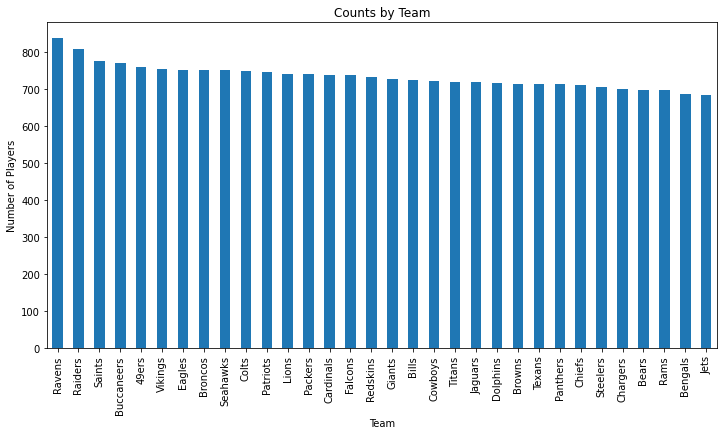

In [39]:
_ = plt.figure(figsize=(12,6))
_ = nfl['TEAM'].value_counts().plot(kind='bar')
_ = plt.xlabel('Team')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Team')

plt.show()

#print(nfl['TEAM'].value_counts())

#### Fantasy Points

Looking at average fantasy points across each team, there is a difference in peformance across the different teams ranging from 8.6 points (New Orleans Saints) to 6.4 points (Denver Broncos). 

Most interesting is a tier of 6 teams at the top who average over 8 points per player, before a drop off a visual drop off to the next team.


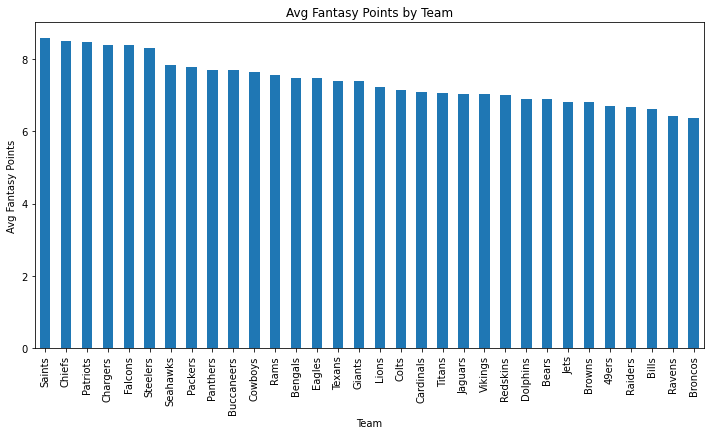

In [40]:
_ = plt.figure(figsize=(12,6))
_ = nfl.groupby('TEAM')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Team')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Team')

plt.show()

#print(nfl.groupby('TEAM')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

However, it is important to caution that this might not tell full story as averages could be influenced by multiple different factors. One that springs to mind is that the Baltimore Ravens have the highest player count but one of the lowest averages - which may indicate that they use more players that bring down the overall average.

With this in mind, we created another bar chart that shows how many total fantasy points each team scored throughout the dataset. This shows that a team like the Baltimore Ravens was actually in the middle of the pack when it came to total fantasy points scored, where as a team like the Saints remained at the top and the Broncos remained close to the bottom.

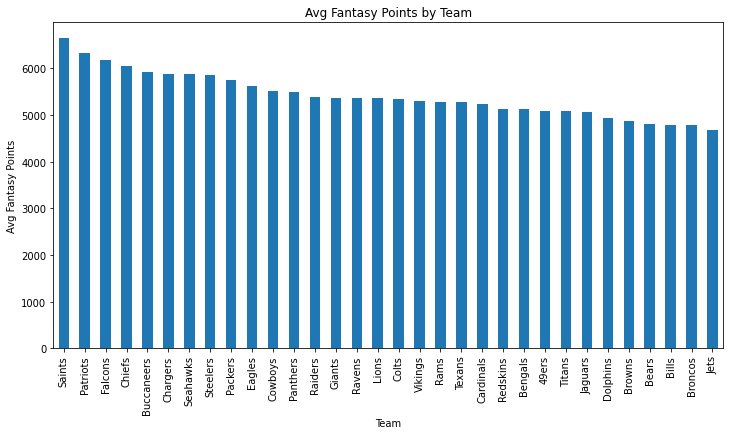

In [41]:
_ = plt.figure(figsize=(12,6))
_ = nfl.groupby('TEAM')['FAN_TOT'].sum().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Team')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Team')

plt.show()

#print(nfl.groupby('TEAM')['FAN_TOT'].sum().round(1).sort_values(ascending=False))

Due to the number of unique values, I will not look at the distribution on a team by team basis.

#### Conclusion

1.   **Team matters:** Certain teams score more fantasy points then other teams and this will likely influence how many fantasy points a player can score in a given week.

2.   **High dimensionality:** There are 32 unique values meaning that transforming and including this in the dataset for model will make the data more sparse and potential impact on performance of the model.

3.   **Keep for now but keep eye out for alternatives:** I will not remove from dataset as 'TEAM' column looks like it could help in understanding how player performs each week. However, may be useful to think of alternatives ways to include this information without the need for so many columns. This could come in the way of:

  *   Summary statistic that shows the team's total fantasy points for that week and see if that influences a player's performance (although you would need to be careful, as these would not be independent of each other). 
  *   Cluster teams into groups that would keep information but potentially  reduce the need for such a larger number of dimensions



### Head Coach

The next categorical variable to analyse is 'HC' which indicates which the Head Coach for the team a player plays on. 

The expectation is that this will perform very similarly to the 'TEAM' variable but at least account for changes in coach that could signficantly impact a team's and therefore a players performance.

#### Counts

Number of Head Coaches is nearly double the number of teams in the league at 63 over the time period of this dataset.

There is a marked difference in the number of counts for each Head Coach, spanning from 839 (John Harbough) to 29 (John Fassel).

In [42]:
print('Number of Head Coaches = ', nfl.HC.nunique())
#print(nfl.HC.unique())

Number of Head Coaches =  63


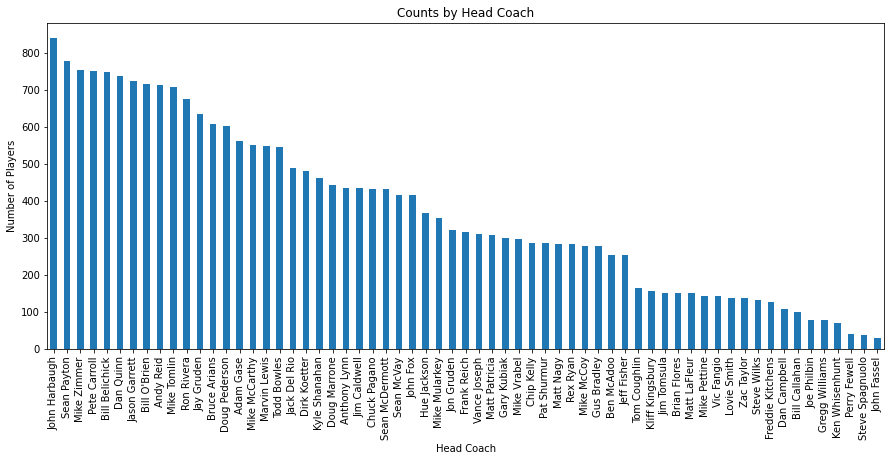

In [43]:
_ = plt.figure(figsize=(15,6))
_ = nfl['HC'].value_counts().plot(kind='bar')
_ = plt.xlabel('Head Coach')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Head Coach')

plt.show()

#print(nfl['HC'].value_counts())

#### Fantasy Points

Average points per game looks to have a similar shape to the 'TEAM' category, although with a little bit more variability, with points ranging from 9.0 points (Sean McVay) to 2.8 points (John Fassel - which looks like an outlier).

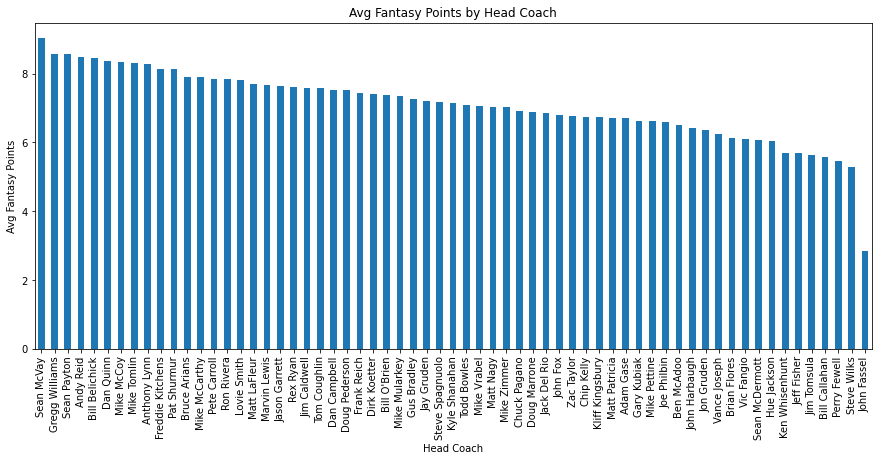

In [44]:
_ = plt.figure(figsize=(15,6))
_ = nfl.groupby('HC')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Head Coach')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Head Coach')

plt.show()

#print(nfl.groupby('HC')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

#### Conclusion



1.   **Similar to 'TEAM' column:** Similar trend to 'TEAM' column previously reviewed and liklihood a lot of overlap in information. Knowledge of NFL tells me that teams like Saints and Chiefs that were the highest scoring teams, also have their coaches near the top of the list with Sean Payton and Andy Reid. 
2.   **May account for some variability, change in performance from change in HC:** The Rams are an example of this - they were middle of the pack when we looked a team-level but when you look at coaches individually see that Sean McVay is top of list while the coach he replaced, Jeff Fisher, is near the bottom.
2.   **Can only include this column or 'TEAM' column, not both:** Based on points above, don't believe you can include both columns for fear of duplicating information.
2.   **If include, same process as 'TEAM' needed to reduce dimensionality:** See suggest alterations in 'TEAM' section.



### Offensive Coorindator

The next categorical variable to analyse is 'OC' which indicates which the Offensive Coordinator for the team a player plays on.

The expectation is that this will perform very similarly to the 'HC' variable in that could have a greater degree of unique values than 'TEAM' but his help explain how changes in coach that could impact a team's and therefore a players performance.


#### Counts 

This column has greater number of unique values compared to 'TEAM' or 'HC' with 76.

In [45]:
print('Number of Offensive Coordinators = ', nfl.OC.nunique())
#print(nfl.OC.unique())

Number of Offensive Coordinators =  76


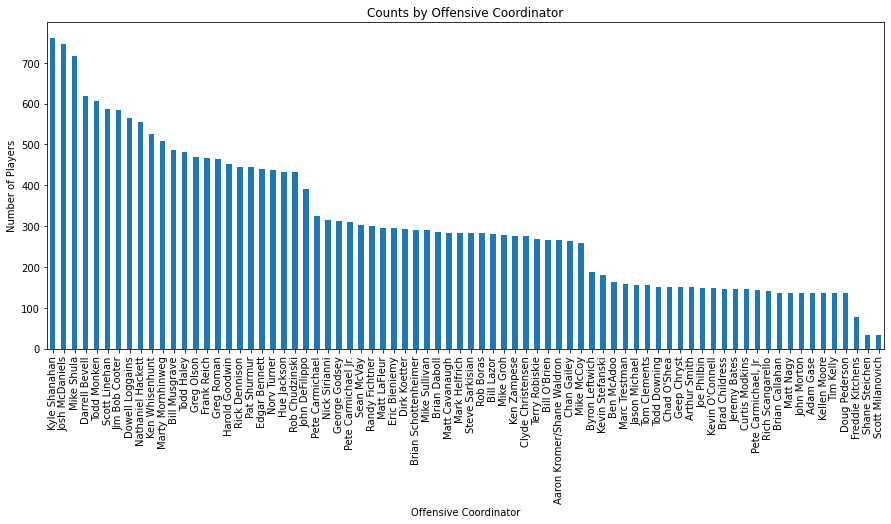

In [46]:
_ = plt.figure(figsize=(15,6))
_ = nfl['OC'].value_counts().plot(kind='bar')
_ = plt.xlabel('Offensive Coordinator')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Offensive Coordinator')

plt.show()

#print(nfl['OC'].value_counts())

#### Fantasy Points

This column has similar range to 'HC' column, going from 10.2 (Kellen Moore) to 3.3 (Scott Milanovich).

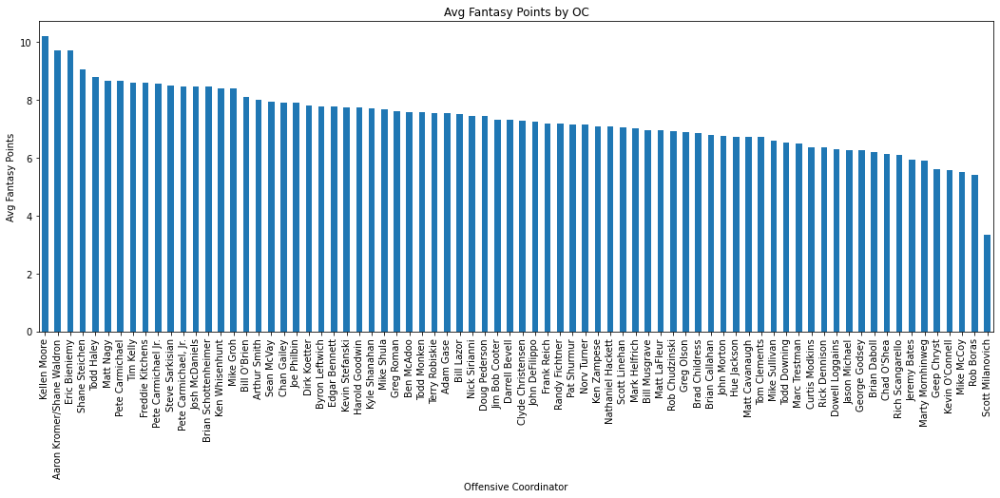

OC
Kellen Moore                  10.21
Aaron Kromer/Shane Waldron     9.72
Eric Bieniemy                  9.71
Shane Steichen                 9.04
Todd Haley                     8.79
                              ...  
Geep Chryst                    5.62
Kevin O'Connell                5.58
Mike McCoy                     5.52
Rob Boras                      5.39
Scott Milanovich               3.34
Name: FAN_TOT, Length: 76, dtype: float64


In [47]:
_ = plt.figure(figsize=(18,6))
_ = nfl.groupby('OC')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Offensive Coordinator')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by OC')

plt.show()

print(nfl.groupby('OC')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

#### Conclusion

1.   **Similar to 'TEAM' and 'HC' columns:** Similar trend to 'TEAM' and 'HC' columns reviewed and liklihood a lot of overlap in information. 
2.   **Higher number of unique values:** This means there would increase in number of dimensions if we were to transform this data to put into our model.
3.   **Decision will be required on which of 'TEAM', 'HC', or 'DC' to include:** Based on review so far, it does not seem sensible to include all three of these columns due to the duplication of information and increase in dimensionality (unless solution is found). We will not remove any columns yet but will do this prior to modelling our data.

### Opponent - Team, Head Coach, and Defensive Coordinator

Over the past few sections we have looked at how the team and their coaches impact on the 'FAN_TOT' column. Next, we want to look at how the Opponent and their coaches might give us an indication of how a player's 'FAN_TOT' is going to perform.

Unlike the previous sections, where these were analysed individually, I will look three columns over the course of this section:
*  'OPP'
*  'OPP HC'
*  'OPP DC'

#### Counts

Counts confirm what we were expecting for Teams and Head Coaches (there should be no change in unique values between this and earlier review). The number of Defensive Coordinators is lower than coaches which is a positive compared to what we found with Offensive Coordinators earlier.

Histograms show that counts by Team are consistent across the NFL but that there more flucations across Head Coach and Defensive Coordinator histograms - due to the nature coach churn in the NFL.

In [48]:
print('Number of Opponent Team = ', nfl.OPP.nunique())
#print(nfl.OPP.unique())

print('Number of Opponent Head Coaches = ', nfl['OPP HC'].nunique())
#print(nfl.OPP_HC.unique())

print('Number of Opponent DCs = ', nfl['OPP DC'].nunique())
#print(nfl.OPP_DC.unique())

Number of Opponent Team =  32
Number of Opponent Head Coaches =  63
Number of Opponent DCs =  62


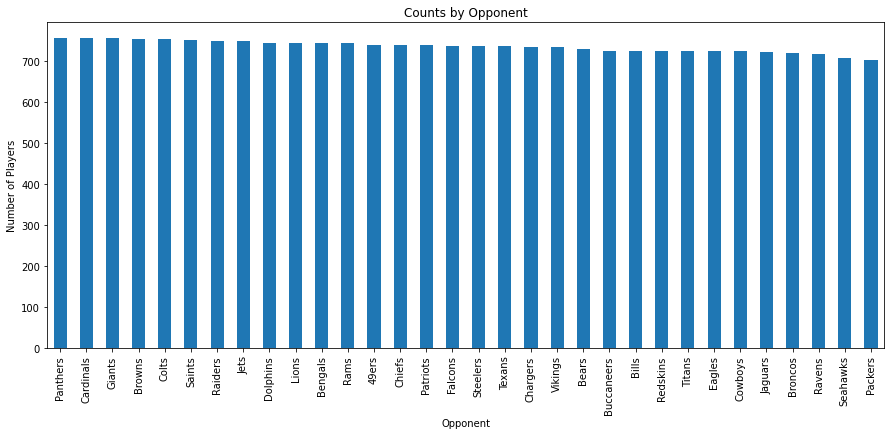

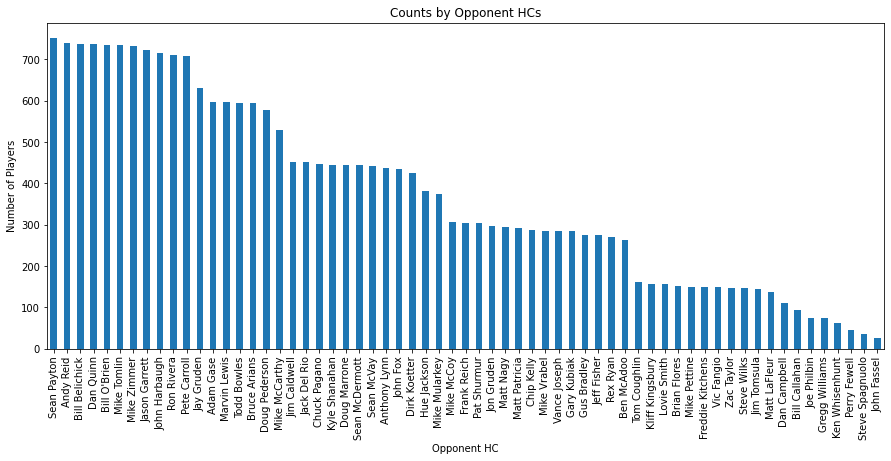

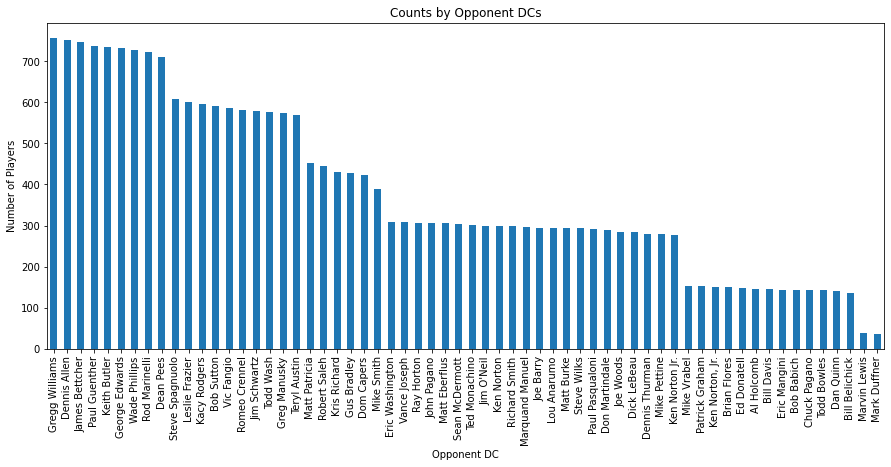

In [49]:
_ = plt.figure(figsize=(15,6))
_ = nfl['OPP'].value_counts().plot(kind='bar')
_ = plt.xlabel('Opponent')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Opponent')

plt.show()

#print(nfl['OPP'].value_counts())

_ = plt.figure(figsize=(15,6))
_ = nfl['OPP HC'].value_counts().plot(kind='bar')
_ = plt.xlabel('Opponent HC')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Opponent HCs')

plt.show()

#print(nfl['OPP HC'].value_counts())

_ = plt.figure(figsize=(15,6))
_ = nfl['OPP DC'].value_counts().plot(kind='bar')
_ = plt.xlabel('Opponent DC')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Opponent DCs')

plt.show()

#print(nfl['OPP DC'].value_counts())

#### Fantasy Points

The below Bar charts show that the amount of fantasy point conceded tends to vary by Team, Head Coach and Defensive Coordinator and that the Head Coach and Defensive Coordinator columns give us a bit more detail into why a particular coach might be impacting this on a team. This is shown by greater range of scores across the columns:

*   8.2 (Dolphins) to 6.3 (Vikings)
*   9.0 (Brian Flores) to 5.9 (Gary Kubiak)
*   9.0 (Bill Davis) to 5.3 (Bill Belichick)

As mentioned before, there is great degree of overlap between these columns and this can be shown by the shape of the bar charts being similar across each column.

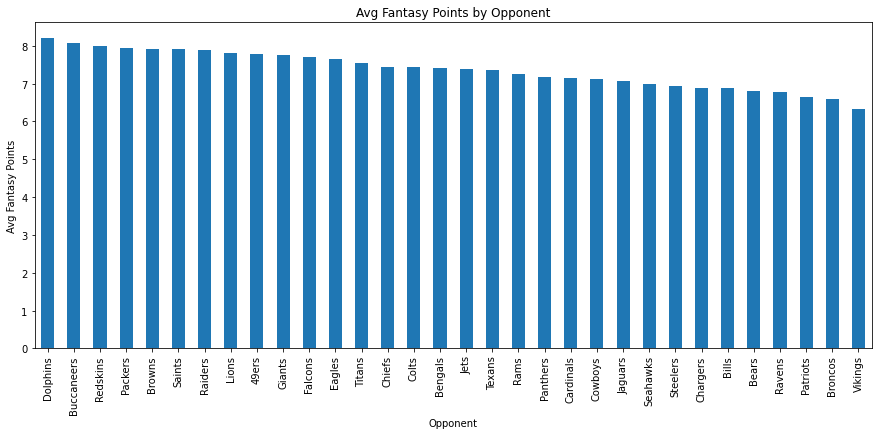

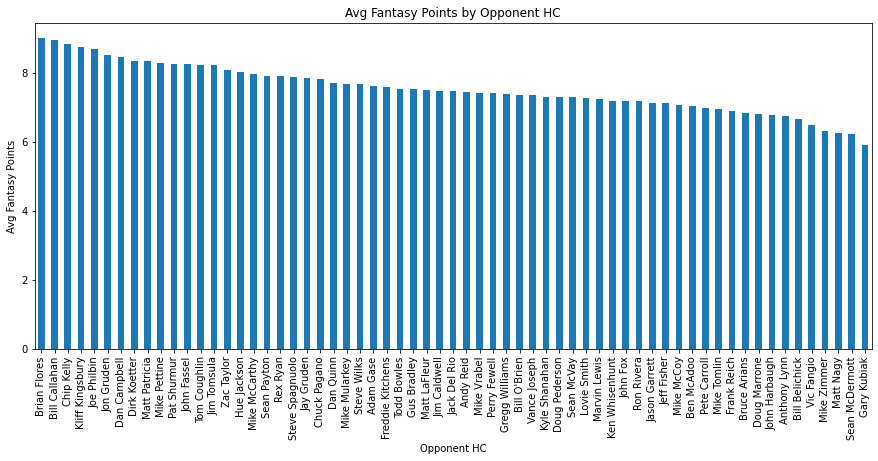

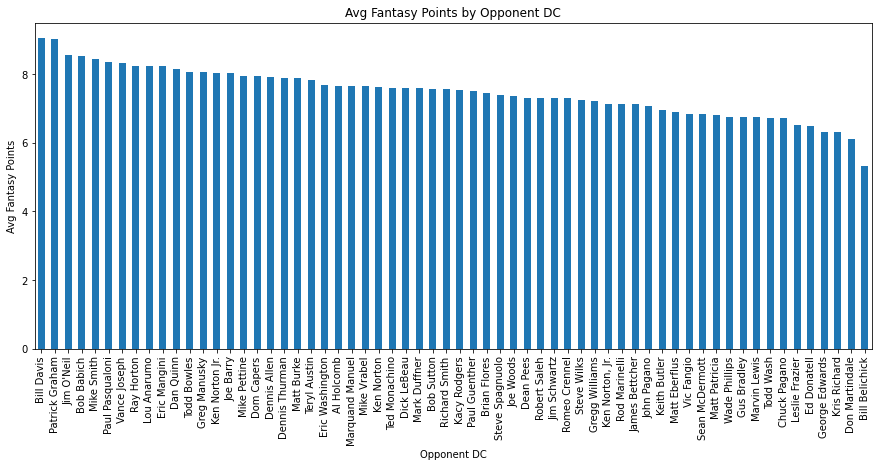

In [50]:
_ = plt.figure(figsize=(15,6))
_ = nfl.groupby('OPP')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Opponent')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Opponent')

plt.show()

#print(nfl.groupby('OPP')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

_ = plt.figure(figsize=(15,6))
_ = nfl.groupby('OPP HC')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Opponent HC')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Opponent HC')

plt.show()

#print(nfl.groupby('OPP HC')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

_ = plt.figure(figsize=(15,6))
_ = nfl.groupby('OPP DC')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Opponent DC')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Opponent DC')

plt.show()

#print(nfl.groupby('OPP DC')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

#### Conclusion



1.   **Opposition Team and Coaches matter:** There is enough change in average fantasy performance across these fields that makes me interested to investigate further whether if the opponent is a significant factor in a a player's fantasy performance. 
2.   **Only use one column, not all of them:** As mention above, these columns are not independent and therefore we could not include them all in our modelling.
3.   **Dimensionality:** Need to find out way to reduce dimensionality to support ability to include in future modellling.



In [51]:
#print(dtype_col(nfl, 'int64'))
#print(dtype_col(nfl, 'float64'))

### Game Setting

Next, I'm going to look at a few columns related to game setting to see the unique values they have stored in them, along with their impact on average fantasy points.

#### Counts

The below show that there are two unique values for each of the columns. Across these columns, the counts vary by:


*   H/A: Roughly same number of Home counts as Away counts (as would be expected)
*   **'ROOF':** 75% of counts are in open roof stadiums compared to domed stadiums.
*   **'SURFACE':** 56% of counts are on Grass surface compared to Turf surface.



In [52]:
print(nfl['H/A'].unique())
print(nfl['ROOF'].unique())
print(nfl['SURFACE'].unique())

['Home' 'Away']
['Open' 'Dome']
['Grass' 'Turf']


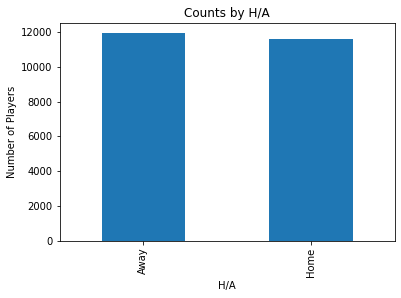

Away    11921
Home    11596
Name: H/A, dtype: int64


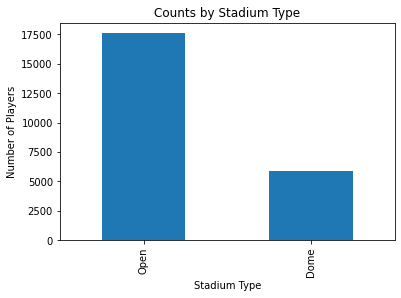

Open    17603
Dome     5914
Name: ROOF, dtype: int64


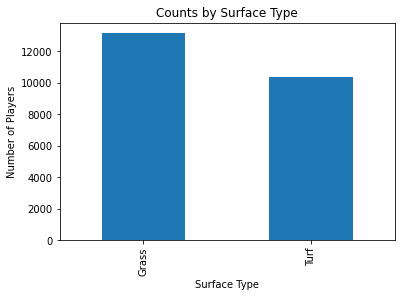

Grass    13149
Turf     10368
Name: SURFACE, dtype: int64


In [53]:
_ = nfl['H/A'].value_counts().plot(kind='bar')
_ = plt.xlabel('H/A')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by H/A')

plt.show()

print(nfl['H/A'].value_counts())

_ = nfl['ROOF'].value_counts().plot(kind='bar')
_ = plt.xlabel('Stadium Type')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Stadium Type')

plt.show()

print(nfl['ROOF'].value_counts())

_ = nfl['SURFACE'].value_counts().plot(kind='bar')
_ = plt.xlabel('Surface Type')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Surface Type')

plt.show()

print(nfl['SURFACE'].value_counts())

#### Fantasy Points

The average fantasy points scored by a player are slightly higher when playing at home - 7.6 vs 7.1.

The average fantasy points scored by a player are slightly higher when playing in a dome - 7.6 vs 7.3.

The average fantasy points scored by a player are slightly higher when playing in on turf - 7.6 vs 7.2.

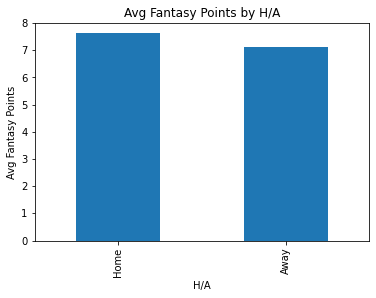

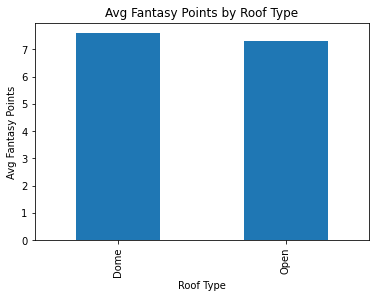

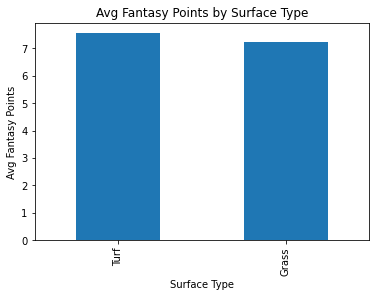

SURFACE
Turf     7.55
Grass    7.24
Name: FAN_TOT, dtype: float64


In [54]:
_ = nfl.groupby('H/A')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('H/A')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by H/A')

plt.show()

#print(nfl.groupby('H/A')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

_ = nfl.groupby('ROOF')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Roof Type')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Roof Type')

plt.show()

#print(nfl.groupby('ROOF')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

_ = nfl.groupby('SURFACE')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('Surface Type')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Surface Type')

plt.show()

print(nfl.groupby('SURFACE')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

#### Conclusion

1.   **Continue to include in dataset:** Differences across the two unique values in each column are not large enough to say for certain if they are significant contributor to a player's fantasy peformance. However, for confirmation or rejection of this I would like to keep them in the dataset.
2.   **Turn into binary data points:** As these columns have two variables in them, I would like to turn into booleans as True / False on whether one side of the attribute exists. This is done in the code below.



In [55]:
nfl['HOME'] = np.where(nfl['H/A'] == 'Home', 1, 0)
nfl['DOME'] = np.where(nfl['ROOF'] == 'Dome', 1, 0)
nfl['GRASS'] = np.where(nfl['SURFACE'] == 'Grass', 1, 0)

#nfl[['PLAYER_NAME', 'TEAM', 'HOME', 'DOME', 'GRASS']]

### Game Result

In this section we will look at the 'W/L' column to see how this data behaves.

#### Count

There are three unique types of results possible - Win, Lose or Tie. 

However, while the number of wins and loss are roughly level and account for majority of the dataset, there is a small number (89) of counts related to Ties.

In [56]:
print(nfl['W/L'].unique())

['L' 'W' 'T']


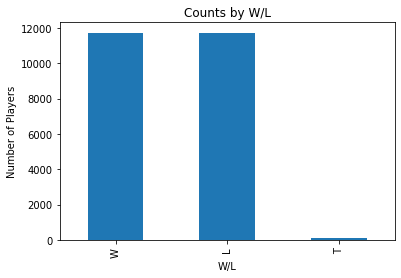

W    11728
L    11700
T       89
Name: W/L, dtype: int64


In [57]:
_ = nfl['W/L'].value_counts().plot(kind='bar')
_ = plt.xlabel('W/L')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by W/L')

plt.show()

print(nfl['W/L'].value_counts())

#### Fantasy Points

On average, more fantasy points are scored in Wins or Ties than in Losses

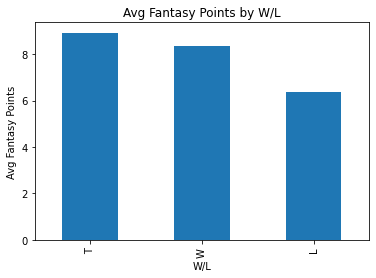

W/L
T    8.91
W    8.35
L    6.39
Name: FAN_TOT, dtype: float64


In [58]:
_ = nfl.groupby('W/L')['FAN_TOT'].mean().sort_values(ascending=False).plot(kind='bar')
_ = plt.xlabel('W/L')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by W/L')

plt.show()

print(nfl.groupby('W/L')['FAN_TOT'].mean().round(2).sort_values(ascending=False))

#### Conclusion

**1.   Clear difference in Fantasy Performance in Wins/Ties vs Losses:** More fantasy points are scored by the teams that win or tie. This intuitively makes sense. With this in mind and to reduce the possible number of columns, it makes sense to create a boolean column that tells us this information. This is done in the code below.

In [59]:
nfl['WIN/TIE'] = np.where(nfl['W/L'] == 'L', 0, 1)

#nfl_skill[['PLAYER_NAME', 'TEAM', 'WIN OR TIE']]

**2.   Only know result after the game:** While there looks to be a relationship between Wins/Ties and fantasy points, we only know the result of a game after it has happen and therefore is of little value to me a a fantasy player. Also, these events are not independent - a team may have won because of the high number of statistics that calculate fantasy scores. We will need to look at another way to include this information that will make it more dependent and useful to a fantasy player.

### Time / Date

Next I want to investigate the time/date related columns to see if any formatting is required here.

#### Count

All fields have low number of distinct values, except for 'DATE' which has 251 unique values.

In [60]:
print('Number of Time Periods = ', nfl['TIME'].nunique())
print('Number of Months = ', nfl['MONTH'].nunique())
print('Number of Weeks = ', nfl['WEEK'].nunique())
print('Number of Days = ', nfl['DAY'].nunique())
print('Number of Seasons = ', nfl['SEASON'].nunique())
print('Number of Dates = ', nfl['DATE'].nunique())

#print(nfl['TIME'].unique())
#print(nfl['MONTH'].unique())
#print(nfl['WEEK'].unique())
#print(nfl['DAY'].unique())
#print(nfl['SEASON'].unique())
#print(nfl['DATE'].unique())

Number of Time Periods =  5
Number of Months =  5
Number of Weeks =  17
Number of Days =  4
Number of Seasons =  5
Number of Dates =  251


Below shows the distribution across these categories. It highlights that:


* Time: Most data points relate to games at Noon (11k), with Afternoon and Night counts following after. London and Mexico have only a few counts between them. 

* Month: December, Novermber and October have highest number of values which makes sense as games are played each week during these months. September is slightly lower as season starts in this month and January only has a few games at the end of a season before playoffs.

* Week: Even distribution around per week.

* Day: Majority of values on Sunday as this is main day of week for NFL games. Monday and Thursday usually have one game a week so this share makes sense. Only on rare occasion are there games on Saturday (0.4k). 

* Season: Evenly distributed per season as expected.

* Date: Flucates greatly, likely due to high majority of games falling on Sunday.

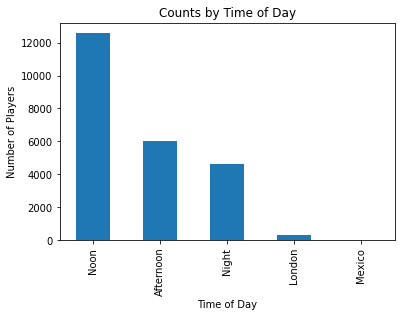

In [61]:
_ = nfl['TIME'].value_counts().plot(kind='bar')
_ = plt.xlabel('Time of Day')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Time of Day')

plt.show()

#nfl.TIME.value_counts()

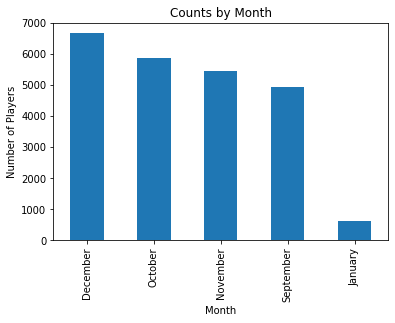

In [62]:
_ = nfl['MONTH'].value_counts().plot(kind='bar')
_ = plt.xlabel('Month')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Month')

plt.show()

#nfl.MONTH.value_counts()

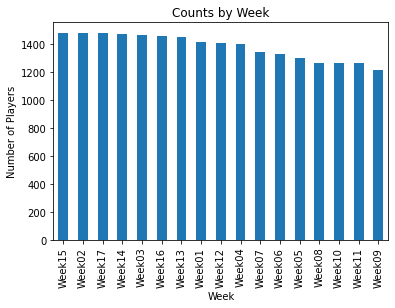

In [63]:
_ = nfl['WEEK'].value_counts().plot(kind='bar')
_ = plt.xlabel('Week')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Week')

plt.show()

#nfl.WEEK.value_counts()

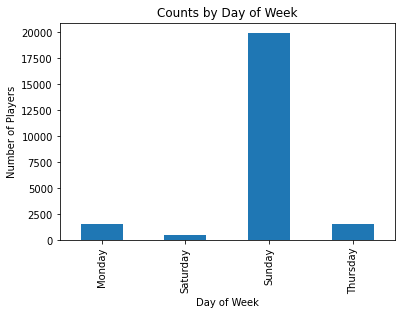

Sunday      19928
Monday       1567
Thursday     1546
Saturday      476
Name: DAY, dtype: int64

In [64]:
_ = nfl['DAY'].value_counts().sort_index().plot(kind='bar')
_ = plt.xlabel('Day of Week')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Day of Week')

plt.show()

nfl.DAY.value_counts()

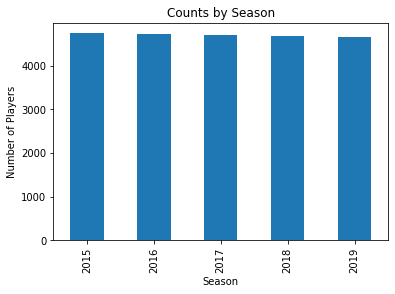

In [65]:
_ = nfl['SEASON'].value_counts().sort_index().plot(kind='bar')
_ = plt.xlabel('Season')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Season')

plt.show()

#nfl.SEASON.value_counts()

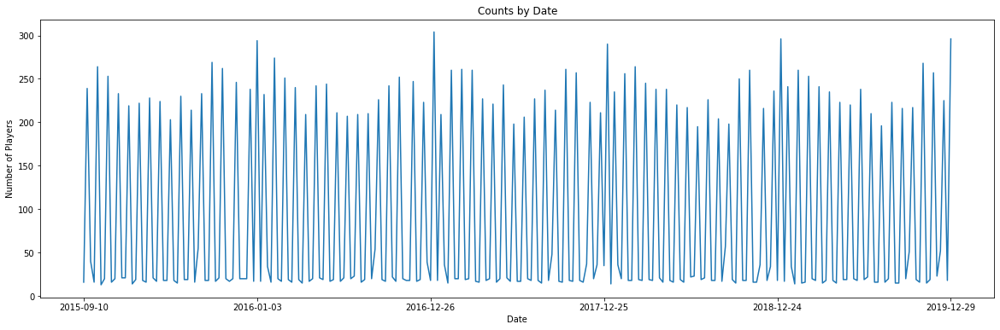

In [66]:
_ = plt.figure(figsize=(20,6))
_ = nfl['DATE'].value_counts().sort_index().plot(kind='line')
_ = plt.xlabel('Date')
_ = plt.ylabel('Number of Players')
_ = plt.title('Counts by Date')

plt.show()

#nfl.DATE.value_counts()

#### Fantasy Points

The aim of this project is to understand what determines a players fantasy performance in a given week. With this in mind, I decided to see how fanatsy performance varied by the time & date categories highlighted above.

Below shows the average number of fantasy points varies by the various different Time & Date columns. Some columns don't point to anything glaring but some highlight that there may exist an underlying seasonal trend.

* **Time:** There does not seem to be a substantial difference between the avg fantasy points scored by time of day. London is slightly lower this is likely due to small sample size.
* **Month:** Fantasy points seemed to decline slightly as went from Autumn (Sept, Oct, Nov) to Winter (Dec, Jan).
* **Week:** There is some flucuation between weeks that interesting to understand. This trend is similar to the one shown in Month.
* **Day:** Fantasy points seemed to be higher on Thursday and Saturdays. Might be interesting to see if this is true or small sample size.
* **Season:** Most seasons have similar averages around 7.4 points but 2017 season is much lower at 6.9 while 2018 is slightly higher at 7.6.
* **Date:** There is a lot of volatility in this chart but I would be intrigued to understand if there is any seasonal or other type of trend that is underlying in it.

In [67]:
#nfl.groupby('TIME')['FAN_TOT'].mean()
#nfl.groupby('MONTH')['FAN_TOT'].mean()
#nfl.groupby('Week_Number')['FAN_TOT'].mean()
#nfl.groupby('DAY')['FAN_TOT'].mean()
#nfl.groupby('SEASON')['FAN_TOT'].mean()
#nfl.groupby('DATE')['FAN_TOT'].mean()

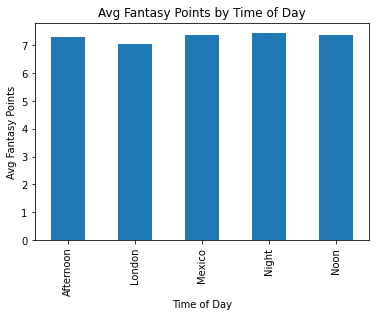

In [68]:
_ = nfl.groupby('TIME')['FAN_TOT'].mean().sort_index().plot(kind='bar')
_ = plt.xlabel('Time of Day')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Time of Day')

plt.show()

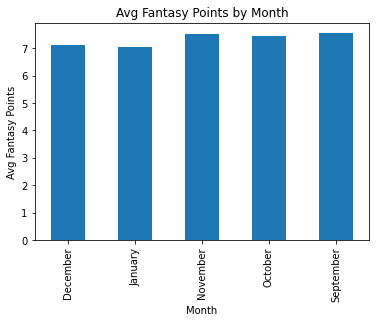

In [69]:
_ = nfl.groupby('MONTH')['FAN_TOT'].mean().sort_index().plot(kind='bar')
_ = plt.xlabel('Month')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Month')

plt.show()

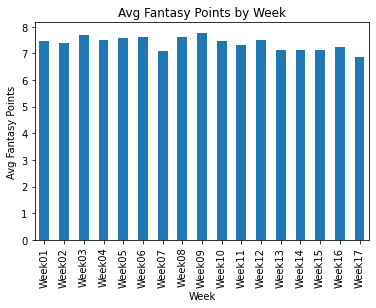

In [70]:
_ = nfl.groupby('WEEK')['FAN_TOT'].mean().sort_index().plot(kind='bar')
_ = plt.xlabel('Week')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Week')

plt.show()

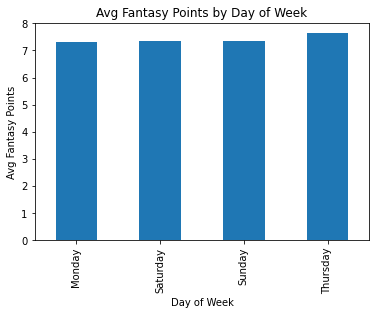

In [71]:
_ = nfl.groupby('DAY')['FAN_TOT'].mean().sort_index().plot(kind='bar')
_ = plt.xlabel('Day of Week')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Day of Week')

plt.show()

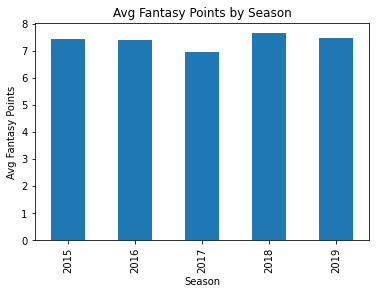

In [72]:
_ = nfl.groupby('SEASON')['FAN_TOT'].mean().sort_index().plot(kind='bar')
_ = plt.xlabel('Season')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Season')

plt.show()

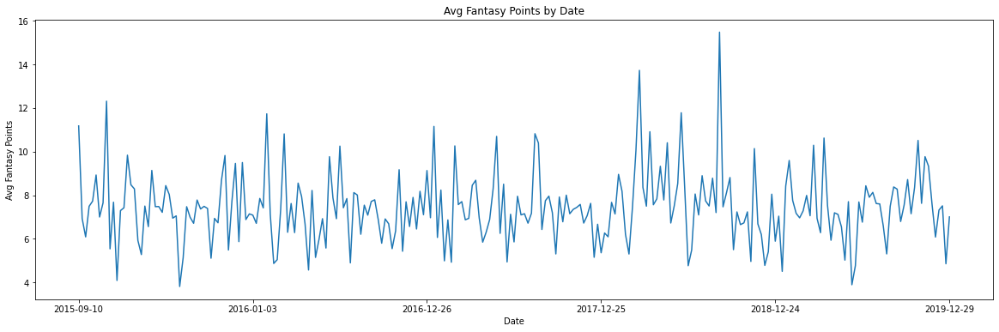

In [73]:
_ = plt.figure(figsize=(20,6))
_ = nfl.groupby('DATE')['FAN_TOT'].mean().sort_index().plot(kind='line')
_ = plt.xlabel('Date')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Date')

plt.show()

#### Week-Season Relationship

Because Season, Month and Week showed some sort of trend in the charts above, I decided to look a little bit further into this.

I focused on Season and Week (as this is a more granular version of Month) and developed the charts below. They seem to indicate that there is some sort of decline in fantasy performance in Week 7 and following Week 13 in most seasons.

In [74]:
fan_week_season = nfl.groupby(['SEASON', 'WEEK'])['FAN_TOT'].mean().sort_index().reset_index()

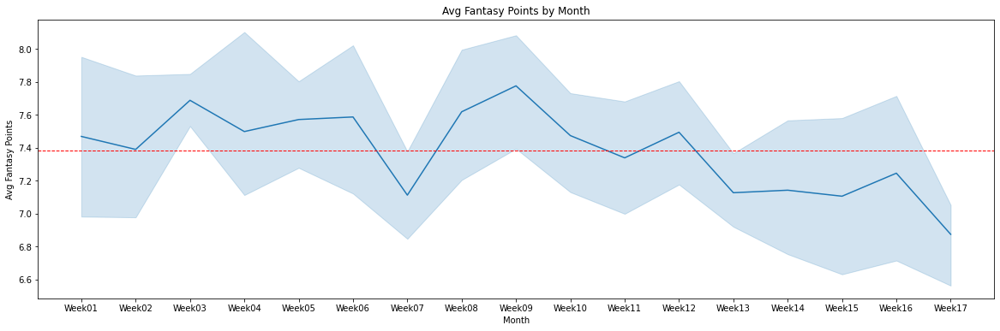

In [75]:
#x_tick_len = np.arange(len(nfl.groupby(['SEASON', 'WEEK'])['FAN_TOT'].mean().sort_index()))

_ = plt.figure(figsize=(20,6))
#_ = fan_week_season['FAN_TOT'].plot(kind='line')
_ = sns.lineplot(data=fan_week_season, x='WEEK', y='FAN_TOT')
_ = plt.axhline(fan_week_season['FAN_TOT'].mean(), color='r', linestyle='dashed', linewidth=1)
_ = plt.xlabel('Month')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Month')
#_ = plt.xticks(x_tick_len, labels=)

plt.show()

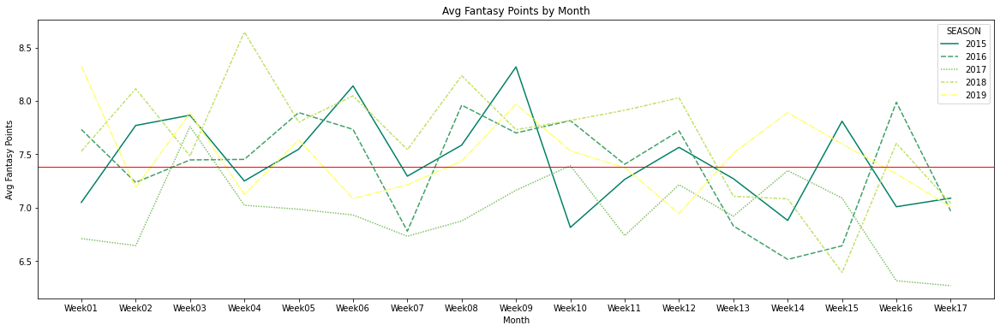

In [76]:
_ = plt.figure(figsize=(20,6))
#_ = fan_week_season['FAN_TOT'].plot(kind='line')
_ = sns.lineplot(data=fan_week_season, x='WEEK', y='FAN_TOT', hue='SEASON', style='SEASON', palette='summer')
_ = plt.axhline(fan_week_season['FAN_TOT'].mean(), color='r', linewidth=1)
_ = plt.xlabel('Month')
_ = plt.ylabel('Avg Fantasy Points')
_ = plt.title('Avg Fantasy Points by Month')
#_ = plt.xticks(x_tick_len, labels=)

plt.show()

#### Conclusions



**1.   Aggregate Time of Day:** London and Mexico are only a small portion rows (311) and therefore shouldn't account for seperate groups. Seeing as London games are usually played at 6pm GMT, the equivalent of 1pm ET, we will look to group London into 'Noon' group. Mexico games are played at night so we will group Mexico into the 'Night' group.



In [77]:
nfl['TIME'] = nfl['TIME'].str.replace('London','Noon')
nfl['TIME'] = nfl['TIME'].str.replace('Mexico','Night')

print(nfl['TIME'].unique())

['Noon' 'Afternoon' 'Night']


**2.   Binary Column for Sunday:** 85% of games are played on Sunday with only a small portion of players playing on Thursday, Saturday or Monday. For this reason, it makes to turn this column into a boolean for whether a game was played on a Sunday.

In [78]:
nfl['SUNDAY'] = np.where(nfl['DAY'] == 'Sunday', 1, 0)

print(nfl['SUNDAY'].unique())

[1 0]


**3.   Leave Week, Season and Date as is - for now:** Leave all these columns as the currently are however, it is unlikely you will keep all of them for final model. 

**4.   Modelling may require Time Series:** While not 100% clear from the graphs above, there does seem to to be a bit of seasonality in the data that may need to be accounted for. Other factors of time series will be looked at later. 

**5.   Create Order of Weeks column to support any potential Time-Series:** At the moment, it is unclear what exact time variables we will need to support our model. One additional column that may help when the time comes is an order by Week and Season - this means we would start at Week 1 in 2015 as first in this order (as this is first available in dataset) and finish at Week 17 in 2019 (last available in data set). This may give us a variable that can be inputted into a time-series model in future. This column is calculated below. 

In [79]:
fan_week_season['WEEK_SEASON_ID'] = pd.factorize(fan_week_season['WEEK']+fan_week_season['SEASON'].astype(str))[0]

#print(fan_week_season.head())
#print(fan_week_season.tail())

In [80]:
 nfl = pd.merge(nfl, fan_week_season.drop(columns=['FAN_TOT']), how='left', on=['WEEK', 'SEASON'])

In [81]:
#nfl['Week_Number'] = nfl['WEEK'].apply(lambda x: x[4:]).astype(int)
#nfl['Week Number']

### Player Name

#### Counts

There are 1,107 player names in the dataset. This ranges to 80 for some players to only 1 for others. 

The boxplot along with the mean (21) and median (13) indicate this data also suffers from right-tail with extreme outliers. There are too many unique values to do a histogram for this variable.

In [82]:
print('Number of Players = ', nfl.PLAYER_NAME.nunique())
#print(nfl.TEAM.unique())

Number of Players =  1107


In [83]:
#nfl['PLAYER_NAME'].describe()

In [84]:
print('Average Player Count = ', round(nfl['PLAYER_NAME'].value_counts().mean()))
print('Median Player Count = ', round(nfl['PLAYER_NAME'].value_counts().median()))
print('Max Player Count = ', round(nfl['PLAYER_NAME'].value_counts().max()))
print('Min Player Count = ', round(nfl['PLAYER_NAME'].value_counts().min()))

Average Player Count =  21
Median Player Count =  13
Max Player Count =  80
Min Player Count =  1


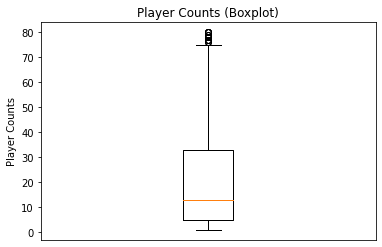

In [85]:
_ = plt.boxplot(nfl['PLAYER_NAME'].value_counts())
#_ = plt.xlabel('Total')
_ = plt.ylabel('Player Counts')
_ = plt.title('Player Counts (Boxplot)')
_ = plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False)

plt.show()

In [86]:
print('HIGHEST PLAYER COUNTS')
print(nfl['PLAYER_NAME'].value_counts().loc[lambda x : x==80])
print('')
print('LOWEST PLAYER COUNTS')
print(nfl['PLAYER_NAME'].value_counts().loc[lambda x : x==1])

HIGHEST PLAYER COUNTS
Philip Rivers       80
Russell Wilson      80
Jarvis Landry       80
Duke Johnson        80
Larry Fitzgerald    80
Name: PLAYER_NAME, dtype: int64

LOWEST PLAYER COUNTS
Paul McRoberts        1
Alexander Hollins     1
Jakob Johnson         1
Keon Hatcher          1
Cedrick Wilson        1
                     ..
Jordan Payton         1
John Ursua            1
Gehrig Dieter         1
Krishawn Hogan        1
Patrick Mahomes II    1
Name: PLAYER_NAME, Length: 95, dtype: int64


In [87]:
#_ = plt.figure(figsize=(22,6))
#_ = nfl['PLAYER_NAME'].value_counts().plot(kind='bar')
#_ = plt.xlabel('Player')
#_ = plt.ylabel('Number of Players')
#_ = plt.title('Counts by Players')

#plt.show()

#### Fantasy Points

As with the counts, there are too many unique values to do bar charts so again we have looked at a Box plot. It again show a right tail with a large number of high fantasy point performance outliers.

In [88]:
player_fan = nfl.groupby('PLAYER_NAME')['FAN_TOT'].mean().sort_values(ascending=False).reset_index()

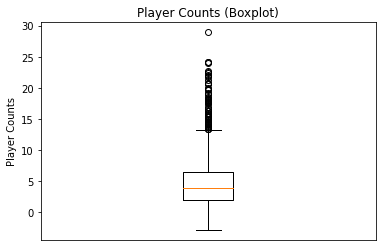

In [89]:
_ = plt.boxplot(player_fan['FAN_TOT'])
#_ = plt.xlabel('Total')
_ = plt.ylabel('Player Counts')
_ = plt.title('Player Counts (Boxplot)')
_ = plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False)

plt.show()

In [90]:

print(player_fan.head())
print('')
print(player_fan.tail())

#print('Highest Scoring Player is ', player_fan[player_fan['FAN_TOT'] == player_fan['FAN_TOT'].max()]['PLAYER_NAME'][0], 'with', round(player_fan[player_fan['FAN_TOT'] == player_fan['FAN_TOT'].max()]['FAN_TOT'][0], 2))

       PLAYER_NAME    FAN_TOT
0  Patrick Mahomes  28.920667
1      Andrew Luck  24.143684
2   Deshaun Watson  24.106316
3       Drew Brees  23.935890
4        Tom Brady  22.685789

         PLAYER_NAME  FAN_TOT
1102      Tyler Bray     -2.0
1103    Devin Hester     -2.0
1104  Denarius Moore     -2.0
1105   Kyle Lauletta     -2.2
1106   Glenn Winston     -2.8


#### Conclusion



**1.   Too many dimensions:** With over 1,100 unique values there is too many to include in the dataset as dummy variables. 

**2.   Alternative metric:** It is likely not the name but the player's previous performance that indicates how likely he is going to perform. With this in mind, we should look to tailor statistics we have about a player's previous performance and use this in the model instead of the name attribute. We will look at this in the next section.



## Player & Game Statistics

In this section, we will look at how a player's performance could be linked with their fantasy performance.

We will start by looking at a correlation heatmap below.

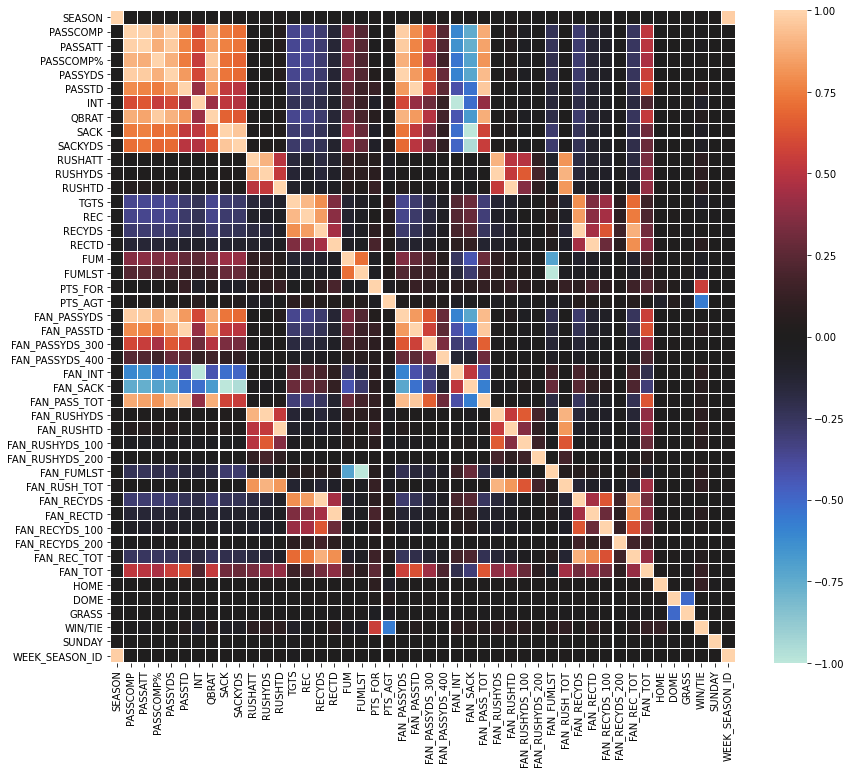

In [91]:
_ = plt.figure(figsize=(14, 12))
_ = sns.heatmap(nfl.corr(), linewidth=.1, cmap='icefire', annot=False)

plt.show()

Intially this looks postive as there are several fields that correlate with the 'FAN_TOT' that is the focus of this analysis. However, there is currently one big issue with the dataset....

There is going be strong correlation between raw stats (i.e. Rushing Yards, Receiving Yards, TDs) and fantasy stats (i.e. Fantasy Rushing points, Fantasty Receiving points, Fantasy TD points, Fantasy Total points) as they are dervived from one another.

**This means that the variables are not independent of each other.**


To further develop and gain insight from this data we will need to:

1) Tidy our data further by removing similar columns (i.e. 'RUSHYDS' and 'FAN_RUSHYDS')

2) We will need to create new columns that provide us with a player's performance in the weeks before the game - not during it. We will do this by creating rolling averages.

### Removing Fantasy Columns

We will remove a number of Fantasy related columns that are directly tied and with each player's actual statistics. For this step we could have removed either the actual or fantasy stats but choose to go with the later.

In [92]:
fantasy_columns_drop = ['FAN_PASSYDS', 'FAN_PASSTD', 'FAN_INT', 'FAN_SACK', 'FAN_PASS_TOT', 'FAN_RUSHYDS', 'FAN_RUSHTD', 'FAN_FUMLST', 'FAN_RUSH_TOT', 'FAN_RECYDS', 'FAN_RECTD', 'FAN_REC_TOT']
nfl = nfl.drop(fantasy_columns_drop, axis=1)

In [93]:
nfl.columns
nfl.shape

(23517, 53)

This reduces the columns of the data set. Next, we will look to shorten a couple of the column names.

In [94]:
new_column_names = {'FAN_PASSYDS_300':'PASSYDS_300',
                    'FAN_PASSYDS_400':'PASSYDS_400',
                    'FAN_RUSHYDS_100':'RUSHYDS_100',
                    'FAN_RUSHYDS_200':'RUSHYDS_200', 
                    'FAN_RECYDS_100':'RECYDS_100', 
                    'FAN_RECYDS_200':'RECYDS_200'}

In [95]:
nfl.rename(columns=new_column_names, inplace=True)
#nfl_skill.columns

### Two Datasets

In the upcoming sections, we are going to create rolling averages for every player record in our dataset to gain an understanding of how their prior performance relates to how they perform in fantasy in a given week.

As part of this process, we will be deleting a number of columns relating to the raw stats for given week. While we think this important to support the analysis, this data could still be useful and therefore we will split our data into two datasets:


*   **nfl_rolling** - including columns relating to rolling averages for previous weeks
*   **nfl_actual** - including columns realting to nfl stats for a given week



In [96]:
nfl_rolling = nfl
nfl_actual = nfl

### Rolling Averages


As mentioned, we want to calculate rolling average for each player statistics for the weeks leading into game as we believe this could be a good indicator of player's fantasy peformance in a given week.

We will start off by calculating this for the 'FAN_TOT' column and then apply to all other relavent fields.

#### Fantasy Points

I want to create rolling average for the 'FAN_TOT' column that will allow me to use the previous 4-week average of 'FAN_TOT' as potential indicator of upcoming performance.

4-weeks is artbitrary number selected for this analysis but depending on the success of the later model, this could potentially be hypertuned to decide which period is the best rolling average or if a weighted average would work better.

**1.   Format & Sort Date**

Realised that the 'DATE' field is not in a date format so I need to change this.

Following this, I sorted the dataset by 'DATE' so that future calculations for rolling averages are done in the correct order.

In [97]:
nfl_rolling['DATE'] = pd.to_datetime(nfl_rolling['DATE'])

In [98]:
#nfl_rolling.info()

In [99]:
nfl_rolling.sort_values(by='DATE', ascending=True, inplace=True)

**2.   Create Rolling Average**

Below code is used to create a 4 week rolling average for Fantasy Points scored by each player. The code following is a spot check to see if column was created as expected.

In [100]:
nfl_rolling['FAN_4WK_AVG'] = nfl_rolling.groupby('PLAYER_NAME')['FAN_TOT'].transform(lambda x: x.rolling(4, 1).mean())

In [101]:
#nfl_rolling[nfl_rolling['PLAYER_NAME']=='Calvin Ridley'][['PLAYER_NAME', 'DATE', 'FAN_TOT', 'FAN_4WK_AVG']]

**3.   Shift Data**

Now I want to move this 4 week average from previous game week to this week to understand how a players fantasy performance in the past three weeks corresponds to his performance in that week. The code following is a spot check to see if column was created as expected.

In [102]:
nfl_rolling['FAN_4WK_AVG_SHIFT'] = nfl_rolling.groupby('PLAYER_NAME')['FAN_4WK_AVG'].shift()

In [103]:
#nfl_rolling[nfl_rolling['PLAYER_NAME']=='Adrian Peterson'][['PLAYER_NAME', 'DATE', 'FAN_TOT', 'FAN_4WK_AVG', 'FAN_4WK_AVG_SHIFT']]

#### Other Player Statistics

Next I want to create rolling averages for each of the main raw stats available, namely:

* 'PASSCOMP' 
* 'PASSATT' 
* 'PASSCOMP%' 
* 'PASSYDS' 
* 'PASSTD' 
* 'INT'
* 'QBRAT'
* 'SACK' 
* 'SACKYDS'
* 'RUSHATT'
* 'RUSHYDS'
* 'RUSHTD'
* 'TGTS'
* 'REC'
* 'RECYDS'
* 'RECTDS'
* 'FUM'
* 'FUMLST'
* 'PASSYDS_300'
* 'PASSYDS_400'
* 'RUSHYDS_100'
* 'RUSHYDS_200'
* 'RECYDS_100'
* 'RECYDS_200'

When creating the code for the Fantasy Points rolling averages with a shift, there was a realisation that these exact same steps could be repeated for each columns above. With this in mind, I started by looking to define a function to run create these rolling averages with a shift.

In [104]:
#nfl_rolling.columns

In [105]:
def rolling_cols(col, rolling_col, shift_col):
  nfl_rolling.sort_values(by='DATE', ascending=True, inplace=True)
  nfl_rolling[rolling_col] = nfl_rolling.groupby('PLAYER_NAME')[col].transform(lambda x: x.rolling(4, 1).mean())
  nfl_rolling[shift_col] = nfl_rolling.groupby('PLAYER_NAME')[rolling_col].shift()

Next, I applied this function to the columns I wanted to create rolling averages with a shift.

In [106]:
rolling_cols('PASSCOMP', 'PASSCOMP_4WK_AVG', 'PASSCOMP_4WK_AVG_SHIFT')
rolling_cols('PASSATT', 'PASSATT_4WK_AVG', 'PASSATT_4WK_AVG_SHIFT')
rolling_cols('PASSCOMP%', 'PASSCOMP%_4WK_AVG', 'PASSCOMP%_4WK_AVG_SHIFT')
rolling_cols('PASSYDS', 'PASSYDS_4WK_AVG', 'PASSYDS_4WK_AVG_SHIFT')
rolling_cols('PASSTD', 'PASSTD_4WK_AVG', 'PASSTD_4WK_AVG_SHIFT')
rolling_cols('INT', 'INT_4WK_AVG', 'INT_4WK_AVG_SHIFT')
rolling_cols('QBRAT', 'QBRAT_4WK_AVG', 'QBRAT_4WK_AVG_SHIFT')
rolling_cols('SACK', 'SACK_4WK_AVG', 'SACK_4WK_AVG_SHIFT')
rolling_cols('SACKYDS', 'SACKYDS_4WK_AVG', 'SACKYDS_4WK_AVG_SHIFT')
rolling_cols('PASSYDS_300', 'PASSYDS_300_4WK_AVG', 'PASSYDS_300_4WK_AVG_SHIFT')
rolling_cols('PASSYDS_400', 'PASSYDS_400_4WK_AVG', 'PASSYDS_400_4WK_AVG_SHIFT')

In [107]:
rolling_cols('RUSHATT', 'RUSHATT_4WK_AVG', 'RUSHATT_4WK_AVG_SHIFT')
rolling_cols('RUSHYDS', 'RUSHYDS_4WK_AVG', 'RUSHYDS_4WK_AVG_SHIFT')
rolling_cols('RUSHTD', 'RUSHTD_4WK_AVG', 'RUSHTD_4WK_AVG_SHIFT')
rolling_cols('FUM', 'FUM_4WK_AVG', 'FUM_4WK_AVG_SHIFT')
rolling_cols('FUMLST', 'FUMLST_4WK_AVG', 'FUMLST_4WK_AVG_SHIFT')
rolling_cols('RUSHYDS_100', 'RUSHYDS_100_4WK_AVG', 'RUSHYDS_100_4WK_AVG_SHIFT')
rolling_cols('RUSHYDS_200', 'RUSHYDS_200_4WK_AVG', 'RUSHYDS_200_4WK_AVG_SHIFT')

In [108]:
rolling_cols('TGTS', 'TGTS_4WK_AVG', 'TGTS_4WK_AVG_SHIFT')
rolling_cols('REC', 'REC_4WK_AVG', 'REC_4WK_AVG_SHIFT')
rolling_cols('RECYDS', 'RECYDS_4WK_AVG', 'RECYDS_4WK_AVG_SHIFT')
rolling_cols('RECTD', 'RECTD_4WK_AVG', 'RECTD_4WK_AVG_SHIFT')
rolling_cols('RECYDS_100', 'RECYDS_100_4WK_AVG', 'RECYDS_100_4WK_AVG_SHIFT')
rolling_cols('RECYDS_200', 'RECYDS_200_4WK_AVG', 'RECYDS_200_4WK_AVG_SHIFT')

In [109]:
nfl_rolling.sample(10)
nfl_rolling.shape

(23517, 103)

#### Game Statistics

There are three game related statistics in the data set that we would like to include:
* 'PTS_FOR'
* 'PTS_AGT'
* 'WIN/TIE'

These data points could be very useful as they could help allieviate an issue we identified when reviewing data earlier. 

**1.  Substitute for Team & Coach Columns**

Earlier, we also looked at each Team, Head Coach and relevant Coordinator (for both the team playing for as well as the opponent) to see how fantasy performance differed across each of these areas. The information seemed useful in that certain teams and coaches clearly performed better than others and therefore would interesting to included in our model going forward. 

However, the issue with each of these columns is dimensions - and transforming one of these columns (not to mention if we did all of them) into dummy variables before modelling would lead to the data becoming very sparse and maybe make the model less powerful.

The ideal solution would be to somehow keep this information but in fewer columns. With this in mind, I believe that the information above on Points For and Against will give us the required information on how a Team's Offense and Defense is performing. While these metrics are likely very highly influenced by the Coaches and Team, the numbers themselves will likely be more useful and help model peformance.

**2.  Need for independence**

The only issue is that the data the way it is currently represented in the data will not work. As mentioned when reviewing the 'W/L' column earlier, while there seems to be a relationship between getting a win or tie in game and a higher fantasy scoring, there are two problems with using this data for our analysis:


*   Fantasy owners don't know the result of the game before it happens (even though they think they might!)
*   The two events are not independent of each other - a player having a high scoring fantasy game is likely an important reason as too why they won, and visa versa

These same issues apply for Points For and Points Against.

Based on this, I will apply a similar rolling averages with a shift to to the game point totals (for & against) and the Win/Tie result column to see if these could be a useful indicator of how a fantasy player will perform as well as allieviating the issues mentioned above.

To do this, we will have to wrangle the data and make some slight adjustments to the rolling average code to make sure this is calculated correctly. This is done in the code below.

In [110]:
team_performance = nfl_rolling.groupby(by=['TEAM', 'DATE', 'WEEK_SEASON_ID'])['PTS_FOR', 'PTS_AGT', 'WIN/TIE'].mean().reset_index()
#team_performance.head(20)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [111]:
def rolling_cols_team(col, rolling_col, shift_col):
  team_performance.sort_values(by='DATE', ascending=True, inplace=True)
  team_performance[rolling_col] = team_performance.groupby('TEAM')[col].transform(lambda x: x.rolling(4, 1).mean())
  team_performance[shift_col] = team_performance.groupby('TEAM')[rolling_col].shift()

In [112]:
rolling_cols_team('PTS_FOR', 'PTS_FOR_4WK_AVG', 'PTS_FOR_4WK_AVG_SHIFT')
rolling_cols_team('PTS_AGT', 'PTS_AGT_4WK_AVG', 'PTS_AGT_4WK_AVG_SHIFT')
rolling_cols_team('WIN/TIE', 'WIN/TIE_4WK_AVG', 'WIN/TIE_4WK_AVG_SHIFT')

In [113]:
#team_performance.loc[team_performance['TEAM'] == 'Lions'].tail(20)

In [114]:
#list(team_performance.columns)

In [115]:
team_col_drop = ['PTS_FOR', 'PTS_AGT','WIN/TIE', 'PTS_FOR_4WK_AVG', 'PTS_AGT_4WK_AVG','WIN/TIE_4WK_AVG']

In [116]:
team_performance = team_performance.drop(team_col_drop, axis=1)

In [117]:
team_col_names = {'PTS_FOR_4WK_AVG_SHIFT':'PTS_FOR_AVG',
                  'PTS_AGT_4WK_AVG_SHIFT':'PTS_AGT_AVG',
                  'WIN/TIE_4WK_AVG_SHIFT':'WIN/TIE_AVG' }

In [118]:
team_performance.rename(columns=team_col_names, inplace=True)

In [119]:
nfl_rolling = pd.merge(nfl_rolling, team_performance, how='left', on=['TEAM', 'DATE', 'WEEK_SEASON_ID'])

**Opposition Points For, Points Against, and Win/Tie Rate**

The above code has now given us the rolling 4-week average with a shift for Points For, Points Against and Win/Tie Rate for each player's team in the dataset. This will allow us to remove the TEAM, HC, OC, and DC from the dataset and allow us to reduce the potential number of dimensions in our dataset. However, this leaves us with one gap in relation to the Opponent's performance and how this may influences a player's fantasy performance. 

Based on what we have done for each player's team, this data can be slightly manipulated and merged to our nfl_rolling dataset to give us the Points For, Points Against, and Win/Tie Rate 4-week rolling average (with a shift) for the opponent of each player in each week. This will also allow us to remove the OPP, OPP_HC, OPP_OC, and OPP_DC from the dataset - again reducing the potential number of columns in our dataset needed for modelling. The code to make these changes is below.

In [120]:
opp_performance = team_performance
#opp_performance.tail()
#opp_performance.loc[:, '49ers']

In [121]:
opp_team_col_names = {'TEAM':'OPP',
                      'PTS_FOR_AVG':'OPP_PTS_FOR_AVG',
                      'PTS_AGT_AVG':'OPP_PTS_AGT_AVG',
                      'WIN/TIE_AVG':'OPP_WIN/TIE_AVG' }

In [122]:
opp_performance.rename(columns=opp_team_col_names, inplace=True)

In [123]:
nfl_rolling = pd.merge(nfl_rolling, opp_performance, how='left', on=['OPP', 'DATE', 'WEEK_SEASON_ID'])

In [124]:
#nfl_rolling.head()

## Tidying the Data

### Removing Unnecessary Columns

After the creation of the columns we have 108! This is too many and although a lot of the columns have helped us shape the data they are no longer necessary

The next steps are to remove the variables we no longer need.

In [125]:
nfl_rolling.shape

(23517, 109)

**1.   Remove Raw Stats**

I will remove the raw stats used to calculate rolling averages. This brings are columns down to 81.

(Remember: We still have the nfl_actual dataframe if we need to reference this data at a later stage)

In [126]:
#print(list(nfl_rolling.columns))

In [127]:
raw_stat_list = ['PASSCOMP', 'PASSATT', 'PASSCOMP%', 'PASSYDS', 'PASSTD', 'INT', 'QBRAT', 'SACK', 'SACKYDS', 'RUSHATT', 'RUSHYDS', 'RUSHTD', 'TGTS', 'REC', 'RECYDS', 'RECTD', 'FUM', 'FUMLST', 'PTS_FOR', 'PTS_AGT', 'PASSYDS_300', 'PASSYDS_400', 'RUSHYDS_100', 'RUSHYDS_200', 'RECYDS_100', 'RECYDS_200', 'WIN/TIE']
nfl_rolling = nfl_rolling.drop(raw_stat_list, axis=1)

In [128]:
nfl_rolling.shape

(23517, 82)

**2.   Remove Rolling Averages (before shift)**

I will remove the rollling averages before the shift. This brings the columns down to 56.

In [129]:
#print(list(nfl_rolling.columns))

In [130]:
avg_4wk_list = ['PASSCOMP_4WK_AVG', 'PASSATT_4WK_AVG', 'PASSCOMP%_4WK_AVG', 'PASSYDS_4WK_AVG', 'PASSTD_4WK_AVG', 'INT_4WK_AVG', 'QBRAT_4WK_AVG', 'SACK_4WK_AVG', 'SACKYDS_4WK_AVG', 'RUSHATT_4WK_AVG', 'RUSHYDS_4WK_AVG', 'RUSHTD_4WK_AVG', 'TGTS_4WK_AVG', 'REC_4WK_AVG', 'RECYDS_4WK_AVG', 'RECTD_4WK_AVG', 'FUM_4WK_AVG', 'FUMLST_4WK_AVG', 'PASSYDS_300_4WK_AVG', 'PASSYDS_400_4WK_AVG', 'RUSHYDS_100_4WK_AVG', 'RUSHYDS_200_4WK_AVG', 'RECYDS_100_4WK_AVG', 'RECYDS_200_4WK_AVG', 'FAN_4WK_AVG']

nfl_rolling = nfl_rolling.drop(avg_4wk_list, axis=1)

In [131]:
nfl_rolling.shape

(23517, 57)

**3.   Remove Categorical Variables**

I will remove the categorical variables that are no longer required based on the changes to the data so far. This brings the columns down to 45.

I will continue to keep columns such as 'PLAYER_NAME', 'TEAM', 'OPP' in the dataset to keep in more interpretable but these are unlikely to be used come to later modelling. I will also continue to include the majority of Time/Date fields until a decision is needed as to how to best incorporate in the model.

In [132]:
catvar_list = ['H/A', 'HC', 'OC', 'DC', 'OPP HC', 'OPP OC', 'OPP DC', 'DAY', 'W/L', 'ROOF', 'SURFACE']

nfl_rolling = nfl_rolling.drop(catvar_list, axis=1)

In [133]:
nfl_rolling.shape

(23517, 46)

**4.   Rename Columns**

Lastly, I'm going to rename the columns to make them easier to call going forward.

In [134]:
#print(list(nfl_rolling.columns))

In [135]:
new_column_names_2 = {'PASSCOMP_4WK_AVG_SHIFT':'PASSCOMP_AVG', 
                      'PASSATT_4WK_AVG_SHIFT':'PASSATT_AVG', 
                      'PASSCOMP%_4WK_AVG_SHIFT':'PASSCOMP%_AVG', 
                      'PASSYDS_4WK_AVG_SHIFT':'PASSYDS_AVG', 
                      'PASSTD_4WK_AVG_SHIFT':'PASSTD_AVG', 
                      'INT_4WK_AVG_SHIFT':'INT_AVG', 
                      'QBRAT_4WK_AVG_SHIFT':'QBRAT_AVG', 
                      'SACK_4WK_AVG_SHIFT':'SACK_AVG', 
                      'SACKYDS_4WK_AVG_SHIFT':'SACKYDS_AVG', 
                      'RUSHATT_4WK_AVG_SHIFT':'RUSHATT_AVG', 
                      'RUSHYDS_4WK_AVG_SHIFT':'RUSHYDS_AVG', 
                      'RUSHTD_4WK_AVG_SHIFT':'RUSHTD_AVG', 
                      'TGTS_4WK_AVG_SHIFT':'TGTS_AVG', 
                      'REC_4WK_AVG_SHIFT':'REC_AVG', 
                      'RECYDS_4WK_AVG_SHIFT':'RECYDS_AVG', 
                      'RECTD_4WK_AVG_SHIFT':'RECTD_AVG', 
                      'FUM_4WK_AVG_SHIFT':'FUM_AVG', 
                      'FUMLST_4WK_AVG_SHIFT':'FUMLST_AVG',  
                      'PASSYDS_300_4WK_AVG_SHIFT':'PASSYDS_300_AVG', 
                      'PASSYDS_400_4WK_AVG_SHIFT':'PASSYDS_400_AVG', 
                      'RUSHYDS_100_4WK_AVG_SHIFT':'RUSHYDS_100_AVG', 
                      'RUSHYDS_200_4WK_AVG_SHIFT':'RUSHYDS_200_AVG', 
                      'RECYDS_100_4WK_AVG_SHIFT':'RECYDS_100_AVG', 
                      'RECYDS_200_4WK_AVG_SHIFT':'RECYDS_200_AVG', 
                      'FAN_TOT':'FAN_ACTUAL', 
                      'FAN_4WK_AVG_SHIFT':'FAN_AVG',
                      'PLAYER_NAME':'PLAYER' 
                   }

In [136]:
nfl_rolling.rename(columns=new_column_names_2, inplace=True)

In [137]:
#nfl_rolling.columns

In [138]:
#nfl_rolling.info()

In [139]:
nfl_rolling.shape

(23517, 46)

### NaN values

Because we created rolling averages with a shift, it has meant that the dataset now contains NaN values - 28,338 cells or 2.7% of the dataset. 

In [140]:
total_cells = np.product(nfl_rolling.shape)
total_missing = nfl_rolling.isna().sum().sum()

# percent of data that is missing
missing_percent = (total_missing/total_cells) * 100

print('Missing Cells = ', total_missing)
print('Missing Percent = ', missing_percent)

Missing Cells =  29445
Missing Percent =  2.721897757588867


In [141]:
#nfl_rolling.info()

#### Options

There are a couple of options in how we could handle these values:

**1) Drop these values:** In a real life situation, we would have no information on a player's previous performance (as they would have not played a game) and therefore have no information to project performance from.

**2) Replace with zero:** Assume that player not playing means he has not played and therefore his previous performance is 0.

**3) Replace with estimate:** Look to replace these values with an estimate (i.e. historic average performance of players in their first week playing)

Before deciding on the best approach, I would like to investigate the NaN further to decide on best approach.


#### Investigate

From the below, we can see that it is our new rolling average columns that are creating the issue with missing data - this was expected because these could not be calculated until a player played at least one game.

The next logic step was to look to see if this issue was more prounounced early in the dataset when we were less likely to have data - specifically the first week where we would have had no historic data. The bar chart below clearly shows that this is the worst week for missing data with 295 rows missing data for the average fantasy point field. This gradually declines as the year progresses and there are less new players entering the data set. The numbers rise again at the start of each season as there are new players entering the league but nowhere near the levels of the very first week. The analysis also shows that for Team / Game metrics, it is only the first week of data set that is impacted.

In [142]:
nfl_rolling.isna().sum()

TEAM                  0
OPP                   0
DATE                  0
SEASON                0
WEEK                  0
MONTH                 0
TIME                  0
POS                   0
PLAYER                0
FAN_ACTUAL            0
HOME                  0
DOME                  0
GRASS                 0
SUNDAY                0
WEEK_SEASON_ID        0
FAN_AVG            1107
PASSCOMP_AVG       1107
PASSATT_AVG        1107
PASSCOMP%_AVG      1107
PASSYDS_AVG        1107
PASSTD_AVG         1107
INT_AVG            1107
QBRAT_AVG          1107
SACK_AVG           1107
SACKYDS_AVG        1107
PASSYDS_300_AVG    1107
PASSYDS_400_AVG    1107
RUSHATT_AVG        1107
RUSHYDS_AVG        1107
RUSHTD_AVG         1107
FUM_AVG            1107
FUMLST_AVG         1107
RUSHYDS_100_AVG    1107
RUSHYDS_200_AVG    1107
TGTS_AVG           1107
REC_AVG            1107
RECYDS_AVG         1107
RECTD_AVG          1107
RECYDS_100_AVG     1107
RECYDS_200_AVG     1107
PTS_FOR_AVG         295
PTS_AGT_AVG     

In [143]:
nan_count = []

for week in nfl_rolling['WEEK_SEASON_ID'].unique():
  nans = nfl_rolling[nfl_rolling['WEEK_SEASON_ID'] == week]['FAN_AVG'].isna().sum()
  nan_count.append(nans)


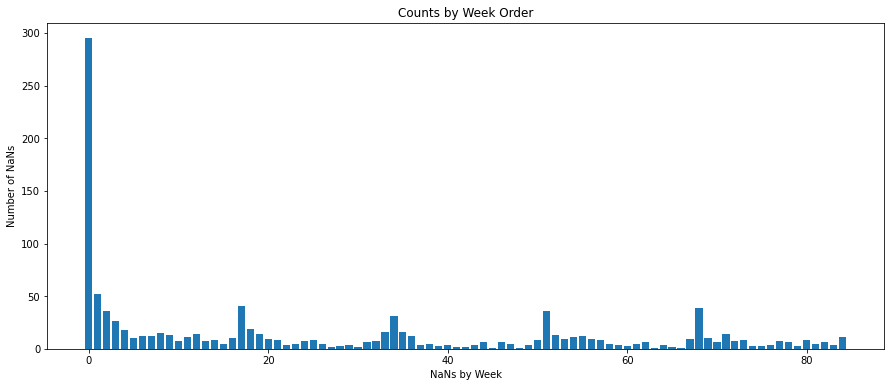

In [144]:
_ = plt.figure(figsize=(15,6))
_ = plt.bar(nfl_rolling['WEEK_SEASON_ID'].unique() ,nan_count)
_ = plt.xlabel('NaNs by Week')
_ = plt.ylabel('Number of NaNs')
_ = plt.title('Counts by Week Order')

plt.show()

In [145]:
nan_score_count = []

for week in nfl_rolling['WEEK_SEASON_ID'].unique():
  nans = nfl_rolling[nfl_rolling['WEEK_SEASON_ID'] == week]['PTS_FOR_AVG'].isna().sum()
  nan_score_count.append(nans)

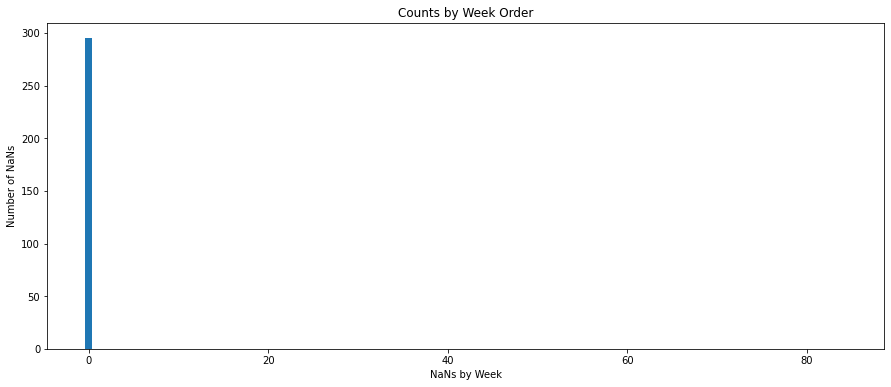

In [146]:
_ = plt.figure(figsize=(15,6))
_ = plt.bar(nfl_rolling['WEEK_SEASON_ID'].unique() ,nan_score_count)
_ = plt.xlabel('NaNs by Week')
_ = plt.ylabel('Number of NaNs')
_ = plt.title('Counts by Week Order')

plt.show()

In [147]:
#for col in nfl_rolling.columns:
#  week0_nan = nfl_rolling[nfl_rolling['WEEK_SEASON_ID'] == 0][col].isna().sum()
#  print(col, ' = ', week0_nan)

In [148]:
#import missingno as msno
#import matplotlib.pyplot as plt

# Visualize missingness
#msno.matrix(nfl_rolling)
#plt.show()

#### Conclusion

While the investigation above highlights that the issue is mainly in the first week of the dataset, I'm cautious to to make any assumptions about data in later weeks (i.e. put to zero or use average) due to the impact this might have on the results of our modelling in the future.

So with this in mind, I will **drop all rows that contain a missing value**. This will reduce the rows in the data set by 1,107 or 4.7%.

For the future and to enhance how we handle missing data with this data set in the future, I would need to run an analysis to understand the best assumptions for:



*   First week of dataset (where we are assuming a player or team stats exist but not available in data set)
*   All other weeks of dataset (where we are assuming a player is making his debut and no stats exist yet for player)



In [149]:
nfl_rolling.shape

(23517, 46)

In [150]:
nfl_rolling = nfl_rolling.dropna()

In [151]:
nfl_rolling.shape

(22410, 46)

## Correlation

We started the last section by looking at the correlation between different variables in out dataset before realising that adjustments to the dataset would be needed to gain a greater insight into our target variable of fantasy performance. With the data updated, we can once again look at the correlation to see if these updated columns have any relationship with fantasy performance.

We will begin with a correlation heatmap and pairplot to understand these relationships, before looking at them in more detail in the sub-sections after.

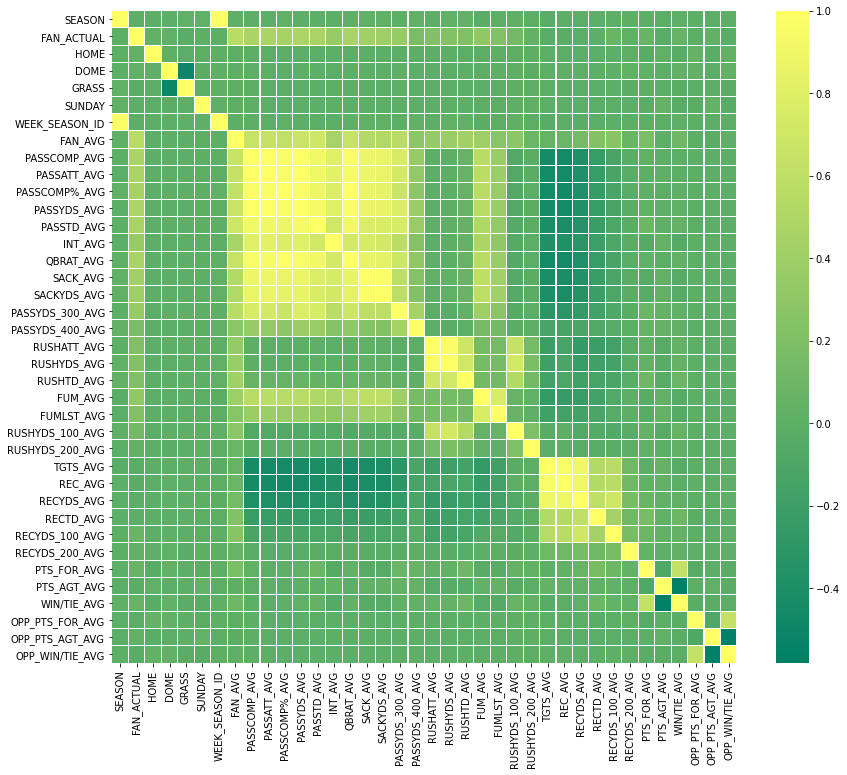

In [152]:
_ = plt.figure(figsize=(14, 12))
_ = sns.heatmap(nfl_rolling.corr(), linewidth=.1, cmap='summer', annot=False)

plt.show()

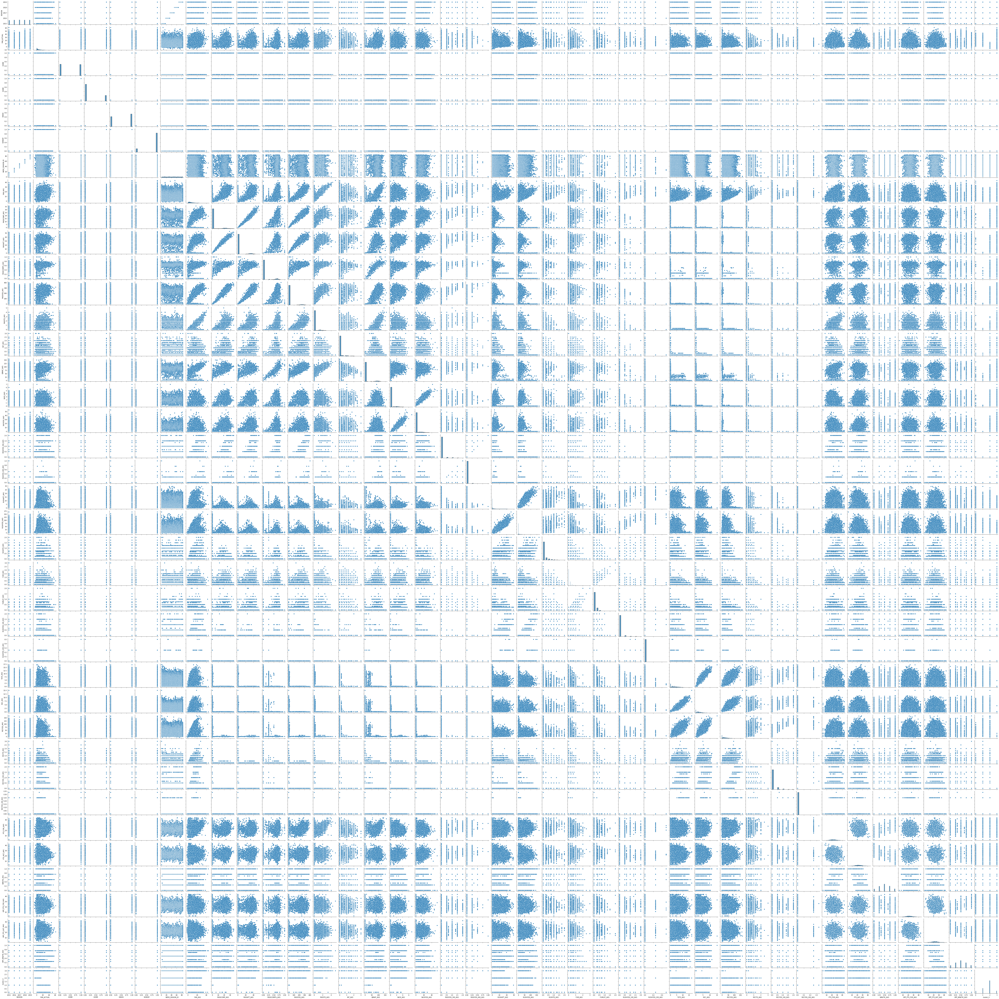

In [231]:
_ = sns.pairplot(nfl_rolling,  palette='Set1')
plt.show()

### Fantasy Actual & Fantasy Rolling Average

Our variable of interest is 'FAN_ACTUAL' and the above heatmap shows that there seems to be a few correlations of interest, with 'FAN_AVG' being the strongest. Let's dig into this one a bit more before looking at other variables.

The correlation between the columns seems strong with **correlation coefficient of 0.55.**

Following this, the joint plot shows this positive relationship - as well as showing the right-tail distribution of both columns.

In [154]:
print(np.corrcoef(nfl_rolling['FAN_ACTUAL'], nfl_rolling['FAN_AVG'])[0, 1])

0.5577320701206946


In [155]:
#scipy.stats.pearsonr(nfl_rolling['FAN_ACTUAL'], nfl_rolling['FAN_AVG'])

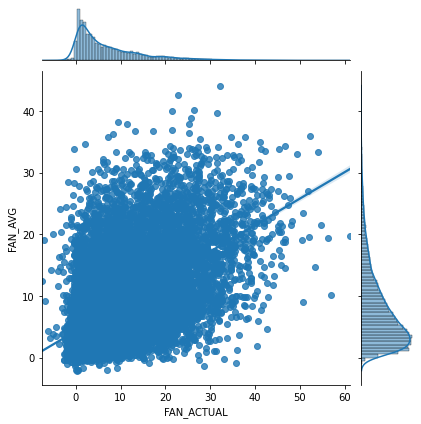

In [156]:
_ = sns.jointplot(x='FAN_ACTUAL', y='FAN_AVG', data=nfl_rolling, kind="reg")
plt.show()

#### By Categorical Variables

Seeing as this is a relationship we would like to examine further, it would be good to see if the relationship is altered at all by some of the categorical columns we looked at earlier.

In [157]:
#nfl_rolling.columns

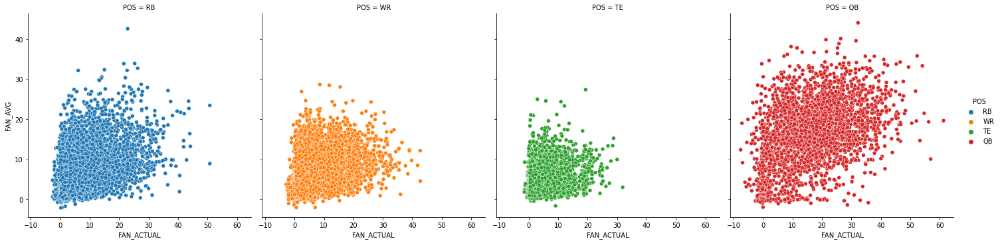

In [158]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='POS', col='POS')
plt.show()

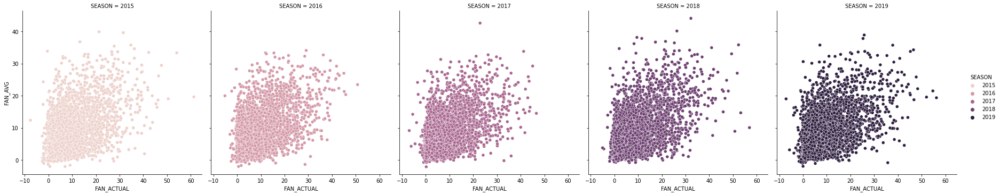

In [159]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='SEASON', col='SEASON')
plt.show()

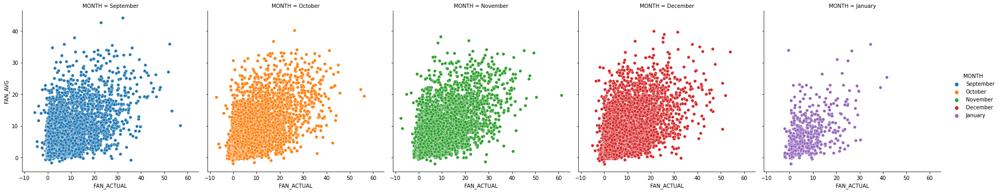

In [160]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='MONTH', col='MONTH')
plt.show()

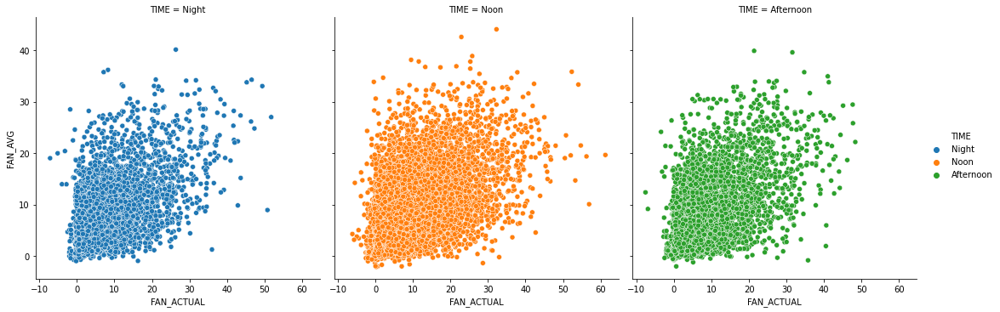

In [161]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='TIME', col='TIME')
plt.show()

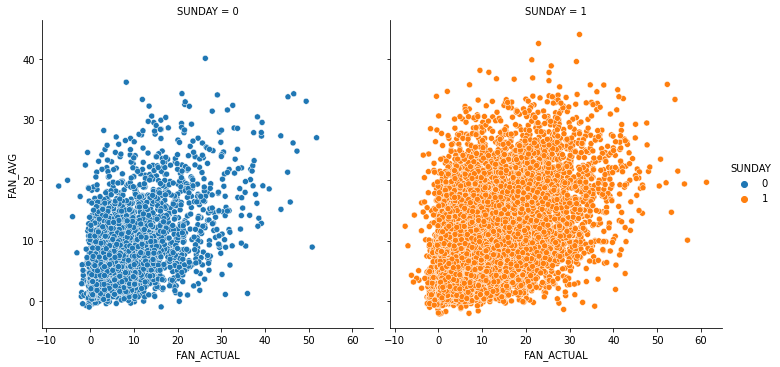

In [162]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='SUNDAY', col='SUNDAY')
plt.show()

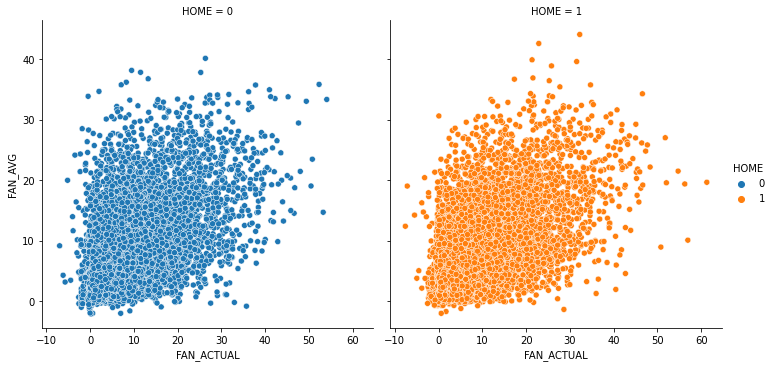

In [163]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='HOME', col='HOME')
plt.show()

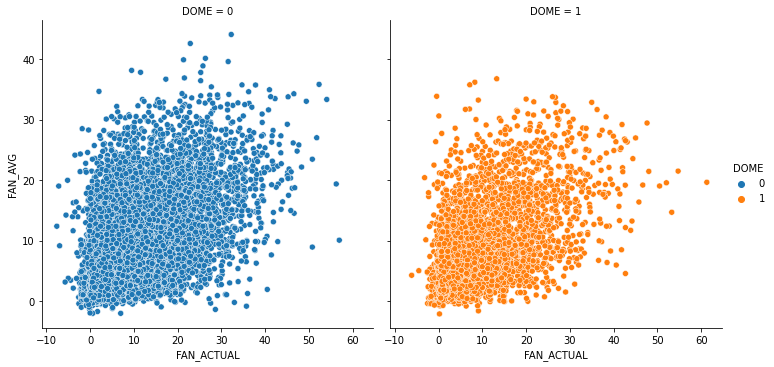

In [164]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='DOME', col='DOME')
plt.show()

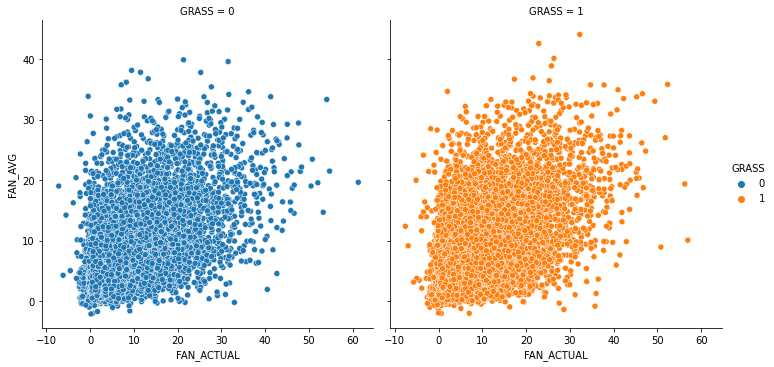

In [165]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='GRASS', col='GRASS')
plt.show()

### Fantasy Actual & Fantasy Rolling Average (By Position)

Out of the categorical variables analysed above, 'POS' looks the most interesting due the slightly different distribution between QB data and the rest of the positions.

When we look at the correlations by each individual position, it shows a moderate correlation between the previous 4-week average fantasy points for player and there upcoming performance, with this performance being strongest in RBs (at 0.48) - which is below the overall correlation coefficient of 0.55.

In the next sub-sections, we will look at each position in more detail to see if any of the other columns have a similar or better correlation than 'FAN_AVG'.

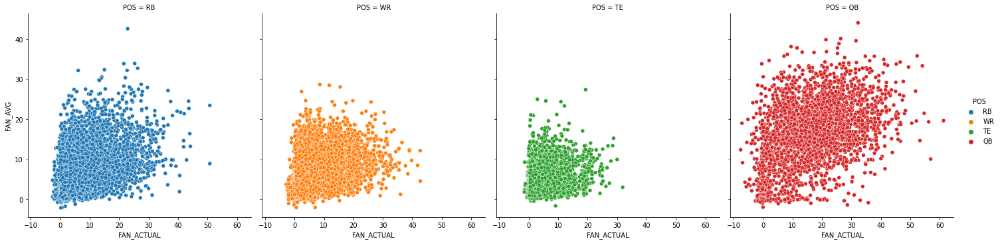

In [166]:
_ = sns.relplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='POS', col='POS')
plt.show()

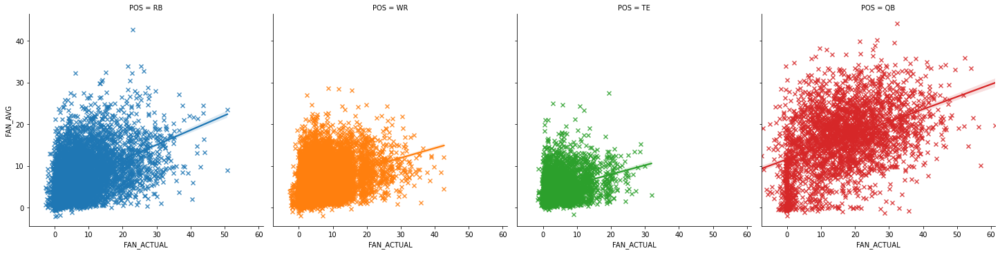

In [167]:
_ = sns.lmplot(data=nfl_rolling, x='FAN_ACTUAL', y='FAN_AVG', hue='POS', col='POS', markers='x')
plt.show()

In [168]:
print('QB: ' + str(round(np.corrcoef(nfl_rolling[nfl_rolling['POS']=='QB']['FAN_ACTUAL'], nfl_rolling[nfl_rolling['POS']=='QB']['FAN_AVG'])[0, 1], 2)))
print('RB: ' + str(round(np.corrcoef(nfl_rolling[nfl_rolling['POS']=='RB']['FAN_ACTUAL'], nfl_rolling[nfl_rolling['POS']=='RB']['FAN_AVG'])[0, 1], 2)))
print('WR: ' + str(round(np.corrcoef(nfl_rolling[nfl_rolling['POS']=='WR']['FAN_ACTUAL'], nfl_rolling[nfl_rolling['POS']=='WR']['FAN_AVG'])[0, 1], 2)))
print('TE: ' + str(round(np.corrcoef(nfl_rolling[nfl_rolling['POS']=='TE']['FAN_ACTUAL'], nfl_rolling[nfl_rolling['POS']=='TE']['FAN_AVG'])[0, 1], 2)))

QB: 0.43
RB: 0.48
WR: 0.35
TE: 0.32


#### QB Analysis

This QB-specific analysis of correlation shows that the 4-week rolling average for Fantasy points has the highest correlation. This is followed by a number of Passing statistics with Passing Yards and Pass Completions the highest. 

Rushing statistics are somewhat correlated but not to the same extent - and it is a similar relationship. for Points For and Win/Tie rate

In [169]:
nfl_qb = nfl_rolling[nfl_rolling['POS']=='QB']

In [170]:
nfl_qb.shape

(2878, 46)

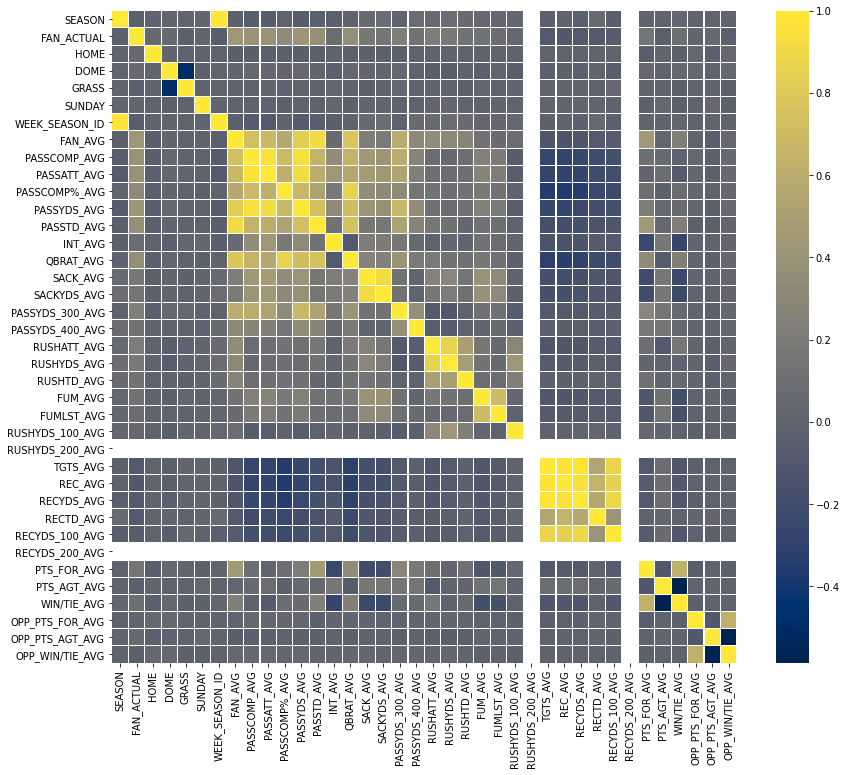

In [171]:
_ = plt.figure(figsize=(14, 12))
_ = sns.heatmap(nfl_qb.corr(), linewidth=.1, cmap='cividis', annot=False)

plt.show()

In [172]:
print('The correlation between Fantasy Points in a week and the 4-week average of the following statistics are: ')
print('')
print('Fantasy Points: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['FAN_AVG'])[0, 1], 2)))
print('Pass Completions: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['PASSCOMP_AVG'])[0, 1], 2)))
print('Pass Attempts: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['PASSATT_AVG'])[0, 1], 2)))
print('Pass Accuracy: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['PASSCOMP%_AVG'])[0, 1], 2)))
print('Pass Yards: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['PASSYDS_AVG'])[0, 1], 2)))
print('Pass TDs: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['PASSTD_AVG'])[0, 1], 2)))
print('QB Rating: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['QBRAT_AVG'])[0, 1], 2)))
print('300 yard Pass Games: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['PASSYDS_300_AVG'])[0, 1], 2)))
print('400 yard Pass Games: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['PASSYDS_400_AVG'])[0, 1], 2)))
print('Rushing Att: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['RUSHATT_AVG'])[0, 1], 2)))
print('Rushing Yards: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['RUSHYDS_AVG'])[0, 1], 2)))
print('Rushing TDs: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['RUSHTD_AVG'])[0, 1], 2)))
print('Points Scored: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['PTS_FOR_AVG'])[0, 1], 2)))
print('Win/Tie Rate: ' + str(round(np.corrcoef(nfl_qb['FAN_ACTUAL'], nfl_qb['WIN/TIE_AVG'])[0, 1], 2)))

The correlation between Fantasy Points in a week and the 4-week average of the following statistics are: 

Fantasy Points: 0.43
Pass Completions: 0.4
Pass Attempts: 0.39
Pass Accuracy: 0.32
Pass Yards: 0.42
Pass TDs: 0.37
QB Rating: 0.36
300 yard Pass Games: 0.23
400 yard Pass Games: 0.12
Rushing Att: 0.21
Rushing Yards: 0.18
Rushing TDs: 0.12
Points Scored: 0.14
Win/Tie Rate: 0.1


#### RB Analysis

This analysis of correlation specific to RB shows that the 4-week rolling average for Rushing Att and Rushing Yds have a similar correlation to 'FAN_ACTUAL' as 4-week rolling average of Fantasy Points. This seems to indicate those two indicators may be the better predictors of RB fantasy performance (along with previous fantasy performance) when continuing our analysis.

In [173]:
nfl_rb = nfl_rolling[nfl_rolling['POS']=='RB']

In [174]:
nfl_rb.shape

(6634, 46)

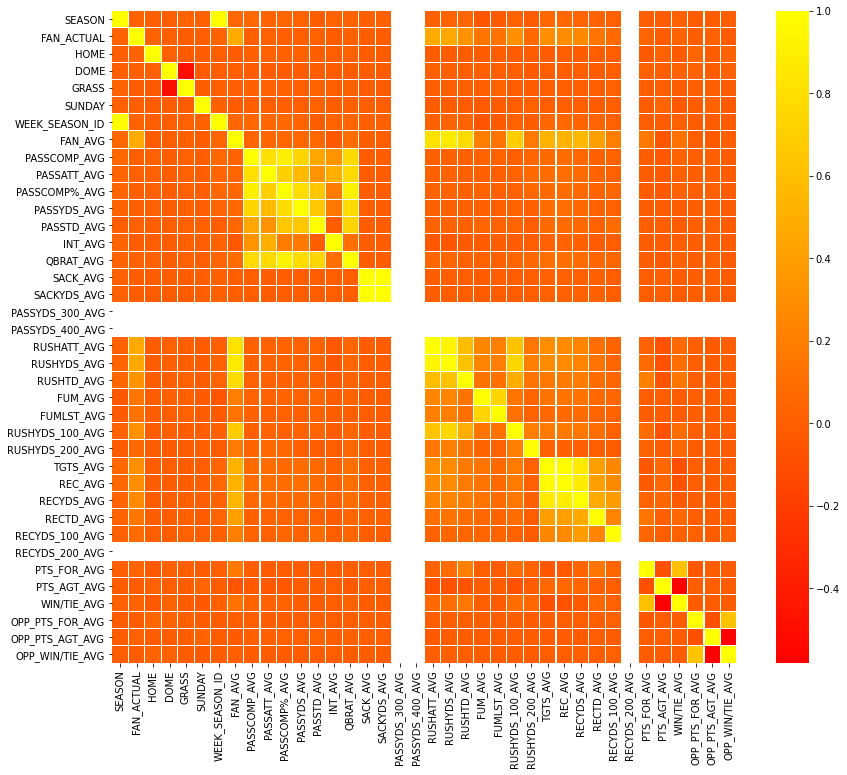

In [175]:
_ = plt.figure(figsize=(14, 12))
_ = sns.heatmap(nfl_rb.corr(), linewidth=.1, cmap='autumn', annot=False)

plt.show()

In [176]:
print('The correlation between Fantasy Points in a week and the 4-week average of the following statistics are: ')
print('')
print('Fantasy Points: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['FAN_AVG'])[0, 1], 2)))
print('Rushing Att: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['RUSHATT_AVG'])[0, 1], 2)))
print('Rushing Yds: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['RUSHYDS_AVG'])[0, 1], 2)))
print('Rushing TD: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['RUSHTD_AVG'])[0, 1], 2)))
print('Targets: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['TGTS_AVG'])[0, 1], 2)))
print('Rec: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['REC_AVG'])[0, 1], 2)))
print('Rec Yds: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['RECYDS_AVG'])[0, 1], 2)))
print('Rec TD: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['RECTD_AVG'])[0, 1], 2)))
print('100 yard Rush Games: ' + str(round(np.corrcoef(nfl_rb['FAN_ACTUAL'], nfl_rb['RUSHYDS_100_AVG'])[0, 1], 2)))

The correlation between Fantasy Points in a week and the 4-week average of the following statistics are: 

Fantasy Points: 0.48
Rushing Att: 0.47
Rushing Yds: 0.47
Rushing TD: 0.33
Targets: 0.3
Rec: 0.29
Rec Yds: 0.27
Rec TD: 0.15
100 yard Rush Games: 0.31


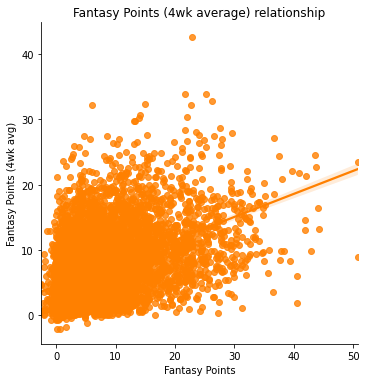

In [177]:
_ = sns.lmplot(data=nfl_rb, x='FAN_ACTUAL', y='FAN_AVG', hue='POS', palette='autumn', legend=False)
_ = plt.xlabel('Fantasy Points')
_ = plt.ylabel('Fantasy Points (4wk avg)')
_ = plt.title('Fantasy Points (4wk average) relationship')
plt.show()

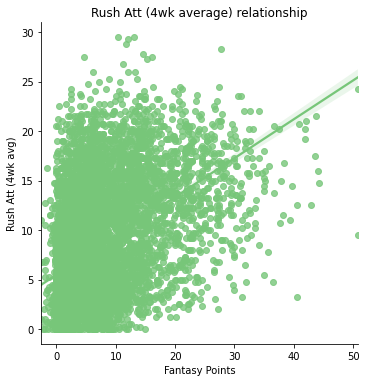

In [178]:
_ = sns.lmplot(data=nfl_rb, x='FAN_ACTUAL', y='RUSHATT_AVG', hue='POS', palette='YlGn', legend=False)
_ = plt.xlabel('Fantasy Points')
_ = plt.ylabel('Rush Att (4wk avg)')
_ = plt.title('Rush Att (4wk average) relationship')
plt.show()

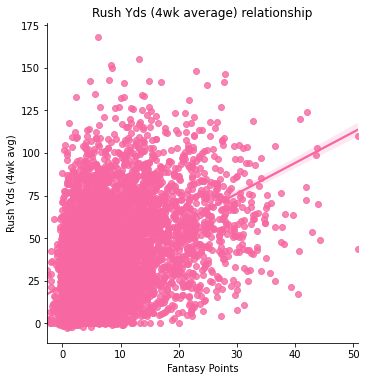

In [179]:
_ = sns.lmplot(data=nfl_rb, x='FAN_ACTUAL', y='RUSHYDS_AVG', hue='POS', palette='RdPu', legend=False)
_ = plt.xlabel('Fantasy Points')
_ = plt.ylabel('Rush Yds (4wk avg)')
_ = plt.title('Rush Yds (4wk average) relationship')
plt.show()

#### WR Analysis

This analysis of correlation specific to WR shows that the 4-week rolling average for Targets, Receptions and Receiving Yds have a higher correlation to 'FAN_ACTUAL' than 4-week rolling average of Fantasy Points. This seems to indicate those three indicators may be the better predictors of WR fantasy performance when continuing our analysis, as well as previous fantasy performance.

In [180]:
nfl_wr = nfl_rolling[nfl_rolling['POS']=='WR']

In [181]:
nfl_wr.shape

(8763, 46)

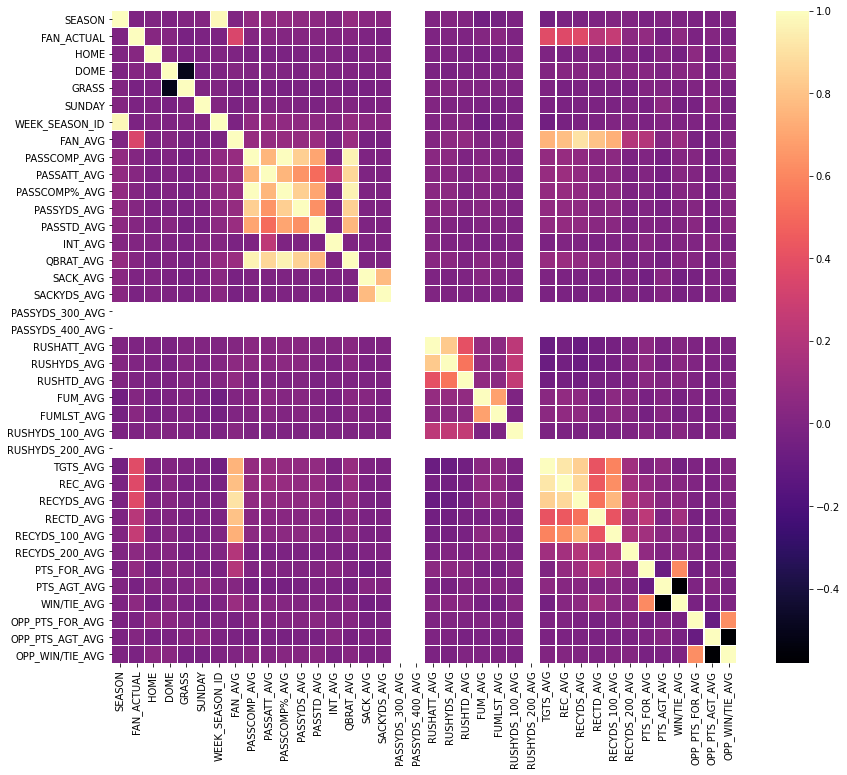

In [182]:
_ = plt.figure(figsize=(14, 12))
_ = sns.heatmap(nfl_wr.corr(), linewidth=.1, cmap='magma', annot=False)

plt.show()

In [183]:
print('The correlation between Fantasy Points in a week and the 4-week average of the following statistics are: ')
print('')
print('Fantasy Points: ' + str(round(np.corrcoef(nfl_wr['FAN_ACTUAL'], nfl_wr['FAN_AVG'])[0, 1], 2)))
print('Targets: ' + str(round(np.corrcoef(nfl_wr['FAN_ACTUAL'], nfl_wr['TGTS_AVG'])[0, 1], 2)))
print('Rec: ' + str(round(np.corrcoef(nfl_wr['FAN_ACTUAL'], nfl_wr['REC_AVG'])[0, 1], 2)))
print('Rec Yds: ' + str(round(np.corrcoef(nfl_wr['FAN_ACTUAL'], nfl_wr['RECYDS_AVG'])[0, 1], 2)))
print('Rec TD: ' + str(round(np.corrcoef(nfl_wr['FAN_ACTUAL'], nfl_wr['RECTD_AVG'])[0, 1], 2)))
print('100 yard Rec Games: ' + str(round(np.corrcoef(nfl_wr['FAN_ACTUAL'], nfl_wr['RECYDS_100_AVG'])[0, 1], 2)))

The correlation between Fantasy Points in a week and the 4-week average of the following statistics are: 

Fantasy Points: 0.35
Targets: 0.38
Rec: 0.37
Rec Yds: 0.37
Rec TD: 0.22
100 yard Rec Games: 0.26


#### TE Analysis

Similar to what was found with WRs, this analysis of correlation specific to TE shows that the 4-week rolling average for Targets, Receptions and Receiving Yds have a higher correlation to 'FAN_ACTUAL' than 4-week rolling average of Fantasy Points. This seems to indicate those three indicators may be the better predictors of TE fantasy performance when continuing our analysis, as well as previous fantasy performance.

In [184]:
nfl_te = nfl_rolling[nfl_rolling['POS']=='TE']

In [185]:
nfl_te.shape

(4135, 46)

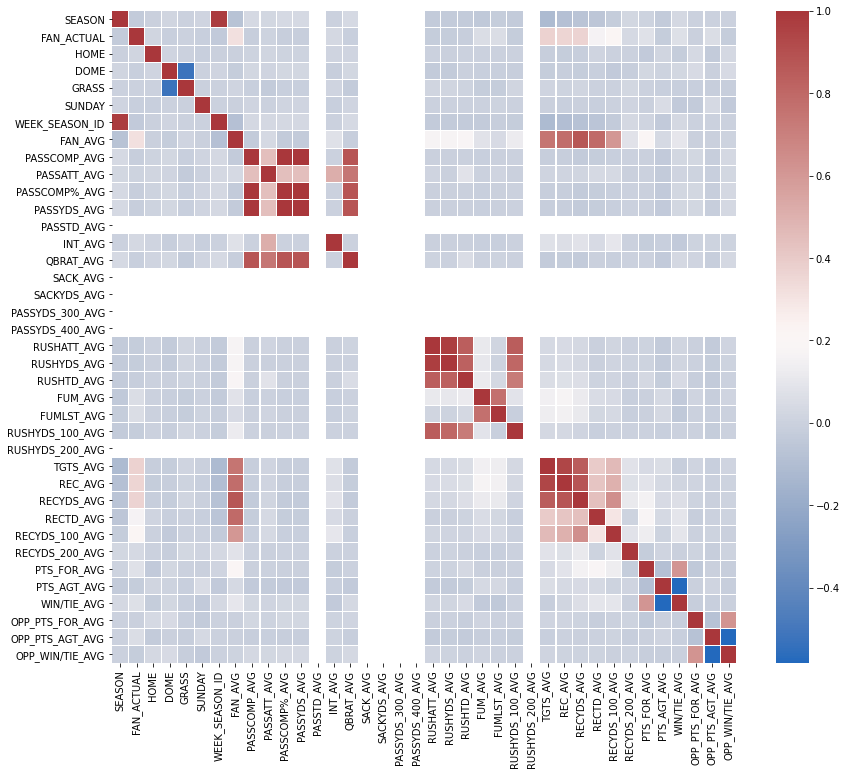

In [186]:
_ = plt.figure(figsize=(14, 12))
_ = sns.heatmap(nfl_te.corr(), linewidth=.1, cmap='vlag', annot=False)

plt.show()

In [187]:
print('The correlation between Fantasy Points in a week and the 4-week average of the following statistics are: ')
print('')
print('Fantasy Points: ' + str(round(np.corrcoef(nfl_te['FAN_ACTUAL'], nfl_te['FAN_AVG'])[0, 1], 2)))
print('Targets: ' + str(round(np.corrcoef(nfl_te['FAN_ACTUAL'], nfl_te['TGTS_AVG'])[0, 1], 2)))
print('Rec: ' + str(round(np.corrcoef(nfl_te['FAN_ACTUAL'], nfl_te['REC_AVG'])[0, 1], 2)))
print('Rec Yds: ' + str(round(np.corrcoef(nfl_te['FAN_ACTUAL'], nfl_te['RECYDS_AVG'])[0, 1], 2)))
print('Rec TD: ' + str(round(np.corrcoef(nfl_te['FAN_ACTUAL'], nfl_te['RECTD_AVG'])[0, 1], 2)))
print('100 yard Rec Games: ' + str(round(np.corrcoef(nfl_te['FAN_ACTUAL'], nfl_te['RECYDS_100_AVG'])[0, 1], 2)))

The correlation between Fantasy Points in a week and the 4-week average of the following statistics are: 

Fantasy Points: 0.32
Targets: 0.37
Rec: 0.36
Rec Yds: 0.37
Rec TD: 0.16
100 yard Rec Games: 0.22


### Hypothesis testing on Pearson coefficient

As shown in the last section, 'FAN_ACTUAL' and 'FAN_AVG' have a positive correlation of 0.56

In [188]:
def pearson_r(x, y):
    """Compute Pearson correlation coefficient between two arrays."""
    # Compute correlation matrix: corr_mat
    corr_mat = np.corrcoef(x, y)

    # Return entry [0,1]
    return corr_mat[0,1]

In [189]:
r_obs = pearson_r(nfl_rolling['FAN_ACTUAL'], nfl_rolling['FAN_AVG'])
print(r_obs)

0.5577320701206946


#### Hypothesis

However, this observed correlation may just be by chance and a player's average fantasy performance over the previous 4-weeks may be completely independent of their performance that week. To see if this is the case or not, I will need to test the null hypothesis that these values are independent of each other.

__H0:__ Fantasy Performance in a given week ('FAN_ACTUAL') is independent and uncorrelated with a player's average performance over the prior 4 weeks ('FAN_AVG').

__H1:__ Fantasy Performance in a given week ('FAN_ACTUAL') is correlated with a player's average performance over the prior 4 weeks ('FAN_AVG').

For significance level, we will look for it at a 5% level.

#### Permutation Test

Since the data of Fantasy Points is not normally distributed, it is best to use a *non-parametric* test here. This is simply a label for statistical tests used when the data aren't normally distributed. These tests are extraordinarily powerful due to how few assumptions we need to make.  

To do this, I will permute the 'FAN_AVG' values and leave the 'FAN_ACTUAL' fixed. For each permutation, I will calculate the correlation coefficient and assess how many of the permutation replicates have a Pearson correlation greater than the observed one.

In [190]:
perm_replicates = np.empty(10000)

# Draw replicates
for i in range(10000):
    FAN_AVG_permuted = np.random.permutation(nfl_rolling['FAN_AVG'])

    # Compute Pearson correlation
    perm_replicates[i] = pearson_r(nfl_rolling['FAN_ACTUAL'], FAN_AVG_permuted)

# Compute p-value: p
p = np.sum(perm_replicates >= r_obs) / len(perm_replicates)
print('p-val =', p)

p-val = 0.0


P-value of 0.0 shows that in the 10,000 permutations ran, none of them generated a correlation coefficient higher than the one obtained in the actual dataset. 

Because of this low value, we can reject the Null Hypothesis that Fantasy Performance in a given week ('FAN_ACTUAL') is independent and uncorrelated with a player's average performance over the prior 4 weeks ('FAN_AVG').

## Clustering

The last piece I'd like to look at before completing this EDA is find out if there are any relationships in the data which we don't know about yet. We currently group players by position but is there a better way to do this for fantasy performance?

With this in mind, we look to apply a cluster algorithm to see if we kind find a new set of groupings that could help us understand our data better.

### Prep Data

We will need to tidy and prep our data before it is ready be used for clustering.

We will be using the nfl_actual dataset that we split out earlier. The aim of this clustering is to see if there is a better way to cluster & understand each player's weekly performance rather than looking group a player's previous performance which would've been the case if we used the nfl_rolling dataset. Using this would be an option for additional analysis if required.

**1.  Remove columns**

nfl_actual still contains a lot data not necessary for this clustering so we will remove this.

In [191]:
nfl_actual.head()
nfl_actual.shape

(23517, 103)

In [192]:
avg_4wk_list = ['PASSCOMP_4WK_AVG', 'PASSATT_4WK_AVG', 'PASSCOMP%_4WK_AVG', 'PASSYDS_4WK_AVG', 'PASSTD_4WK_AVG', 'INT_4WK_AVG', 'QBRAT_4WK_AVG', 'SACK_4WK_AVG', 'SACKYDS_4WK_AVG', 'RUSHATT_4WK_AVG', 'RUSHYDS_4WK_AVG', 'RUSHTD_4WK_AVG', 'TGTS_4WK_AVG', 'REC_4WK_AVG', 'RECYDS_4WK_AVG', 'RECTD_4WK_AVG', 'FUM_4WK_AVG', 'FUMLST_4WK_AVG', 'PASSYDS_300_4WK_AVG', 'PASSYDS_400_4WK_AVG', 'RUSHYDS_100_4WK_AVG', 'RUSHYDS_200_4WK_AVG', 'RECYDS_100_4WK_AVG', 'RECYDS_200_4WK_AVG', 'FAN_4WK_AVG']

nfl_actual = nfl_actual.drop(avg_4wk_list, axis=1)

In [193]:
#nfl_actual.head()
#nfl_actual.shape

In [194]:
catvar_list = ['H/A', 'HC', 'OC', 'DC', 'OPP HC', 'OPP OC', 'OPP DC', 'DAY', 'W/L', 'ROOF', 'SURFACE']

nfl_actual = nfl_actual.drop(catvar_list, axis=1)

In [195]:
#nfl_actual.head()
#nfl_actual.shape
#nfl_actual.columns

In [196]:
avg_4wk_shift_list = ['PASSCOMP_4WK_AVG_SHIFT', 'PASSATT_4WK_AVG_SHIFT', 'PASSCOMP%_4WK_AVG_SHIFT', 'PASSYDS_4WK_AVG_SHIFT', 'PASSTD_4WK_AVG_SHIFT', 'INT_4WK_AVG_SHIFT', 'QBRAT_4WK_AVG_SHIFT', 'SACK_4WK_AVG_SHIFT', 'SACKYDS_4WK_AVG_SHIFT', 'RUSHATT_4WK_AVG_SHIFT', 'RUSHYDS_4WK_AVG_SHIFT', 'RUSHTD_4WK_AVG_SHIFT', 'TGTS_4WK_AVG_SHIFT', 'REC_4WK_AVG_SHIFT', 'RECYDS_4WK_AVG_SHIFT', 'RECTD_4WK_AVG_SHIFT', 'FUM_4WK_AVG_SHIFT', 'FUMLST_4WK_AVG_SHIFT', 'PASSYDS_300_4WK_AVG_SHIFT', 'PASSYDS_400_4WK_AVG_SHIFT', 'RUSHYDS_100_4WK_AVG_SHIFT', 'RUSHYDS_200_4WK_AVG_SHIFT', 'RECYDS_100_4WK_AVG_SHIFT', 'RECYDS_200_4WK_AVG_SHIFT', 'FAN_4WK_AVG_SHIFT']

nfl_actual = nfl_actual.drop(avg_4wk_shift_list, axis=1)

In [197]:
#nfl_actual.head()
#nfl_actual.shape
#nfl_actual.columns

In [198]:
non_player_stat_list = ['DATE', 'SEASON', 'WEEK', 'MONTH', 'TIME', 'WEEK_SEASON_ID', 'SUNDAY', 'HOME', 'DOME', 'GRASS', 'WIN/TIE', 'PTS_FOR', 'PTS_AGT', 'TEAM', 'OPP', 'PLAYER_NAME', 'POS']

In [199]:
X = nfl_actual.drop(non_player_stat_list, axis=1)

In [200]:
#X.head()
#X.shape

In [201]:
milestone_yard_list = ['PASSYDS_300', 'PASSYDS_400', 'RUSHYDS_100', 'RUSHYDS_200', 'RECYDS_100', 'RECYDS_200']

In [202]:
X = X.drop(milestone_yard_list, axis=1)

In [203]:
X.head()
X.shape

(23517, 19)

**2.  Turn data into numpy array**

For the kMeans clustering algorithm we are going to use, the data is required to be in a Numpy array. This is transformed in code below.

In [204]:
X.to_numpy()

array([[ 0. ,  0. ,  0. , ...,  0. ,  0. ,  2.4],
       [ 0. ,  0. ,  0. , ...,  0. ,  0. ,  1.6],
       [ 0. ,  0. ,  0. , ...,  1. ,  0. , 12. ],
       ...,
       [ 0. ,  0. ,  0. , ...,  0. ,  0. , 12.6],
       [ 0. ,  0. ,  0. , ...,  0. ,  0. ,  4.9],
       [ 0. ,  0. ,  0. , ...,  0. ,  0. , 13.5]])

### The Model

For this clustering model, we are going to use **KMeans algorithm** from sklearn.

There are a variety of different clustering models that can be used on your data - this includes Mean Shift or Heirarchical clustering that could be incorporated depending on your data and how the approach best fits it. However, to limit analysis at this point in time, we will only do a KMeans for this EDA.

Below shows how we will run the KMeans from sklearn. This includes creating a pipeline that will first scale our data using sklearn's StandardScaler method followed by applying the KMeans clustering algorithm. This is initiall set to three clusters but as we will look to find the optimal k in the sections below this.

In [205]:
# Set up Sclaer and Cluster Model
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

scaler = StandardScaler()
model = KMeans(n_clusters=3)


# Make Pipeline
from sklearn.pipeline import make_pipeline

pipeline = make_pipeline(scaler, model)


# Fit Model
pipeline.fit(X)


# Predict Labels
labels = pipeline.predict(X)

### Find the best k

As mentioned above, we randomly selected the number of clusters for the initial algorithm. However, to find the best number of clusters for our dataset, we will need review the performance each number of clusters to decide on the best one. 

In the upcoming sub-sections, we will:


*   Use the Elbow and Silhouette Methods to identify the optimal number of clusters
*   Use PCA visualisation to see if this can show the clusters to use and whether they make sense
*   Investigate the cluster vs our existing datase to see how well it explains are main focus which is fantasy performance



#### Elbow Method

First, we will look at the Elbow Method to see what number of clusters is recommended with this method. 

The Elbow method looks at the sum-of-squares error in each cluster against K and compute the distance from each data point to the center of the cluster (centroid) to which the data point was assigned. I will run the model for a range of ks varying from 2 to 10 to see if we can identify the optimal k for this k-means cluster - this means finding the k that increasing it does not model the data much better (this is considered the elbow).

Applying this method below suggest that the **optimal k is 4**. When we look at the count in each cluster, a larger majority of data seems to sit in the first cluster (0).

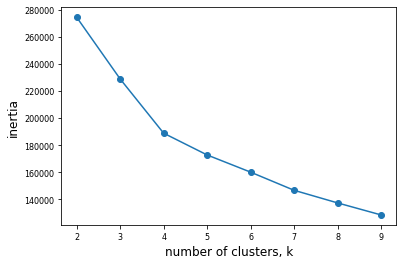

In [206]:
ks = range(2, 10)
inertias = []

for k in ks:
    scaler = StandardScaler()
    model = KMeans(n_clusters=k)
    pipeline = make_pipeline(scaler, model)
    pipeline.fit(X)
    inertias.append(model.inertia_)
    
# Plot ks vs inertias
plt.plot(ks, inertias, '-o')
plt.xlabel('number of clusters, k', fontsize=12)
plt.ylabel('inertia', fontsize=12)
plt.xticks(ks, fontsize=8)
plt.yticks(fontsize=8)
plt.show()

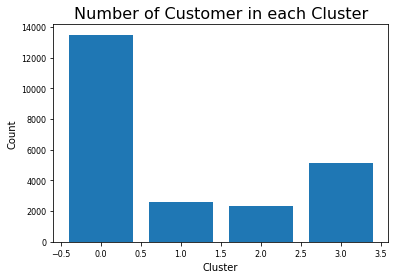

In [207]:
scaler = StandardScaler()
model = KMeans(n_clusters=4)
pipeline = make_pipeline(scaler, model)

pipeline.fit(X)

labels = pipeline.predict(X)


unique, frequency = np.unique(labels, return_counts = True) 

#print(unique)
#print(frequency)

plt.bar(unique, frequency)
plt.xlabel('Cluster', fontsize=10)
plt.ylabel('Count', fontsize=10)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.title('Number of Customer in each Cluster', fontsize=16)

plt.show()

#### Silhouette Method

The Silhouette method is an alternative way to measure cluster performance that it measures how well each datapoint "fits" its assigned cluster and also how poorly it fits into other clusters. This is a different way of looking at the same objective. The silhouette score is computed on every datapoint in every cluster. The silhouette score ranges from -1 (a poor clustering) to +1 (a very dense clustering) with 0 denoting the situation where clusters overlap.

Applying this to our data shows that **k=2 is the highest scoring number of clusters** at 0.79, with k=4 further behind at 0.46 but still the best of the rest of k's analysed.

For n_clusters = 2 The average silhouette_score is : 0.7909068580267085
For n_clusters = 3 The average silhouette_score is : 0.41829756697953846
For n_clusters = 4 The average silhouette_score is : 0.461573036596382
For n_clusters = 5 The average silhouette_score is : 0.40281633405024564
For n_clusters = 6 The average silhouette_score is : 0.3308695506441477
For n_clusters = 7 The average silhouette_score is : 0.26632502214568365
For n_clusters = 8 The average silhouette_score is : 0.24787852904184618
For n_clusters = 9 The average silhouette_score is : 0.2344732192971195
For n_clusters = 10 The average silhouette_score is : 0.17565096368521563


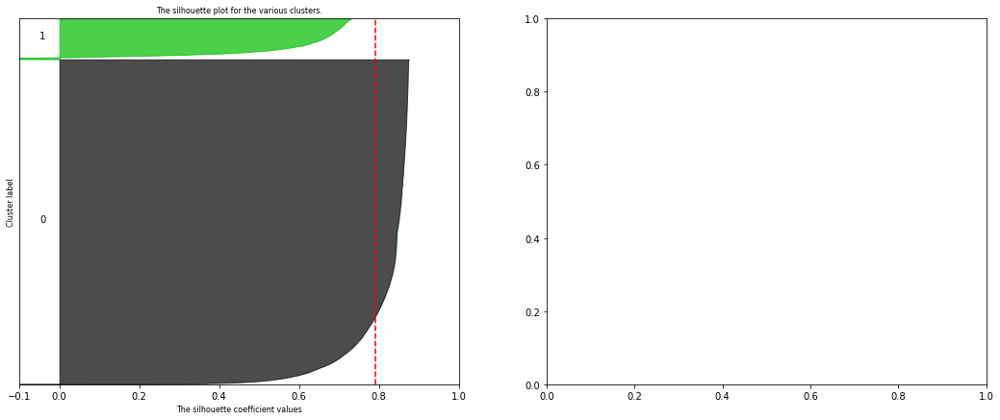

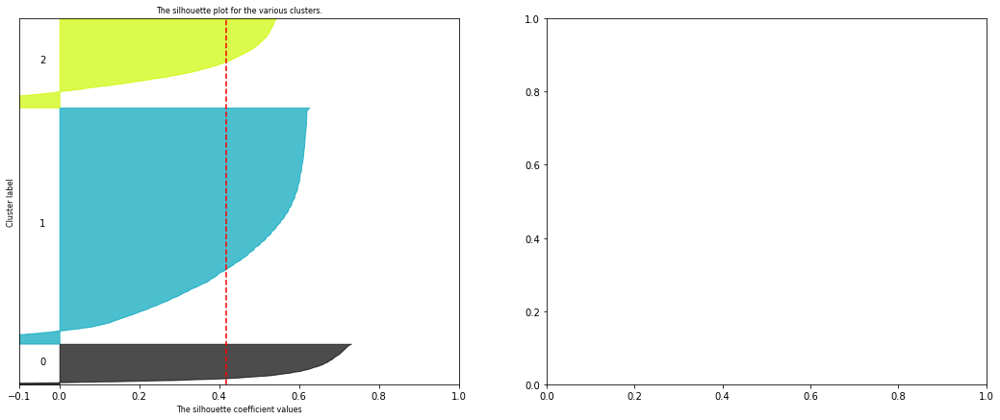

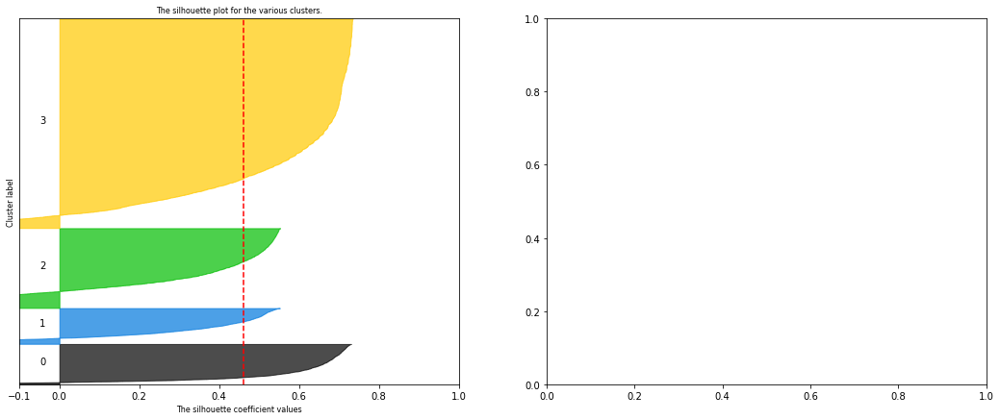

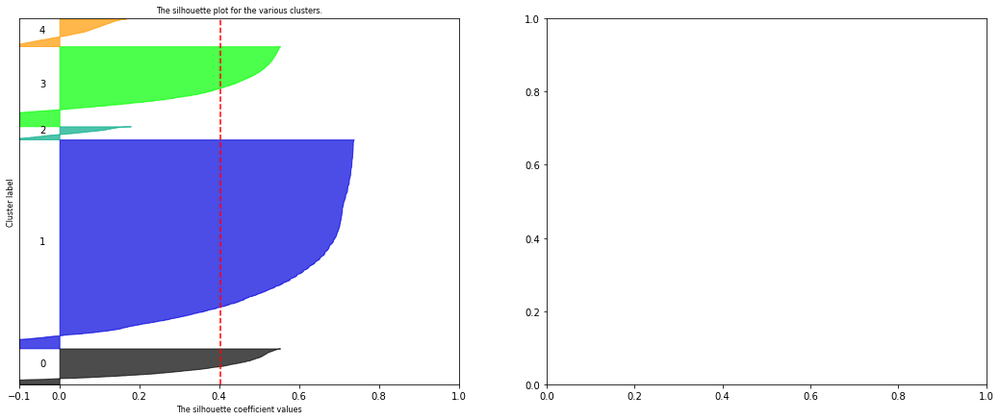

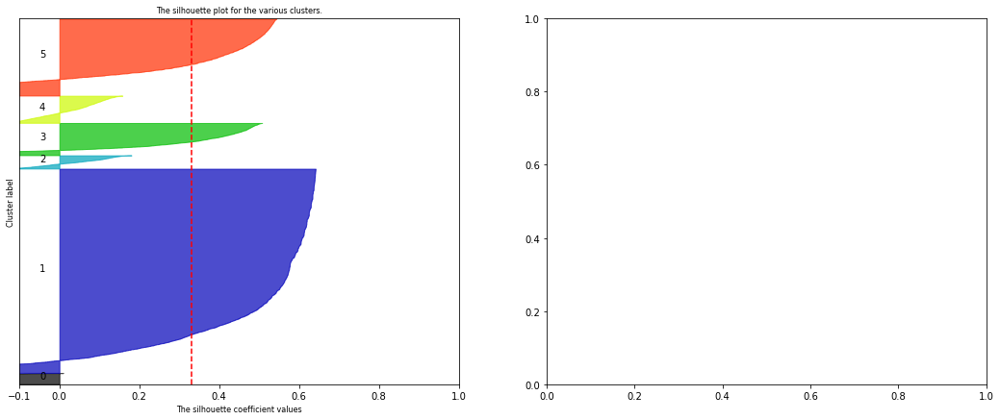

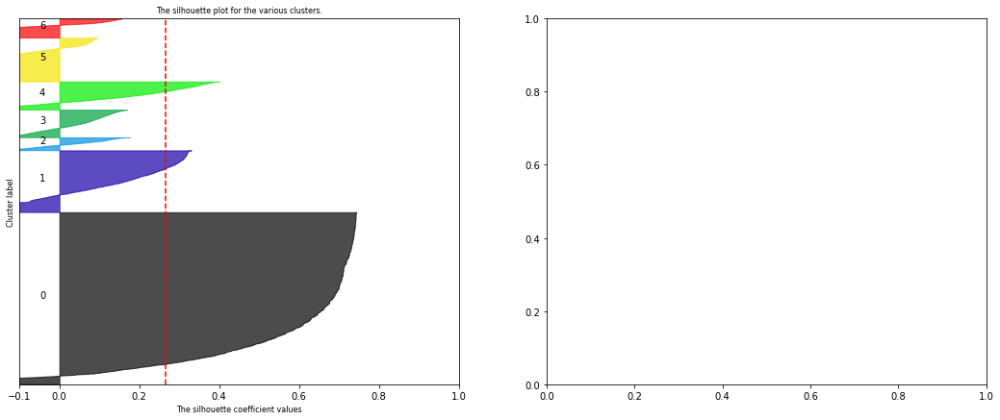

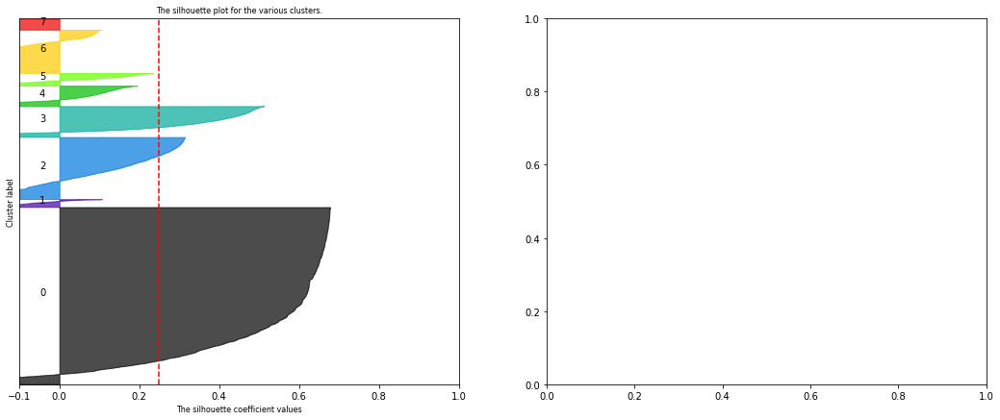

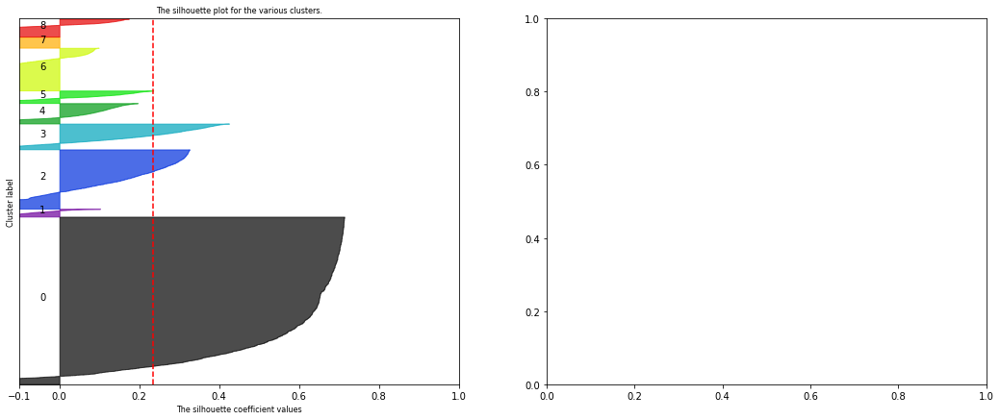

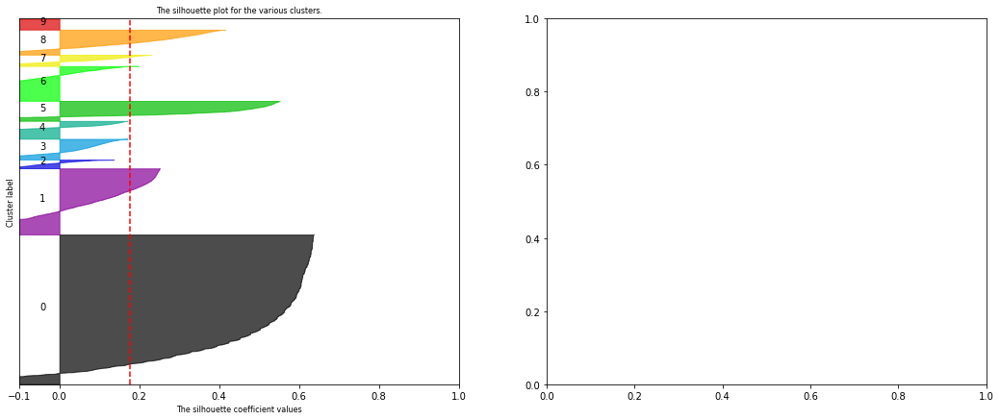

In [208]:
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    scaler = StandardScaler()
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    pipeline = make_pipeline(scaler, clusterer)
    cluster_labels = pipeline.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.", fontsize=8)
    ax1.set_xlabel("The silhouette coefficient values", fontsize=8)
    ax1.set_ylabel("Cluster label", fontsize=8)

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

'''

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')



    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.", fontsize=8)
    ax2.set_xlabel("Feature space for the 1st feature", fontsize=8)
    ax2.set_ylabel("Feature space for the 2nd feature", fontsize=8)

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=8, fontweight='bold')
'''

plt.show()

### PCA Visualisation

The above methods show that either 2 or 4 clusters seems to be the ideal number for our dataset. However, to get a better understanding of what these clusters look like, it would be good to visualise them. This can be done using a PCA to reduce the dimensions of our dataset into our 2 dimension which we can then display in a scatter plot. This is being done now purely for visualisation purposes but PCA could potentially be useful later on in our analysis if we find that we have too many features and / or they are highly correlated.

**1.  Generate a labels for k=2 and k=4**

Earlier we identified the optimal number of clusters is likely 2 or 4. With this in mind, we will run these two algorithms again and produce cluster labels that we will eventually add back into our nfl_actual dataset.

In [209]:
#nfl_actual.head()

In [210]:
scaler = StandardScaler()
model = KMeans(n_clusters=2)
pipeline = make_pipeline(scaler, model)

pipeline.fit(X)
labels_k2 = pipeline.predict(X)


model = KMeans(n_clusters=4)
pipeline = make_pipeline(scaler, model)
pipeline.fit(X)
labels_k4 = pipeline.predict(X)

**2.  Run PCA model**

Run the PCA model from sklearn on your X data for it to identify the most important features in your dataset. 

It is important to note that the features developed from PCA do not directly translate to the columns in your dataset - rather, PCA untangles the correlations between these columns and then creates new features based on how much of the variance each feature explains (all of which are orthogonal / not correlated). Following this feature transformation, you could then decide on the number of these features you would want to include in your analysis. For the case of this visualisation this is only 2 features (needed for a scatter plot) but we could include more if we were to use this technique in a different modelling situation.

In [211]:
from sklearn.decomposition import PCA
model = PCA(n_components=2)
model.fit(X)
X_transformed = model.transform(X)

print(X_transformed.shape)

(23517, 2)


**3.  Add clusters and PCA features to your dataset**

Add the label prediction arrays from your KMeans (2) and KMeans (4) models, along with your two PCA features your original nfl_actul dataset (and rename if you wish to keep the original version entact).

In [212]:
nfl_actual_clusters = nfl_actual
#nfl_actual_clusters.head()

In [213]:
nfl_actual_clusters['cluster_2'] = labels_k2
nfl_actual_clusters['cluster_4'] = labels_k4
nfl_actual_clusters['PCA_1'] = X_transformed[:,0]
nfl_actual_clusters['PCA_2'] = X_transformed[:,1]

#nfl_actual_clusters.head()

**4.  Visualise the Clusters**

Plot your PCA features and clusters onto a scatter plot to visualise how the data has been seperated.

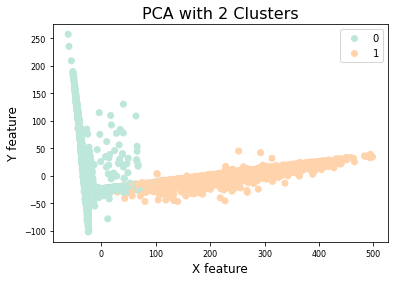

In [214]:
scatter = plt.scatter(nfl_actual_clusters['PCA_1'], nfl_actual_clusters['PCA_2'], c=nfl_actual_clusters['cluster_2'], cmap='icefire')
_ = plt.xlabel('X feature', fontsize=12)
_ = plt.ylabel('Y feature', fontsize=12)
_ = plt.xticks(fontsize=8)
_ = plt.yticks(fontsize=8)
_ = plt.title('PCA with 2 Clusters', fontsize=16)

# Make Legend
leg_labels = np.unique(nfl_actual_clusters['cluster_2'])
leg_handles = [plt.Line2D([],[],marker="o", ls="", color=scatter.cmap(scatter.norm(yi))) for yi in leg_labels]
_ = plt.legend(leg_handles, leg_labels)

plt.show()

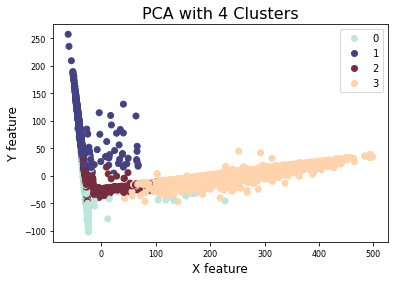

In [215]:
scatter = plt.scatter(nfl_actual_clusters['PCA_1'], nfl_actual_clusters['PCA_2'], c=nfl_actual_clusters['cluster_4'], cmap='icefire')
_ = plt.xlabel('X feature', fontsize=12)
_ = plt.ylabel('Y feature', fontsize=12)
_ = plt.xticks(fontsize=8)
_ = plt.yticks(fontsize=8)
_ = plt.title('PCA with 4 Clusters', fontsize=16)

# Make Legend
leg_labels = np.unique(nfl_actual_clusters['cluster_4'])
leg_handles = [plt.Line2D([],[],marker="o", ls="", color=scatter.cmap(scatter.norm(yi))) for yi in leg_labels]
_ = plt.legend(leg_handles, leg_labels)

plt.show()

### Compare by Features

Using PCA above, we were able to visualise the clusters and see how they were broken into the groupings. However, because we used PCA features instead of columns in our dataset, we still don't have a clear understanding of each of these clusters contain.

Below we investigate both cluster models to get a better understanding of them using our original dataset. 

#### 4-Cluster Model

In the code below, we look at a number of different charts to look at how fantasy points and overall counts vary by cluster and position. Doing this, gives us a bit of insight into what each cluster represents. 

**Cluster 0**
* Highest scoring cluster
* Consists only of QBs
* Low count
* Highest in all Passing statistics

**Cluster 1**
* Lowest scoring cluster (by large margin)
* Consists of all positions
* Significantly the highest count
* Low across all statistics

**Cluster 2**
* Second highest scoring
* Consists predominately of RBs
* Low count
* Highest in all Rushing statistics

**Cluster 3**
* Third highest scoring
* Consists mainly of WRs, TEs and few RBs (no QBs)
* Second highest count
* Highest in all Receiving statistics


This is very interesting in that is seperates out players who do not perform well into a seperate cluster and then seperates the remaining players into groups depending on whether they tend to accumulate Passing, Rushing or Receiving statistics.

In [216]:
#nfl_actual_clusters.head()

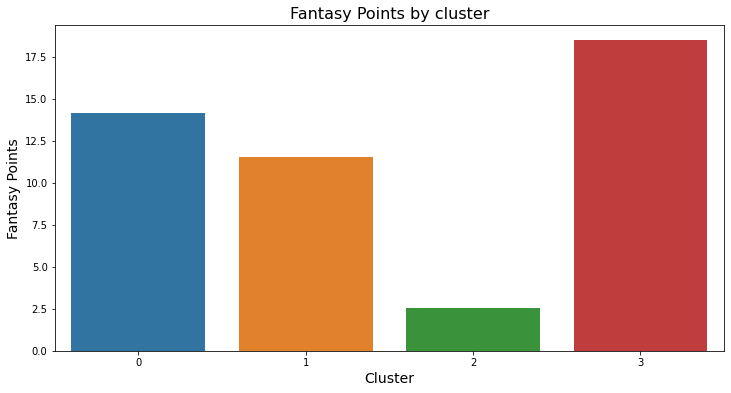

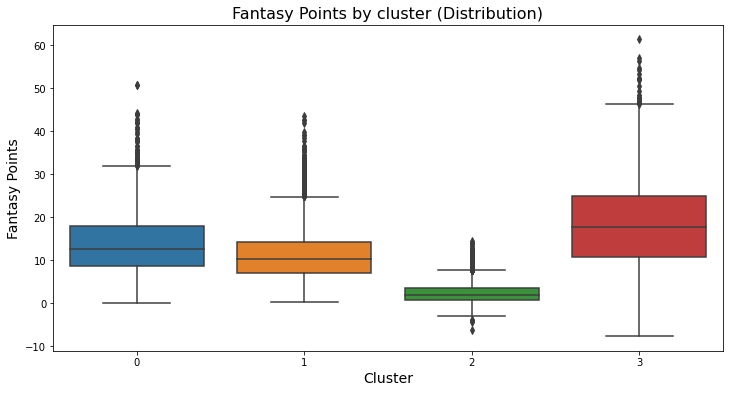

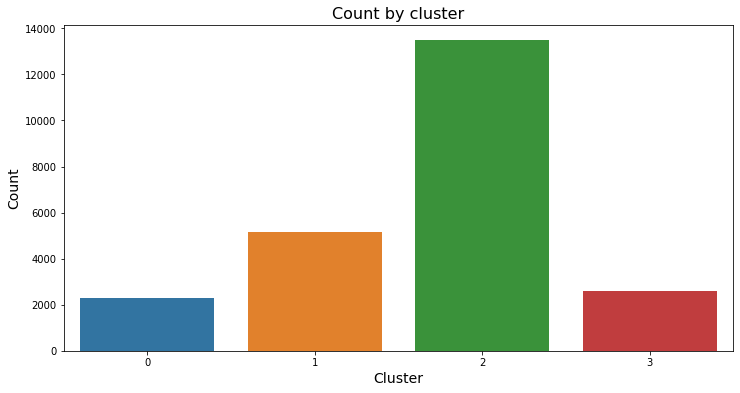

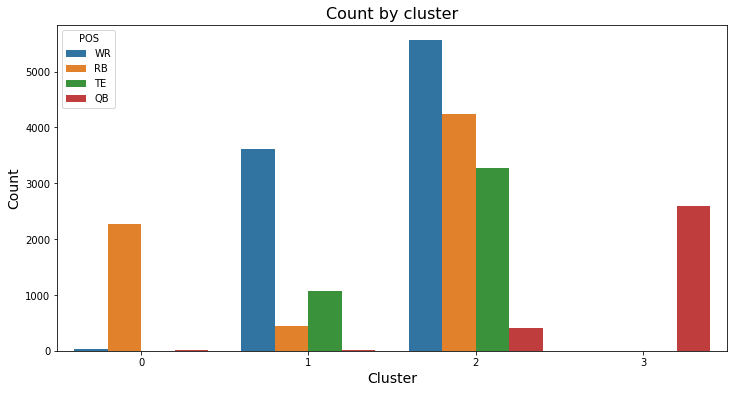

In [217]:
import seaborn as sns

# Fantasy Points Bar Plot by Cluster
_ = plt.figure(figsize=(12, 6))
_ = sns.barplot(x='cluster_4', y='FAN_TOT', data=nfl_actual_clusters, ci=None)
_ = plt.title('Fantasy Points by cluster', fontsize=16)
_ = plt.xlabel('Cluster',fontsize=14)
_ = plt.ylabel('Fantasy Points',fontsize=14)
_ = plt.xticks(fontsize=10)
_ = plt.yticks(fontsize=10)
#_ = plt.legend(fontsize=10)
_ = plt.grid(False)

plt.show()


# Fantasy Points Box Plot by Cluster
_ = plt.figure(figsize=(12, 6))
_ = sns.boxplot(x="cluster_4", y="FAN_TOT", data=nfl_actual_clusters)
_ = plt.title('Fantasy Points by cluster (Distribution)', fontsize=16)
_ = plt.xlabel('Cluster',fontsize=14)
_ = plt.ylabel('Fantasy Points',fontsize=14)
_ = plt.xticks(fontsize=10)
_ = plt.yticks(fontsize=10)
#_ = plt.legend(fontsize=10)
_ = plt.grid(False)

plt.show()


# Count Plot by Cluster
_ = plt.figure(figsize=(12, 6))
_ = sns.countplot(x='cluster_4', data=nfl_actual_clusters)
_ = plt.title('Count by cluster', fontsize=16)
_ = plt.xlabel('Cluster',fontsize=14)
_ = plt.ylabel('Count',fontsize=14)
_ = plt.xticks(fontsize=10)
_ = plt.yticks(fontsize=10)
#_ = plt.legend(fontsize=10)
_ = plt.grid(False)

plt.show()


# Count Plot by Cluster & Position
_ = plt.figure(figsize=(12, 6))
_ = sns.countplot(x='cluster_4', data=nfl_actual_clusters, hue='POS')
_ = plt.title('Count by cluster', fontsize=16)
_ = plt.xlabel('Cluster',fontsize=14)
_ = plt.ylabel('Count',fontsize=14)
_ = plt.xticks(fontsize=10)
_ = plt.yticks(fontsize=10)
#_ = plt.legend(fontsize=10)
_ = plt.grid(False)

plt.show()

In [218]:
pd.crosstab(nfl_actual_clusters['cluster_4'], nfl_actual_clusters['POS'])

POS,QB,RB,TE,WR
cluster_4,,,,
0,10,2266,0,27
1,13,447,1073,3609
2,408,4239,3279,5561
3,2584,1,0,0


In [219]:
nfl_actual_clusters.groupby('cluster_4')[['FAN_TOT', 'PASSATT', 'PASSYDS', 'PASSTD', 'RUSHATT', 'RUSHYDS', 'RUSHTD', 'RECYDS', 'RECTD', 'TGTS']].mean().round(1)

,FAN_TOT,PASSATT,PASSYDS,PASSTD,RUSHATT,RUSHYDS,RUSHTD,RECYDS,RECTD,TGTS
cluster_4,,,,,,,,,,
0,14.2,0.1,0.6,0.0,16.0,74.0,0.7,19.3,0.1,3.0
1,11.5,0.0,0.2,0.0,0.7,2.8,0.0,73.3,0.6,8.2
2,2.5,0.1,0.6,0.0,1.4,4.8,0.0,16.6,0.1,2.6
3,18.5,33.9,245.5,1.5,3.0,13.0,0.1,0.1,0.0,0.0


In [220]:
nfl_actual_clusters.loc[(nfl_actual_clusters['cluster_4']==0) & (nfl_actual_clusters['POS']=='RB')]
#nfl_actual_clusters.loc[(nfl_actual_clusters['cluster_4']==2) & (nfl_actual_clusters['POS']=='QB')]
#nfl_actual_clusters.loc[(nfl_actual_clusters['cluster_4']==2) & (nfl_actual_clusters['POS']=='WR')]
#nfl_actual_clusters.loc[(nfl_actual_clusters['cluster_4']==3) & (nfl_actual_clusters['POS']=='QB')]
#nfl_actual_clusters.loc[(nfl_actual_clusters['cluster_4']==3) & (nfl_actual_clusters['POS']=='RB')]

,TEAM,OPP,DATE,SEASON,WEEK,MONTH,TIME,PASSCOMP,PASSATT,PASSCOMP%,PASSYDS,PASSTD,INT,QBRAT,SACK,SACKYDS,RUSHATT,RUSHYDS,RUSHTD,TGTS,REC,RECYDS,RECTD,FUM,FUMLST,POS,PLAYER_NAME,PTS_FOR,PTS_AGT,PASSYDS_300,PASSYDS_400,RUSHYDS_100,RUSHYDS_200,RECYDS_100,RECYDS_200,FAN_TOT,HOME,DOME,GRASS,WIN/TIE,SUNDAY,WEEK_SEASON_ID,cluster_2,cluster_4,PCA_1,PCA_2
18651,Patriots,Steelers,2015-09-10,2015,Week01,September,Night,0,0,0.0,0,0,0,0.0,0,0,15,69,0,5,4,51,0,1,0,RB,Dion Lewis,28,21,0,0,0,0,0,0,12.0,1,0,0,1,0,0,0,0,-32.084009,-0.377283
18638,Steelers,Patriots,2015-09-10,2015,Week01,September,Night,0,0,0.0,0,0,0,0.0,0,0,21,127,0,1,1,5,0,0,0,RB,DeAngelo Williams,21,28,0,0,2,0,0,0,15.2,0,0,0,0,0,0,0,0,-26.024742,-62.569580
18660,Packers,Bears,2015-09-13,2015,Week01,September,Noon,0,0,0.0,0,0,0,0.0,0,0,19,85,1,3,2,14,0,0,0,RB,Eddie Lacy,31,23,0,0,0,0,0,0,15.9,0,0,1,1,1,0,0,0,-27.312095,-40.033401
18682,Chiefs,Texans,2015-09-13,2015,Week01,September,Noon,0,0,0.0,0,0,0,0.0,0,0,16,57,0,8,5,46,1,1,0,RB,Jamaal Charles,27,20,0,0,0,0,0,0,16.3,0,1,0,1,1,0,0,0,-31.382465,-0.429586
18696,Bengals,Raiders,2015-09-13,2015,Week01,September,Afternoon,0,0,0.0,0,0,0,0.0,0,0,19,63,2,0,0,0,0,0,0,RB,Jeremy Hill,33,13,0,0,0,0,0,0,18.3,0,0,1,1,1,0,0,0,-25.547037,-45.862188
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19041,Colts,Jaguars,2019-12-29,2019,Week17,December,Afternoon,0,0,0.0,0,0,0,0.0,0,0,15,77,2,0,0,0,0,0,0,RB,Marlon Mack,20,38,0,0,0,0,0,0,19.7,0,0,1,0,1,84,0,0,-25.417405,-50.051540
19032,Saints,Panthers,2019-12-29,2019,Week17,December,Noon,0,0,0.0,0,0,0,0.0,0,0,17,61,0,1,1,14,0,0,0,RB,Latavius Murray,42,10,0,0,0,0,0,0,7.5,0,0,1,1,1,84,0,0,-27.798346,-33.026722
19033,Jets,Bills,2019-12-29,2019,Week17,December,Noon,0,0,0.0,0,0,0,0.0,0,0,16,41,0,5,5,36,0,0,0,RB,Le'Veon Bell,13,6,0,0,0,0,0,0,7.7,0,0,0,1,1,84,0,0,-30.631239,-5.493327
19036,Rams,Cardinals,2019-12-29,2019,Week17,December,Afternoon,0,0,0.0,0,0,0,0.0,0,0,9,26,1,1,1,6,0,0,0,RB,Malcolm Brown,31,24,0,0,0,0,0,0,9.2,1,0,1,1,1,84,0,0,-26.924708,-28.218347


#### 2-cluster Model

We look again at the same charts and tables but this time for our 2-cluster model. This shows us

**Cluster 0**
* Higher scoring cluster
* Consists of QBs (only 2 RBs assigned)
* Low count
* Highest in all Passing statistics

**Cluster 1**
* Lower scoring cluster (by large margin)
* Consists of all positions
* Significantly higher count
* Receiving statistics are highest but rushing similar to Cluster 0 - very low Passing statistics

There is less digestable information from this cluster group. It again correctly groups players with higher passing statistics but unlike the previous cluster group, it does provide much information in the other group. It mainly seperates out data into Passers and non-Passers.

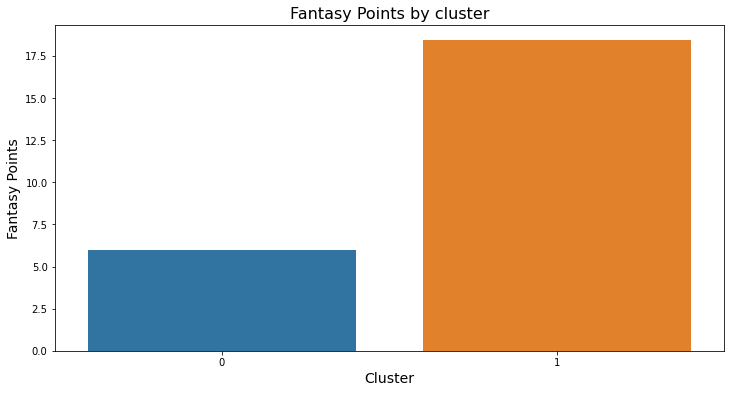

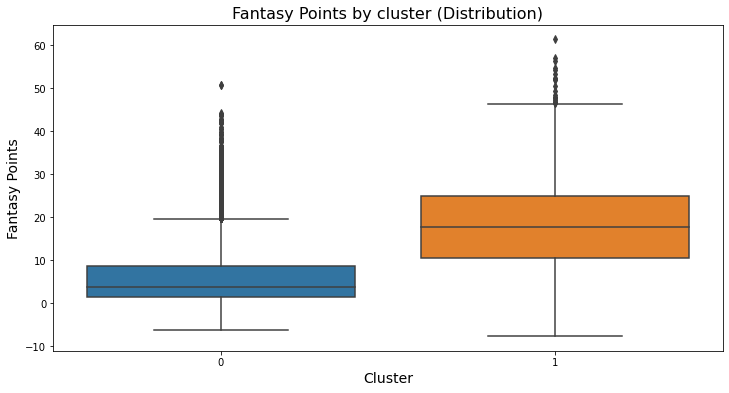

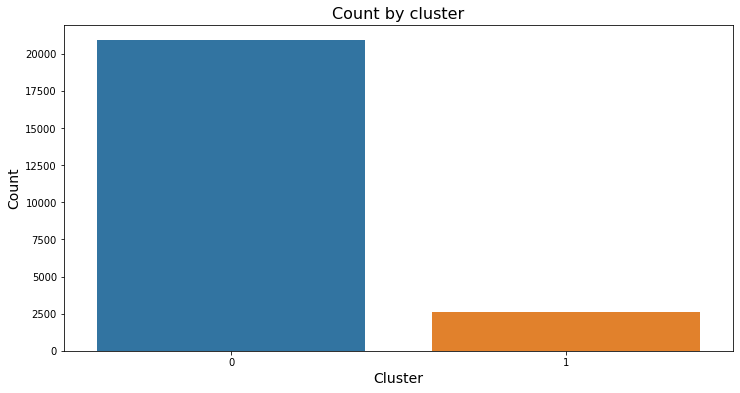

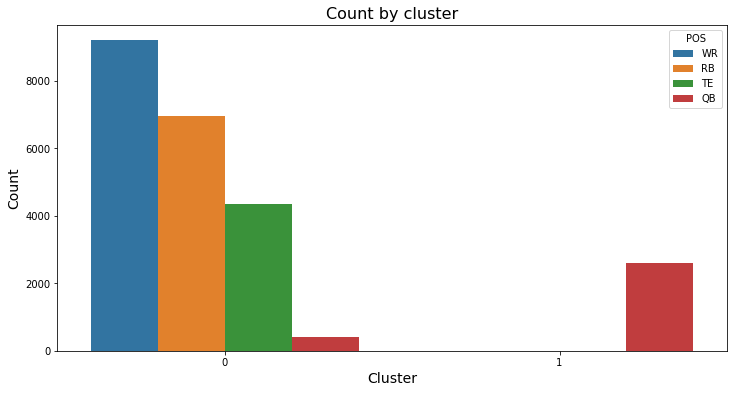

In [221]:
# Fantasy Points Bar Plot by Cluster
_ = plt.figure(figsize=(12, 6))
_ = sns.barplot(x='cluster_2', y='FAN_TOT', data=nfl_actual_clusters, ci=None)
_ = plt.title('Fantasy Points by cluster', fontsize=16)
_ = plt.xlabel('Cluster',fontsize=14)
_ = plt.ylabel('Fantasy Points',fontsize=14)
_ = plt.xticks(fontsize=10)
_ = plt.yticks(fontsize=10)
#_ = plt.legend(fontsize=10)
_ = plt.grid(False)

plt.show()


# Fantasy Points Box Plot by Cluster
_ = plt.figure(figsize=(12, 6))
_ = sns.boxplot(x="cluster_2", y="FAN_TOT", data=nfl_actual_clusters)
_ = plt.title('Fantasy Points by cluster (Distribution)', fontsize=16)
_ = plt.xlabel('Cluster',fontsize=14)
_ = plt.ylabel('Fantasy Points',fontsize=14)
_ = plt.xticks(fontsize=10)
_ = plt.yticks(fontsize=10)
#_ = plt.legend(fontsize=10)
_ = plt.grid(False)

plt.show()


# Count Plot by Cluster
_ = plt.figure(figsize=(12, 6))
_ = sns.countplot(x='cluster_2', data=nfl_actual_clusters)
_ = plt.title('Count by cluster', fontsize=16)
_ = plt.xlabel('Cluster',fontsize=14)
_ = plt.ylabel('Count',fontsize=14)
_ = plt.xticks(fontsize=10)
_ = plt.yticks(fontsize=10)
#_ = plt.legend(fontsize=10)
_ = plt.grid(False)

plt.show()


# Count Plot by Cluster & Position
_ = plt.figure(figsize=(12, 6))
_ = sns.countplot(x='cluster_2', data=nfl_actual_clusters, hue='POS')
_ = plt.title('Count by cluster', fontsize=16)
_ = plt.xlabel('Cluster',fontsize=14)
_ = plt.ylabel('Count',fontsize=14)
_ = plt.xticks(fontsize=10)
_ = plt.yticks(fontsize=10)
#_ = plt.legend(fontsize=10)
_ = plt.grid(False)

plt.show()

In [222]:
pd.crosstab(nfl_actual_clusters['cluster_2'], nfl_actual_clusters['POS'])

POS,QB,RB,TE,WR
cluster_2,,,,
0,411,6951,4352,9197
1,2604,2,0,0


In [223]:
nfl_actual_clusters.groupby('cluster_2')[['FAN_TOT', 'PASSATT', 'PASSYDS', 'PASSTD', 'RUSHATT', 'RUSHYDS', 'RUSHTD', 'RECYDS', 'RECTD', 'TGTS']].mean().round(1)

,FAN_TOT,PASSATT,PASSYDS,PASSTD,RUSHATT,RUSHYDS,RUSHTD,RECYDS,RECTD,TGTS
cluster_2,,,,,,,,,,
0,6.0,0.1,0.4,0.0,2.8,11.9,0.1,30.8,0.2,4.0
1,18.4,33.8,244.4,1.5,3.1,13.3,0.1,0.1,0.0,0.0


In [224]:
#nfl_actual_clusters.loc[(nfl_actual_clusters['cluster_2']==0) & (nfl_actual_clusters['POS']=='RB')]

### Conclusion

After going through the various steps, testing and analysis of the KMeans clustering algorithm, the model that performs the best and looks to provide the most useful information is the k=4 model. It provides us with information on which player rows are not performing before splitting the rest of the rows into clusters focusing on whether the performance relates mainly to passing, rushing or receiving. Most crucially for this analysis is that these three groups also have high fantasy point scoring averages that could be useful for future modelling in allowing to us to look at predicting which cluster a player is likely to fall into rather than a precise score.

These four clusters could be described as:

0.   High scoring - Passing
1.   Low scoring
2.   High scoring - Rushing
3.   High scoring - Receiving 


Based on all of the above, I will look to merge the data from 'cluster_4' column into our nfl_rolling dataset that we will then export and use for our model going forward.

In [225]:
#nfl_actual_clusters.head()
#nfl_rolling.head()

In [226]:
nfl_actual_clusters.rename(columns={'PLAYER_NAME': 'PLAYER'}, inplace=True)

In [227]:
#nfl_actual_clusters.head()

In [228]:
merge_data = nfl_actual_clusters[['TEAM', 'OPP', 'DATE', 'WEEK_SEASON_ID', 'PLAYER', 'cluster_4']]

nfl_rolling = pd.merge(nfl_rolling, merge_data, how='left', on=['TEAM', 'OPP', 'DATE', 'WEEK_SEASON_ID', 'PLAYER'])

In [229]:
#nfl_rolling.head()

## Conclusion

The analysis has indicated a couple of interesting insights without being overally conclusive. Analysis so far has shown that:
* __Distribution:__ The distribution is not normally distributed and looks to have a right-tail that creates a large volume of lower values that may be impacting the ability to understand the true relationships in the dataset. This will need to be investigated further and accounted for in any model developed.
* __Position:__ Fantasy performance differs by position and the distribution of QBs seems to be slightly different to that of other positions. This need to analysed further and included in any modelling.  
* __Time & Date:__ There is some time-based element to the data but the extent and impact of this is not clear at the moment. There seems to be a trend downward in fantasy performance as the season progress when we looked at this by Month and Week. However, on the other side, there seems to be a slight increase in fantasy performance since the 2017 season. Further analysis would be needed to confirm whether this is statisically relevant or not. 
* __Rolling Averages :__ Rolling averages were created to measure the 4-week rolling average of metrics prior to that weeks game. The aim of this was to make these variables independent and allow fantasy managers use information that is available to them before kick-off of their fantasy matchup. Two seperate techniques were used for Player Statisics and Game Statistics, and the decision was made at this point that Points For, Points Against, and Win/Tie rate could be used as proxy for Team and Coaching variables discussed earlier in the dataset. Two points that could be altered in future analysis are: 
    * Chainging 4-week rolling average to different period. This number selected arbitrarily as a good starting point, however this could be updated in further analysis to other week ranges to see what the best number of weeks is to create this average for.
    * It was assumed that until a player had 4 weeks worth of data that we assume a smaller week average (i.e. 2 week average) until the 4 weeks was attained. This may be skewing the analysis with higher averages. This approach was decided on to reduce the number of null values in the dataset but if dataset reached a point where it was large enough, then this could be altered.
    * NaN values were removed from dataset meaning a drop in 1,107 rows. In future analysis, alternative number could be imputed based on estimate using the data. However, this was currently seen as out of scope for this project.
* __Correlations__: The strongest correlation with Fantasy Points (once rolling averages replaced actuals) was the previous 4-week average fantasy points. However, when this was broken down by position type it was found that:
    * The previous 4-week average Pass Completions and Passing Yards are slightly smaller correlation with with Fantasy Points as the previous 4-week average fantasy points for QBs.
    * The previous 4-week average Rushing Attempts and Rushing Yards have a similar correlation with Fantasy Points as the previous 4-week average fantasy points for RBs.
    * The previous 4-week average Targets, Recpetions and Receiving Yards have a higher correlation with Fantasy Points than the previous 4-week average fantasy points for WRs and TEs
* __Hypothesis Test__: This showed that the relationship between the 4-week rolling average fantasy points and actual Fantasy Points is significant as Permutation Test generate a p-value of 0. 
* __Cluster Analysis__: This showed that a player's performance could be broken into four groupings that helps identify which players are high scoring and in which particular aspect of the game they perform well in (i.e. Passing, Rushing, Receiving). This information could be a useful classification going forward when trying to model and predict our data.


 

### Next Steps

The information in the analyis above indicates that using the 4-week rolling average of Fantasy Points could be a good predictor of Fantasy Points. However, any model will likely need to account for the position of a player and other variables such as Rushing Attempts, Rushing Yards, Targets, Receptions and Receiving Yards could also be good predictors depending on the position. 

Further analysis would also need to gain an understanding of the true distribution of the data and whether the rolling averages being used to date (4-weeks) are the best fit for the model or would another week period be more accurate.

## Output Data to CSV

Outputting data from this stage to CSV to allow me to use this data set for future stages of project.

In [230]:
nfl_rolling.to_csv('NFL_FantasyData_2015_2019_EDA_v3.csv')